<img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTaJWG7PzF3toxaRMB1-JicpqMgJuEXATd0fg&" style="width: 150px;margin-top:30px;" align ="center">

<div style= "font-size: 40px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center>ABCDEats Inc.</center></div> <br>
<div style= "font-size: 40px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center>Part 2 | Preprocessing and Clustering</center></div> <br>

<div style= "font-size: 27px;font-weight:bold;line-height: 1.1; margin-top:40px; font-family: 'Avenir Next LT Pro', sans-serif;"><center>Data Mining Project 2024/2025</center></div> <br>

   <div style= "font-size: 20px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center> Group 17:</center></div>
   <div><center> André Sousa | 20240517 </center></div>
   <div><center> Isabella Costa | 20240685 </center></div>
   <div><center> Jéssica Cristas | 20240488 </center></div>
   <div><center> Tiago Castilho | 20240489 </center></div>

______

______

# Index

  * [1. Preprocessing ](#Preprocessing)
    * [1.1 Duplicates](#dupes)
    * [1.2 Feature Enginnering](#engineering)
      * [1.2.1 Creating Total Orders](#total_orders)
      * [1.2.2 Creating Week Orders and Weekend Orders](#week_orders)
      * [1.2.3 Creating Total Spending](#total_spending)
      * [1.2.4 Creating Average Spending](#average_spending)
      * [1.2.5 Creating Days between Orders](#days_bt_orders)
      * [1.2.6 Creating CUI Count](#cui_count)
      * [1.2.7 Creating Mealtime Hours](#mealtime)
    * [1.3 Checking Missing Values and Encoding](#encoding)
      * [1.3.1 Dealing with Last Promo](#last_promo)
      * [1.3.2 Checking Customer Region](#region)
      * [1.3.3 Dealing with Payment Method](#payment)
    * [1.4 Measures of Central Tendency](#measures)
      * [1.4.1 Customer Age Missing Values](#miss_age)
      * [1.4.2 First Order Missing Values](#miss_first)
      * [1.4.3 Customer Region Missing Values](#miss_region)
  * [2. Outliers Removal](#outliers)
  * [3. Scaling Data](#scaling)
  * [4. Feature Selection](#feature)
    * [4.1 Correlation Matrix](#cor_matrix)
  * [5. Clustering](#clusting)
    * [5.1 Perspective 1:** Loyalty and Retention](#p1)
      * [5.1.1 Selecting K](#selecting_k_p1)
      * [5.1.2 ANOVA](#anova_p1)
      * [5.1.3 Applying K-Means](#kmeans_p1)
      * [5.1.4 Cluster Analysis](#analysis_p1)
    * [5.2 Perspective 2: Customer Behavior](#p2)
      * [5.2.1 Selecting K](#selecting_k_p2)
      * [5.2.2 ANOVA](#anova_p2)
      * [5.2.3 Applying K-Means](#kmeans_p2)
      * [5.2.4 Cluster Analysis](#analysis_p2)
    * [5.3 Perspective 2: Customer Preference](#p3)
      * [5.3.1 Selecting K](#selecting_k_p3)
      * [5.3.2 ANOVA](#anova_p3)
      * [5.3.3 Applying K-Means](#kmeans_p3)
      * [5.3.4 Cluster Analysis](#analysis_p3)
    * [5.4 Merging Perspectives](#merging)
      * [5.4.1 Applying Hierarchical Clustering](#hc_cluster)
    * [5.5 Predicting Outliers](#pred_outliers)
    * [5.6 Final Solution](#final_solution)
      * [5.6.1 Cluster Analysis](#analysis_final)




In [105]:
import pandas as pd
import numpy as np
import seaborn as sns
import textwrap
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans
import matplotlib.cm as cm
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import MeanShift, estimate_bandwidth
from os.path import join
from scipy.cluster.hierarchy import dendrogram, linkage
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.base import clone
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from minisom import MiniSom
from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib import colors as mpl_colors
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import pairwise_distances
from matplotlib.lines import Line2D
import seaborn as sns
from matplotlib.ticker import StrMethodFormatter
from matplotlib import __version__ as mplver
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import davies_bouldin_score
import umap.umap_ as umap
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
%config InlineBackend.figure_format = 'retina' 

In [106]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

In [107]:
df = pd.read_csv('../DM2425_ABCDEats_DATASET.csv', index_col='customer_id')

> # Auxiliary Functions

In [108]:
def plot_histogram_with_mean_median(feature_name, df, bins=30):

    # Exclude missing values
    valid_data = df[feature_name].dropna()

    # Calculate mean and median
    mean_value = np.mean(valid_data)
    median_value = np.median(valid_data)

    # Create the plot
    plt.figure(figsize=(10, 6))
    plt.hist(valid_data, bins=bins, color='orange', alpha=0.7, label='Data')
    plt.axvline(mean_value, color='blue', linestyle='--', linewidth=2, label=f'Mean: {mean_value:.2f}')
    plt.axvline(median_value, color='black', linestyle='-', linewidth=2, label=f'Median: {median_value:.2f}')

    # Add title and labels
    plt.title(f'Histogram of {feature_name}', fontsize=14)
    plt.xlabel('Values', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.legend(fontsize=12)
    plt.grid(alpha=0.3)

    # Display the plot
    plt.show()

In [109]:
def plot_categorical_frequency(feature_name, df):

    # Exclude missing values only for the specified feature
    valid_data = df[feature_name].dropna()

    # Calculate frequency counts
    value_counts = valid_data.value_counts()

    # Create the plot
    plt.figure(figsize=(10, 6))
    value_counts.plot(kind='bar', color='orange', alpha=0.7)

    # Add title and labels
    plt.title(f'Frequency of Categories in {feature_name}', fontsize=14)
    plt.xlabel('Categories', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.xticks(rotation=45, fontsize=10)
    plt.grid(alpha=0.3, axis='y')

    # Display the plot
    plt.show()

In [110]:
def sse_plot(df, features, max_clusters=10, n_init=15):

    # Define range of clusters to test
    range_n_clusters = range(1, max_clusters + 1)

    # Sum of squared distances
    sse = []

    # Calculate SSE for each number of clusters
    for n_clusters in range_n_clusters:
        kmclust = KMeans(n_clusters=n_clusters, init='k-means++', n_init=n_init, random_state=42)
        kmclust.fit(df[features])
        sse.append(kmclust.inertia_)

    # Plotting the elbow method
    plt.figure(figsize=(10, 6))
    plt.plot(range_n_clusters, sse, marker='o')
    plt.title("Elbow Method for Optimal Clusters")
    plt.xlabel("Number of Clusters")
    plt.ylabel("Sum of Squared Distances (SSE)")
    plt.xticks(range_n_clusters)
    plt.grid(True)
    plt.show()

In [111]:
def dbs_plot(df, features, max_clusters=10, n_init=15):
    import pandas as pd
    import matplotlib.pyplot as plt
    from sklearn.cluster import KMeans
    from sklearn.metrics import davies_bouldin_score

    # Define range of clusters to test
    range_n_clusters = range(2, max_clusters + 1)  # Davies-Bouldin Score requires at least 2 clusters

    # Davies-Bouldin scores
    db_scores = []

    # Calculate Davies-Bouldin Score for each number of clusters
    for n_clusters in range_n_clusters:
        kmclust = KMeans(n_clusters=n_clusters, init='k-means++', n_init=n_init, random_state=42)
        cluster_labels = kmclust.fit_predict(df[features])
        score = davies_bouldin_score(df[features], cluster_labels)
        db_scores.append(score)

    # Create a DataFrame for the Davies-Bouldin scores
    db_scores_df = pd.DataFrame({
        "Number of Clusters": list(range_n_clusters),
        "Davies-Bouldin Score": db_scores
    })

    # Print the Davies-Bouldin scores as a table
    print("\nDavies-Bouldin Scores:")
    print(db_scores_df)

    # Plotting the Davies-Bouldin scores
    plt.figure(figsize=(10, 6))
    plt.plot(range_n_clusters, db_scores, marker='o')
    plt.title("Davies-Bouldin Scores for Different Cluster Sizes")
    plt.xlabel("Number of Clusters")
    plt.ylabel("Davies-Bouldin Score")
    plt.xticks(range_n_clusters)

    # Annotate each point with the Davies-Bouldin score
    for i, row in db_scores_df.iterrows():
        plt.annotate(f'{row["Davies-Bouldin Score"]:.3f}', 
                     (row["Number of Clusters"], row["Davies-Bouldin Score"]),
                     textcoords="offset points", xytext=(0, 10), ha='center')

    plt.grid(True)
    plt.show()


In [112]:
def silhoutte_plot(df, features, max_clusters=10, n_init=15):
    import pandas as pd
    import matplotlib.pyplot as plt
    from sklearn.cluster import KMeans
    from sklearn.metrics import silhouette_score

    kmeans_set = {"init": "k-means++", "n_init": n_init, "max_iter": 300, "random_state": 42}

    silhouette_coefficients = []

    # Compute silhouette scores for each number of clusters
    for k in range(2, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, **kmeans_set)
        kmeans.fit(df[features])
        score = silhouette_score(df[features], kmeans.labels_)
        silhouette_coefficients.append(score)

    # Create a DataFrame for the silhouette scores
    silhouette_df = pd.DataFrame({
        "Number of Clusters": range(2, max_clusters + 1),
        "Silhouette Coefficient": silhouette_coefficients
    })
    
    # Print the silhouette scores as a table
    print("\nSilhouette Coefficients:")
    print(silhouette_df)

    # Plot the silhouette scores
    plt.style.use("fivethirtyeight")
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(silhouette_df["Number of Clusters"], silhouette_df["Silhouette Coefficient"], marker='o')
    plt.xticks(range(2, max_clusters + 1))
    plt.xlabel("Number of Clusters")
    plt.ylabel("Silhouette Coefficient")
    plt.title("Silhouette Coefficients for Different Cluster Sizes")

    # Annotate each point with the silhouette coefficient
    for i, row in silhouette_df.iterrows():
        ax.annotate(f'{row["Silhouette Coefficient"]:.3f}', 
                    (row["Number of Clusters"], row["Silhouette Coefficient"]),
                    textcoords="offset points", xytext=(0, 10), ha='center')

    plt.grid()
    plt.show()

In [113]:
def apply_kmeans(df, features, k):
   
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=15, random_state=42)
    cluster_labels = kmeans.fit_predict(df[features])
    centroids = kmeans.cluster_centers_
    labels = kmeans.labels_

    return centroids, labels, cluster_labels

In [114]:
def pca_plot(df, features, cluster_labels):
    n_clusters = len(np.unique(cluster_labels))

    # Reduce dimensions to 2 for visualization
    pca = PCA(n_components=2)
    reduced_data = pca.fit_transform(df[features])

    # Create a scatter plot
    plt.figure(figsize=(10, 8))
    for cluster in range(n_clusters + 1):
        cluster_points = reduced_data[cluster_labels == cluster]
        plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f'Cluster {cluster}', alpha=0.6)
    plt.title("Cluster Visualization with PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend()
    plt.show()

In [115]:
def get_ss(df, feats):
    """
    Calculate the sum of squares (SS) for the given DataFrame.

    The sum of squares is computed as the sum of the variances of each column
    multiplied by the number of non-NA/null observations minus one.

    Parameters:
    df (pandas.DataFrame): The input DataFrame for which the sum of squares is to be calculated.
    feats (list of str): A list of feature column names to be used in the calculation.

    Returns:
    float: The sum of squares of the DataFrame.
    """
    df_ = df[feats]
    ss = np.sum(df_.var() * (df_.count() - 1))
    
    return ss 


def get_ssb(df, feats, label_col):
    """
    Calculate the between-group sum of squares (SSB) for the given DataFrame.
    The between-group sum of squares is computed as the sum of the squared differences
    between the mean of each group and the overall mean, weighted by the number of observations
    in each group.

    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the data.
    feats (list of str): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column in the DataFrame that contains the group labels.
    
    Returns
    float: The between-group sum of squares of the DataFrame.
    """
    
    ssb_i = 0
    for i in np.unique(df[label_col]):
        df_ = df.loc[:, feats]
        X_ = df_.values
        X_k = df_.loc[df[label_col] == i].values
        
        ssb_i += (X_k.shape[0] * (np.square(X_k.mean(axis=0) - X_.mean(axis=0))) )

    ssb = np.sum(ssb_i)
    

    return ssb


def get_ssw(df, feats, label_col):
    """
    Calculate the sum of squared within-cluster distances (SSW) for a given DataFrame.

    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the data.
    feats (list of str): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing cluster labels.

    Returns:
    float: The sum of squared within-cluster distances (SSW).
    """
    feats_label = feats+[label_col]

    df_k = df[feats_label].groupby(by=label_col).apply(lambda col: get_ss(col, feats), 
                                                       include_groups=False)

    return df_k.sum()

In [116]:
def get_rsq(df, feats, label_col):
    """
    Calculate the R-squared value for a given DataFrame and features.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing the data.
    feats (list): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing the labels or cluster assignments.

    Returns:
    float: The R-squared value, representing the proportion of variance explained by the clustering.
    """

    df_sst_ = get_ss(df, feats)                 # get total sum of squares
    df_ssw_ = get_ssw(df, feats, label_col)     # get ss within
    df_ssb_ = df_sst_ - df_ssw_                 # get ss between

    # r2 = ssb/sst 
    return (df_ssb_/df_sst_)
    

In [117]:
def get_r2_scores(df, feats, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        df_concat = pd.concat([df, 
                               pd.Series(labels, name='labels', index=df.index)], axis=1)  

        r2_clust[n] = get_rsq(df_concat, feats, 'labels' )
    return r2_clust

In [118]:
def plot_r2_scores(df, features, n_init=15):
    import pandas as pd
    import matplotlib.pyplot as plt
    from sklearn.cluster import KMeans

    # Filter numeric columns
    numeric_df = df[features].select_dtypes(include=[float, int])
    
    # Initialize KMeans
    kmeans = KMeans(init='k-means++', n_init=n_init, random_state=42)
    
    # Compute R² scores
    kmeans_scores = get_r2_scores(numeric_df, features, kmeans)
    
    # Convert scores to a DataFrame for plotting
    r2_scores_df = pd.DataFrame.from_dict(kmeans_scores, orient='index', columns=['R²'])
    r2_scores_df.index.name = 'Number of Clusters'
    
    # Print the exact R² scores as a table
    print("\nExact R² Scores:")
    print(r2_scores_df)
    
    # Plot results
    ax = r2_scores_df.plot(marker='o', figsize=(10, 6))
    plt.title("R-squared Scores for Different Cluster Sizes")
    plt.xlabel("Number of Clusters")
    plt.ylabel("R-squared Score")
    plt.grid()

    # Annotate each point with its R² score
    for i, value in enumerate(r2_scores_df['R²']):
        ax.annotate(f'{value:.3f}', (r2_scores_df.index[i], value), textcoords="offset points", xytext=(0,10), ha='center')

    plt.show()

In [119]:

def cluster_profiles(df, label_columns, figsize, 
                     cmap="tab10",
                     compare_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """

    if compare_titles is None:
        compare_titles = [""] * len(label_columns)

    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=1, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)

    for ax, label, titl in zip(axes[:, 0], label_columns, compare_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i != label]
        dfax = df.drop(drop_cols, axis=1)

        # Getting the cluster centroids
        centroids = dfax.groupby(by=label, as_index=False).mean()

        # Setting Data
        pd.plotting.parallel_coordinates(centroids, 
                                         label, 
                                         color=sns.color_palette(cmap),
                                         ax=ax)

        # Setting Layout
        handles, _ = ax.get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax.annotate(text=titl, xy=(0.95, 1.1), xycoords='axes fraction', fontsize=13, fontweight='heavy') 
        ax.axhline(color="black", linestyle="--")
        ax.set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax.set_xticklabels(ax.get_xticklabels(), 
                           rotation=40,
                           ha='right')

        ax.legend(handles, cluster_labels,
                  loc='center left', bbox_to_anchor=(1, 0.5), title=label)  # Adaptable to number of clusters

    plt.suptitle("Cluster Feature Profiling", fontsize=23)
    plt.show()


In [120]:
def plot_cluster_cardinality(df, label_columns, figsize, cmap="tab10"):

    unique_clusters = df[label_columns].nunique().max()
    palette = sns.color_palette(cmap, n_colors=unique_clusters)  


    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=1, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)

    for ax, label in zip(axes[:, 0], label_columns):
        # Calculating cluster counts
        counts = df.groupby(by=label, as_index=False).size()
        counts.columns = [label, "counts"]

        # Plotting
        sns.barplot(
            x=label,
            y="counts",
            data=counts,
            ax=ax,
            palette=palette,
            hue=label,
            legend=False
        )

        # Layout settings
        ax.set_title(f"Cluster Cardinality - {label}", fontsize=13)
        ax.set_ylabel("Count")
        ax.set_xlabel("Cluster")
        ax.set_xticks(range(len(counts[label].unique())))  # Set correct ticks
        ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # Rotate labels


    plt.suptitle("Cluster Cardinality Profiles", fontsize=23)
    plt.show()


In [121]:
from scipy.stats import f_oneway

def perform_anova_clusters(df, features, n_clusters):
    """
    Perform KMeans clustering with 3 clusters and run ANOVA for each feature.
    
    Parameters:
    - df: DataFrame containing the data.
    - features: List of features for clustering and ANOVA analysis.
    
    Returns:
    - anova_results: DataFrame with F-statistic and p-value for each feature.
    """
    # Step 1: KMeans Clustering
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=15, random_state=42)
    df['Cluster'] = kmeans.fit_predict(df[features])
    
    # Step 2: ANOVA for each feature
    anova_results = []
    for feature in features:
        # Group data by cluster for the current feature
        clusters = [df[df['Cluster'] == cluster][feature] for cluster in range(n_clusters)]
        
        # Perform ANOVA
        f_stat, p_val = f_oneway(*clusters)
        anova_results.append({'Feature': feature, 'F-Statistic': f_stat, 'P-Value': p_val})
    
    # Convert results to a DataFrame
    anova_results_df = pd.DataFrame(anova_results)
    
    return anova_results_df

In [122]:
def plot_tsne(df, features, label_column, random_state=42, figsize=(15, 10), colormap='tab10'):
   
    # Compute the t-SNE transformation
    two_dim = TSNE(random_state=random_state).fit_transform(df[features])

    # Create a DataFrame for visualization
    tsne_df = pd.DataFrame(two_dim, columns=['Dimension_1', 'Dimension_2'])
    tsne_df['Cluster_Labels'] = df[label_column]

    # Generate the scatter plot
    plt.figure(figsize=figsize)
    scatter = plt.scatter(
        tsne_df['Dimension_1'],
        tsne_df['Dimension_2'],
        c=tsne_df['Cluster_Labels'],
        cmap=colormap,
        alpha=0.7
    )

    # Add legend for clusters
    legend1 = plt.legend(*scatter.legend_elements(), title="Clusters", loc="best")
    plt.gca().add_artist(legend1)

    # Add titles and labels
    plt.title("t-SNE Visualization")
    plt.xlabel("Dimension 1")
    plt.ylabel("Dimension 2")
    
    # Show plot
    plt.show()

In [123]:
def plot_umap_2d(df, features, label_column, random_state=42, figsize=(15, 10), colormap='tab10'):
   
    # Compute the UMAP transformation
    umap_2d = umap.UMAP(n_components=2,).fit_transform(df[features])

    # Create a DataFrame for visualization
    umap_df = pd.DataFrame(umap_2d, columns=['Dimension_1', 'Dimension_2'])
    umap_df['Cluster_Labels'] = df[label_column]

    # Generate the scatter plot
    plt.figure(figsize=figsize)
    scatter = plt.scatter(
        umap_df['Dimension_1'],
        umap_df['Dimension_2'],
        c=umap_df['Cluster_Labels'],
        cmap=colormap,
        alpha=0.7
    )


    # Add titles and labels
    plt.title("2D UMAP Visualization")
    plt.xlabel("Dimension 1")
    plt.ylabel("Dimension 2")
    
    # Show plot
    plt.show()

def plot_umap_3d(df, features, label_column, random_state=42, figsize=(15, 10), colormap='tab10'):
   
    # Compute the UMAP transformation
    umap_3d = umap.UMAP(n_components=3,).fit_transform(df[features])

    # Create a DataFrame for visualization
    umap_df = pd.DataFrame(umap_3d, columns=['Dimension_1', 'Dimension_2', 'Dimension_3'])
    umap_df['Cluster_Labels'] = df[label_column]

    # Generate the 3D scatter plot
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(
        umap_df['Dimension_1'],
        umap_df['Dimension_2'],
        umap_df['Dimension_3'],
        c=umap_df['Cluster_Labels'],
        cmap=colormap,
        alpha=0.7
    )

    # Add legend for clusters
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters", loc="best")
    ax.add_artist(legend1)

    # Add titles and labels
    ax.set_title("3D UMAP Visualization")
    ax.set_xlabel("Dimension 1")
    ax.set_ylabel("Dimension 2")
    ax.set_zlabel("Dimension 3")
    
    # Show plot
    plt.show()

In [124]:
def count_cluster_members(df, label_column):
    
    if label_column not in df.columns:
        raise ValueError(f"The column '{label_column}' does not exist in the DataFrame.")
    
    cluster_counts = df[label_column].value_counts().reset_index()
    cluster_counts.columns = ['Cluster', 'Member_Count']
    return cluster_counts.sort_values(by='Cluster').reset_index(drop=True)


In [125]:
def missing_data(dataframe):
    """
    Generates a summary DataFrame showing details about missing values and other statistics for each column in the input DataFrame.

    Parameters:
        dataframe (pd.DataFrame): The DataFrame to analyze.

    Returns:
        pd.DataFrame: A DataFrame summarizing each column's data type, count, unique values, missing values, 
                      and percentage of missing values.
    """
    summary = pd.DataFrame({
        'variable': dataframe.columns,
        'dtype': dataframe.dtypes.values,
        'count': len(dataframe),
        'unique': dataframe.nunique().values,
        'missing': dataframe.isna().sum().values,
        'pc_missing': (dataframe.isna().mean() * 100).round(2).values
    })
    return summary

> # 1. Preprocessing <a class="anchor" id="Preprocessing"></a>

In [126]:
missing_data(df)

,variable,dtype,count,unique,missing,pc_missing
0,customer_region,object,31888,9,0,0.00
1,customer_age,float64,31888,66,727,2.28
2,vendor_count,int64,31888,37,0,0.00
3,product_count,int64,31888,93,0,0.00
4,is_chain,int64,31888,60,0,0.00
5,first_order,float64,31888,91,106,0.33
6,last_order,int64,31888,91,0,0.00
7,last_promo,object,31888,4,0,0.00
8,payment_method,object,31888,3,0,0.00
9,CUI_American,float64,31888,3327,0,0.00


_____

> ## 1.1 Duplicates <a class="anchor" id="dupes"></a>

We have two types of duplicate cases:

- Duplicate rows where `customer_id` and all other feature values are identical.

- Duplicate rows where `customer_id` is the same, but values in other features differ.

In [127]:
dups = df[df.duplicated(keep=False)]
print('Number of duplicated lines:', df.duplicated().sum())  # Number of duplicated lines

id_dups = dups.groupby('customer_id').size() 
print('Number of duplicated lines with the same Customer ID:', id_dups[id_dups > 1].sum()) # 26 lines duplicated with the same customer_id

Number of duplicated lines: 60
Number of duplicated lines with the same Customer ID: 26


In [128]:
# Identify duplicate indices
indices_duplicados = df.index[df.index.duplicated(keep=False)]

# Filter only rows with duplicate indices
linhas_duplicadas = df.loc[indices_duplicados]

# Group by index and check if all rows in the group are identical
def verificar_diferencas(grupo):
    # Returns True if there are differences between the rows, False if they are identical
    diferencas = []
    for col in grupo.columns:
        if not grupo[col].eq(grupo[col].iloc[0]).all():
            diferencas.append(col)
    return diferencas

# Apply the difference check by index
diferencas_por_indice = linhas_duplicadas.groupby(linhas_duplicadas.index).apply(verificar_diferencas)

# Display results
for indice, diferencas in diferencas_por_indice.items():
    if diferencas:
        print(f"Index {indice} has differences in the following features: {', '.join(diferencas)}.")
    else:
        print(f"Index {indice} has completely identical rows.")

Index 06018a56be has completely identical rows.
Index 201a13a34d has completely identical rows.
Index 24251eb7da has completely identical rows.
Index 671bf0c738 has completely identical rows.
Index 6bbf5f74cd has completely identical rows.
Index 742ca068fc has completely identical rows.
Index 8aa9bbc147 has completely identical rows.
Index b55012ee1c has completely identical rows.
Index b8e7a643a4 has completely identical rows.
Index cc08ef25ce has completely identical rows.
Index cf563a0a98 has differences in the following features: HR_0.
Index df91183978 has completely identical rows.
Index fac7984c0d has completely identical rows.


In [129]:
df.loc['cf563a0a98']

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
cf563a0a98,8550,27.0,2,2,0,61.0,62,FREEBIE,CASH,0.0,25.41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,1,1,0,NaN,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
cf563a0a98,8550,27.0,2,2,0,61.0,62,FREEBIE,CASH,0.0,25.41,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,1,1,0,NaN,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


It's clearly a mistake! The rows with the `customer_id` cf563a0a98 are identical.

Let's check the values of this duplicated rows with the same `customer_id`.

In [130]:
# Find all duplicate rows based on the entire dataset
dups = df[df.duplicated(keep=False)]

# Filter for customer_ids that appear more than once in the duplicates
dups_same_customer_id = dups[dups.index.duplicated(keep=False)]

# Convert the result to a DataFrame for display
dups_same_customer_id.reset_index()
dups_same_customer_id.head(60)

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
671bf0c738,8550,25.0,4,7,3,23.0,66,FREEBIE,CARD,56.18,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,30.53,0.0,0,1,1,1,0,1,0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0
671bf0c738,8550,25.0,4,7,3,23.0,66,FREEBIE,CARD,56.18,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,30.53,0.0,0,1,1,1,0,1,0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0
742ca068fc,8550,20.0,1,2,0,35.0,35,-,CARD,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,31.57,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
742ca068fc,8550,20.0,1,2,0,35.0,35,-,CARD,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,31.57,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
df91183978,8550,23.0,2,3,1,47.0,52,DELIVERY,CARD,0.00,18.78,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,17.34,0.0,0,0,1,0,1,0,0,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


We observe that all rows with duplicate entries for the same `customer_id` contain identical data. Therefore, we can safely remove the duplicates while retaining only the first occurrence.

In [131]:
# Remove duplicates based on repeated index(customer_id), keeping only the first occurrence
df = df[~df.index.duplicated(keep='first')]
# df

In [132]:
# Check if there are duplicate indices
index_duplicates = df.index.duplicated().sum()
print(f"Number of duplicate indices: {index_duplicates}")

Number of duplicate indices: 0


____

> ## 1.2 Feature Engineering <a class="anchor" id="engineering"></a>    

> ### 1.2.1 Creating Total Orders <a class="anchor" id="total_orders"></a>

Let's first check for any inconsistencies in the total number of orders for each customer, as the sum of orders by day of the week should match the sum of orders by hour.

In [133]:
# Calculate total orders by days and total orders by hours
df['total_orders_by_days'] = df.iloc[:, 24:31].sum(axis=1)
df['total_orders_by_hours'] = df.iloc[:, 31:55].sum(axis=1)

# Check for inconsistencies
df['inconsistency'] = df['total_orders_by_hours'] != df['total_orders_by_days']

# Filter customers with inconsistencies into a DataFrame and include the index
inconsistencies_df = df[df['inconsistency']][['total_orders_by_days', 'total_orders_by_hours']]
inconsistencies_df.index.name = 'Customer ID'

# Resetting the index to make it part of the DataFrame
inconsistencies_df = inconsistencies_df.reset_index()

# Display the resulting DataFrame
inconsistencies_df.head()

,Customer ID,total_orders_by_days,total_orders_by_hours
0,ae38da6386,2,1.0
1,a21a839c77,4,3.0
2,9237d23413,4,3.0
3,8c6ffd7357,3,2.0
4,67c6c9f9c4,3,2.0


All customers with this difference in values between `total_orders_by_days` and `total_orders_by_hours` have missing values in the `HR_0` column, which likely corresponds to orders placed at that hour. We will use this knowledge to fill the missing values in this feature.

In [134]:
df_HR_0 = df[df.index.isin(inconsistencies_df['Customer ID'])]
df_HR_0['HR_0'].unique()

array([nan])

In [135]:
# Calculate the difference
df['difference'] = df['total_orders_by_days'] - df['total_orders_by_hours']

# Fill NaN values in the 'HR_0' column with the calculated difference
df['HR_0'] = df['HR_0'].fillna(df['difference'])

# Drop the temporary 'difference' column if no longer needed
df.drop(columns=['difference'], inplace=True)

At first glance, it seems that `total_orders_by_days` is always greater than `total_orders_by_hours`. Since we will choose the column with the higher number to represent the total orders, this information could be useful.

In [136]:
# Check if the condition is true for all rows
is_valid = (df['total_orders_by_days'] >= df['total_orders_by_hours']).all()

# Display the result
if is_valid:
    print("The condition 'total_orders_by_days >= total_orders_by_hours' holds true for all rows.")
else:
    print("The condition 'total_orders_by_days >= total_orders_by_hours' is violated in some rows.")

# Identify the rows where the condition is not met, if necessary
violations = df[df['total_orders_by_days'] < df['total_orders_by_hours']]

if not violations.empty:
    print("Rows where the condition is violated:")
    print(violations)

The condition 'total_orders_by_days >= total_orders_by_hours' holds true for all rows.


As we observed, the `total_orders_by_days` column has the highest values, so it will represent our `Total Orders` feature.

In [137]:
# Change the 'total_orders_by_days' for 'Total Orders'
df.rename(columns={'total_orders_by_days': 'Total Orders'}, inplace=True)
df.drop('total_orders_by_hours', axis=1, inplace=True)

# Missing HR 0 new feature
df.rename(columns={'inconsistency':'Missing HR 0'}, inplace=True)
df['Missing HR 0'] = df['Missing HR 0'].astype(int)

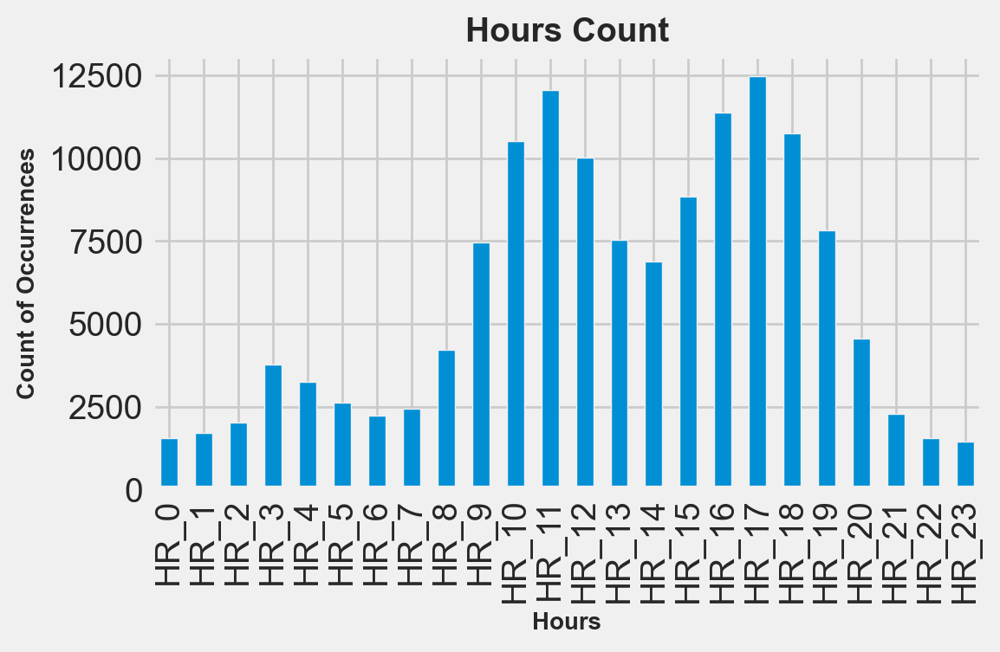

In [138]:
hours_df = df[df.columns[31:55]]

plt.figure(figsize=(6, 4))

# Count the occurrences
Hours_counts = hours_df.sum()
Hours_counts.plot(kind='bar')

# Adjusting the title and labels
plt.title("Hours Count", fontsize=14, weight='bold')
plt.ylabel('Count of Occurrences', fontsize=10, weight='bold')
plt.xlabel('Hours', fontsize=10, weight='bold')


plt.tight_layout()
plt.show()

The imputation of missing values in the `HR_0` feature successfully preserved the original proportions, indicating that the chosen method for filling these gaps was both effective and reliable.

> ### 1.2.2 Creating Week Orders and Weekend Orders <a class="anchor" id="week_orders"></a>

Create two new features that count the number of orders made by each customer during the weekdays (`Week Orders`) and the weekend (`Weekend Orders`).

In [139]:
week_days = ['DOW_1', 'DOW_2','DOW_3', 'DOW_4', 'DOW_5']
weekends_days = ['DOW_0', 'DOW_6']

In [140]:
df['Week Orders'] = df[week_days].sum(axis=1)
df['Weekend Orders'] = df[weekends_days].sum(axis=1)

Let's check if there are any customers who didn't place any orders during the study period, just to be sure:

In [141]:
df[(df['Weekend Orders']==0) & (df['Week Orders']==0)]

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,Total Orders,Missing HR 0,Week Orders,Weekend Orders
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,22.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
c94b288475,8670,26.0,0,0,0,1.0,1,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
f687717dc1,8670,21.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
c6cf0b76fb,8670,38.0,0,0,0,2.0,2,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1b7c34738e,8670,24.0,0,0,0,3.0,3,-,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,8670,30.0,0,0,1,86.0,86,-,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0039059c9c,8670,22.0,0,0,1,88.0,88,DISCOUNT,CARD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0e60632fe2,8670,23.0,0,0,0,89.0,89,DISCOUNT,CARD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


These data are inconsistent, as there are no orders recorded during the 3-month study period, yet `first_order` and `last_order` are logged within this interval, which is unusual. Since these rows do not contribute useful information to the study due to the absence of orders, we will drop them.

In [142]:
indexes_drop = df[(df['Weekend Orders']==0) & (df['Week Orders']==0)].index

In [143]:
df = df.drop(indexes_drop)

> ### 1.2.3 Creating Total Spending <a class="anchor" id="total_spending"></a>

The feature `Total Spending` stores the total amount of money the customer spent on all cuisines over the past three months.

In [144]:
cui_features = ['CUI_American', 'CUI_Asian',
       'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese',
       'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
       'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER',
       'CUI_Street Food / Snacks', 'CUI_Thai']

In [145]:
df['Total Spending'] = df[cui_features].sum(axis=1)

> ### 1.2.4 Creating Average Spending <a class="anchor" id="average_spending"></a>

The feature `Average Spending` represents the average amount a customer spent per order, calculated as the total spending divided by the total number of orders.

In [146]:
df['Average Spending'] = df['Total Spending']/df['Total Orders']

> ### 1.2.5 Creating Days between Orders <a class="anchor" id="days_bt_orders"></a>

The feature `Days between Orders` represents the time interval in days between a customer's first and last orders.

In [147]:
df['Days between Orders'] = df['last_order'] - df['first_order']

> ### 1.2.6 Creating CUI Count <a class="anchor" id="cui_count"></a>

The feature `CUI Count` represents the number of cuisines a customer spent money on.

In [148]:
df["CUI Count"] = (df[cui_features] > 0).sum(axis=1)

> ### 1.2.7 Creating Mealtime Hours <a class="anchor" id="mealtime"></a>

Six new features have been created to record the times when orders were placed, related to meals: `Early Morning`, `Breakfast`, `Lunch`, `Afternoon Snack`, `Dinner`, and `Supper`. This will make it easier to analyze which meal time is most frequently ordered by customers. 

In [149]:
#Hours grouped by time people eat their food
#We think this is a good way to show how the time of the day can be decisive in the purchases of the clients

hours_df = df[df.columns[31:55]]

In [150]:
hours_meal=pd.DataFrame()
hours = hours_df.fillna(0).astype(int)

hours_meal['Early morning'] = hours[['HR_1','HR_2','HR_3','HR_4','HR_5']].sum(axis=1) # 1-5 hours
hours_meal['Breakfast'] = hours[['HR_6','HR_7','HR_8','HR_9','HR_10']].sum(axis=1) # 6-10 hours
hours_meal['Lunch'] = hours[['HR_11','HR_12','HR_13','HR_14']].sum(axis=1) # 11-14 hours
hours_meal['Afternoon Snack'] = hours[['HR_15','HR_16','HR_17','HR_18']].sum(axis=1) # 15-18 hours
hours_meal['Dinner'] = hours[['HR_19','HR_20','HR_21']].sum(axis=1) # 19-21 hours
hours_meal['Supper'] = hours[['HR_22','HR_23','HR_0']].sum(axis=1) # 22-0 hours

In [151]:
df = pd.concat([df,hours_meal], axis=1)

> ## 1.3 Checking Missing Values and Encoding <a class="anchor" id="encoding"></a>

> ### 1.3.1 Dealing with Last Promo <a class="anchor" id="last_promo"></a>

We will use One-Hot Encoding to transform the `Last Promo` feature into four columns, each representing a different promotion or indicating that no promotion was used by the customer.

In [152]:
df['last_promo'].unique()

array(['DELIVERY', 'DISCOUNT', '-', 'FREEBIE'], dtype=object)

In [153]:
df['Delivery Promo'] = df['last_promo'].apply(lambda x: 1 if x == 'DELIVERY' else 0)
df['Discount Promo'] = df['last_promo'].apply(lambda x: 1 if x == 'DISCOUNT' else 0)
df['No Promo'] = df['last_promo'].apply(lambda x: 1 if x == '-' else 0)
df['Freebie Promo'] = df['last_promo'].apply(lambda x: 1 if x == 'FREEBIE' else 0)

Since we have extracted all the useful information from this feature, we can now proceed to drop it.

In [154]:
df.drop('last_promo', axis=1, inplace=True)

> ### 1.3.2 Checking Customer Region <a class="anchor" id="region"></a>

Some features have values represented by a '-'. We will interpret '-' in the `Customer Region` feature as a missing value.

In [155]:
print('Customer Region:', df['customer_region'].unique())

Customer Region: ['2360' '8670' '4660' '2440' '-' '4140' '2490' '8370' '8550']


In [156]:
df['customer_region'] = df['customer_region'].replace({'-': np.nan})

# Check the change in the missing values representation
df['customer_region'].unique()

array(['2360', '8670', '4660', '2440', nan, '4140', '2490', '8370',
       '8550'], dtype=object)

These missing values will be addressed later.

> ### 1.3.3 Dealing with Payment Method <a class="anchor" id="payment"></a>

We will use One-Hot Encoding to transform the `Payment Method` feature into four columns, each representing a different payment method used by the customer on is last order.

In [157]:
df['payment_method'].unique()

array(['DIGI', 'CASH', 'CARD'], dtype=object)

In [158]:
df['Payment Digi'] = df['payment_method'].apply(lambda x: 1 if x == 'DIGI' else 0)
df['Payment Cash'] = df['payment_method'].apply(lambda x: 1 if x == 'CASH' else 0)
df['Payment Card'] = df['payment_method'].apply(lambda x: 1 if x == 'CARD' else 0)

Since we have extracted all the useful information from this feature, we can now proceed to drop it.

In [159]:
df.drop('payment_method', axis=1, inplace=True)

______

> ## 1.4 Measures of Central Tendency <a class="anchor" id="measures"></a>

We decided to address the missing values in `customer_age` by imputing them using **Measures of Central Tendency**. This approach was selected because it contains only a small number of missing values. 

For the `first_order` feature, we decided to drop the missing values since they represent only 0.33% of the dataset. Additionally, the median and mean of this feature are significantly distant from the higher data distribution, making imputation less suitable in this case.

For `customer_region`, we took a more bold approach by imputing the missing values based on the correlation between the cuisines and the regions where customers live.


> ### 1.4.1 `Customer Age` Missing Values <a class="anchor" id="miss_age"></a>

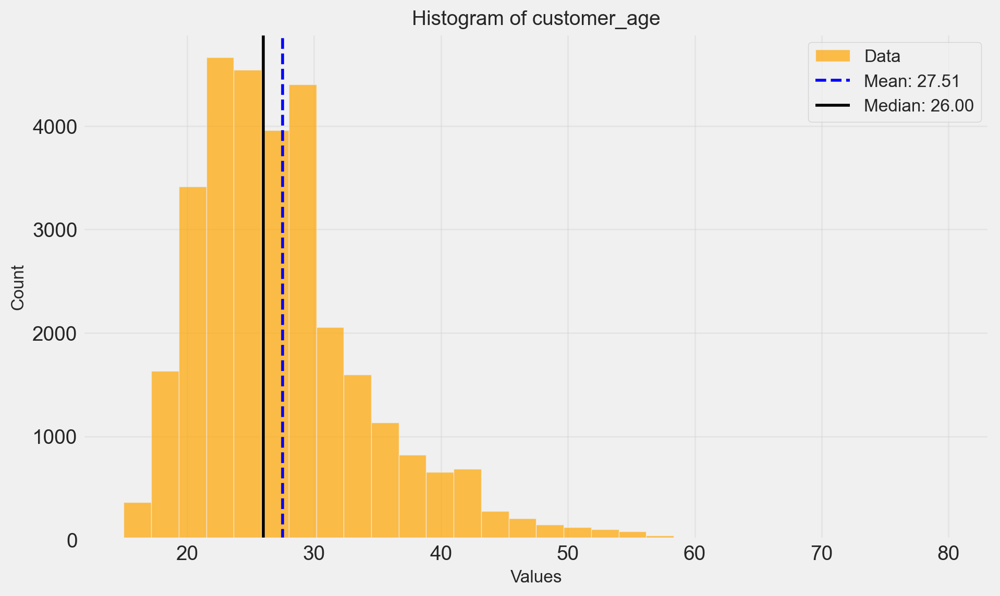

In [160]:
plot_histogram_with_mean_median('customer_age', df, bins=30)

We chose to fill the missing values in `customer_age` with the median, as it is less affected by outliers compared to the mean.

In [161]:
df['customer_age'] = df['customer_age'].fillna(df['customer_age'].median())

> ### 1.4.2 `First Order`  Missing Values <a class="anchor" id="miss_first"></a>

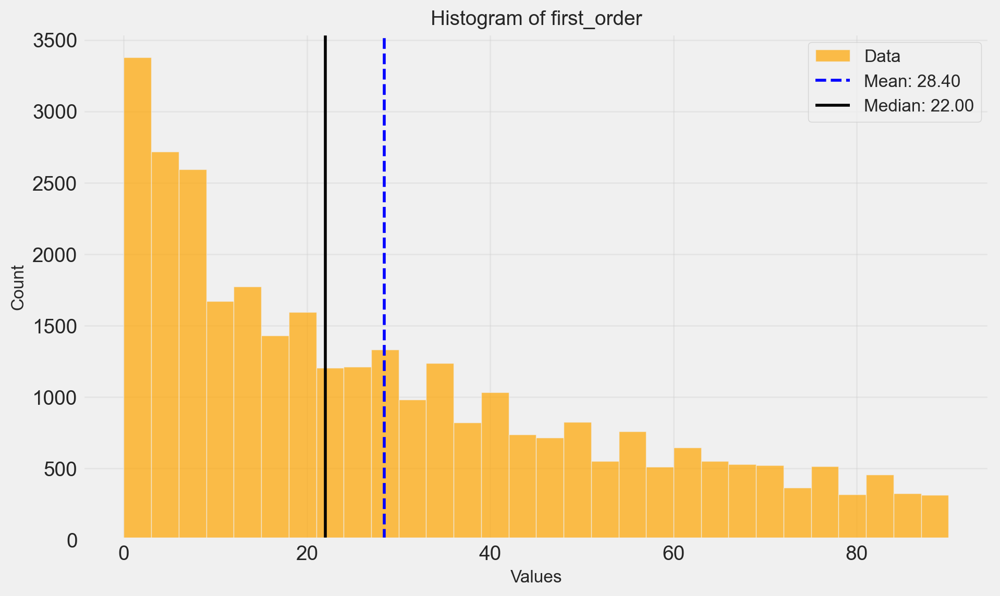

In [162]:
plot_histogram_with_mean_median('first_order', df, bins=30)

We dropped the missing values in `first_order` due to their low percentage, only 0.33% of the dataset, and the fact that no measure of central tendency was suitable for imputation.

In [163]:
missing_first_order = df[df['first_order'].isna()]

df.drop(missing_first_order.index, axis=0, inplace=True)

> ### 1.4.3 `Customer Region` Missing Values <a class="anchor" id="miss_region"></a>

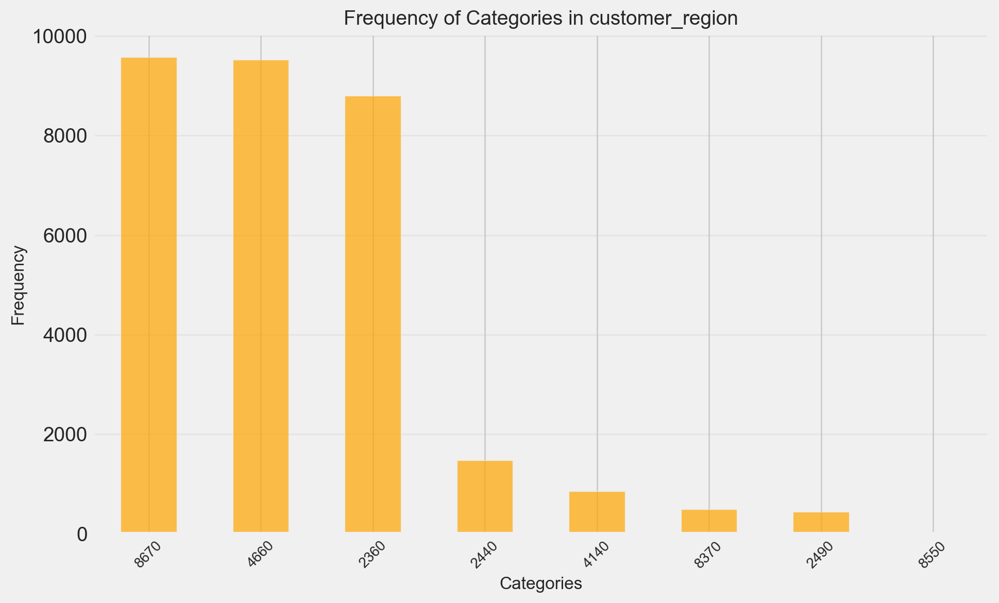

In [164]:
plot_categorical_frequency('customer_region', df)

- Those living in the `2360` region do not spend significant amounts of money on different types of food.
- Those who live in the `4660` region spend more money on American cuisine and Italian cuisine.
- Those living in the `8670` region spend a lot of money on Asian food and then on Street Food / Snacks.

In [165]:
'''
# Use .loc to replace specified customer regions with 'other'
df.loc[df['customer_region'].isin(['8550', '8370', '4140', '2490', '2440']), 'customer_region'] = 'other'

# Group by modified 'customer_region' and aggregate sum of cuisines
region_cuisine_counts = df.groupby('customer_region')[cui_features].sum().round().astype(int) 

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(region_cuisine_counts, annot=True, cmap='YlGnBu', fmt='d', annot_kws={"size": 10}) 
plt.title('Cuisine Preferences Heatmap by Customer Region')
plt.xlabel('Cuisine Type')
plt.ylabel('Customer Region')
plt.show()
'''

'\n# Use .loc to replace specified customer regions with \'other\'\ndf.loc[df[\'customer_region\'].isin([\'8550\', \'8370\', \'4140\', \'2490\', \'2440\']), \'customer_region\'] = \'other\'\n\n# Group by modified \'customer_region\' and aggregate sum of cuisines\nregion_cuisine_counts = df.groupby(\'customer_region\')[cui_features].sum().round().astype(int) \n\n# Plot the heatmap\nplt.figure(figsize=(12, 8))\nsns.heatmap(region_cuisine_counts, annot=True, cmap=\'YlGnBu\', fmt=\'d\', annot_kws={"size": 10}) \nplt.title(\'Cuisine Preferences Heatmap by Customer Region\')\nplt.xlabel(\'Cuisine Type\')\nplt.ylabel(\'Customer Region\')\nplt.show()\n'

We filled the missing values in `customer_region` based on the most consumed cuisines by the customers to determine their living area. Customers who consume more Asian and Street Food/Snacks were assigned to region `8670`, those who prefer American or Italian cuisine were assigned to region `4660`, and the rest were assigned to region `2360`. We limited the assignment to these three regions as they are the areas with the highest concentration of customers.

In [166]:
nan_customer_region = df[df['customer_region'].isna()].copy()

nan_customer_region['Max_CUI'] = nan_customer_region[cui_features].idxmax(axis=1)

for customer in nan_customer_region.index:
    max_cui = nan_customer_region.loc[customer, 'Max_CUI']
    if max_cui == 'CUI_Asian' or max_cui == 'CUI_Street Food / Snack':
        df.loc[customer, 'customer_region'] = '8670'
        
    elif max_cui == 'CUI_American' or max_cui == 'CUI_Italian':
        df.loc[customer, 'customer_region'] = '4660'
    else:
        df.loc[customer, 'customer_region'] = '2360'

We can observe in the barplot below that the trends for `customer_region` remain intact after imputing the missing values with this technique.

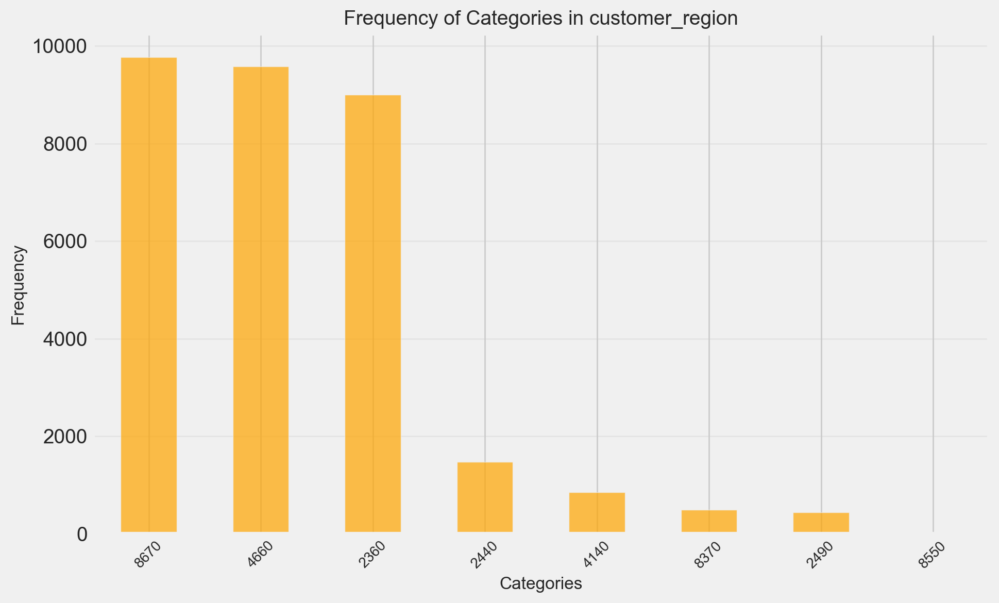

In [167]:
plot_categorical_frequency('customer_region', df)

_____

In [168]:
missing_data(df)

,variable,dtype,count,unique,missing,pc_missing
0,customer_region,object,31631,8,0,0.0
1,customer_age,float64,31631,66,0,0.0
2,vendor_count,int64,31631,36,0,0.0
3,product_count,int64,31631,93,0,0.0
4,is_chain,int64,31631,60,0,0.0
5,first_order,float64,31631,91,0,0.0
6,last_order,int64,31631,90,0,0.0
7,CUI_American,float64,31631,3327,0,0.0
8,CUI_Asian,float64,31631,4648,0,0.0
9,CUI_Beverages,float64,31631,2194,0,0.0


____

> # 2. Outliers Removal <a class="anchor" id="outliers"></a>

In [169]:
metric_features = ['customer_age', 'vendor_count', 'product_count', 'is_chain',
       'first_order', 'last_order', 'CUI_American', 'CUI_Asian',
       'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese',
       'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
       'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER',
       'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2',
       'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3',
       'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11',
       'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19',
       'HR_20', 'HR_21', 'HR_22', 'HR_23', 'Total Orders','Early morning', 
       'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner',
       'Supper', 'Total Spending', 'Week Orders', 'Weekend Orders', 'Days between Orders', 
       'CUI Count', 'Average Spending']

Let's plot the boxplots of all numerical variables to help us visualize and make informed decisions about where to remove outliers for each feature.

In [170]:

def plot_boxplots(df, cols_per_row=4):
    num_vars = len(df.columns)
    rows = (num_vars + cols_per_row - 1) // cols_per_row

    fig, axes = plt.subplots(rows, cols_per_row, figsize=(cols_per_row * 5, rows * 5))
    axes = axes.flatten()  # Flatten para lidar com subplots

    for i, col in enumerate(df.columns):
        axes[i].boxplot(df[col].dropna())
        axes[i].set_title(col)

    # Desativar os eixos extras
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

plot_boxplots(df[metric_features])


After attempting to implement the IQR (Interquartile Range) method for outlier removal, we found it unsuitable because many variables have both the first and third quartiles equal to zero. This causes the method to remove all values greater than zero for several features. Therefore, the outlier removal will need to be done manually by visualizing their boxplots. Note that this removal will not exceed 5% of the data to avoid significant information loss.

In [171]:
hr_features = ['HR_0', 'HR_1', 'HR_2', 'HR_3',
       'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11',
       'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19',
       'HR_20', 'HR_21', 'HR_22', 'HR_23']

**Decisions made for outlier removal:**

In [172]:
filters = pd.DataFrame(True, index=df.index, columns=df.columns)

# Filters for Cuisines
filters['CUI_American'] = df['CUI_American'] <= 125
filters['CUI_Asian'] = df['CUI_Asian'] <= 300
filters['CUI_Beverages'] = df['CUI_Beverages'] <= 125
filters['CUI_Cafe'] = df['CUI_Cafe'] <= 100
filters['CUI_Chicken Dishes'] = df['CUI_Chicken Dishes'] <= 60
filters['CUI_Chinese'] = df['CUI_Chinese'] <= 150
filters['CUI_Desserts'] = df['CUI_Desserts'] <= 75
filters['CUI_Healthy'] = df['CUI_Healthy'] <= 80
filters['CUI_Indian'] = df['CUI_Indian'] <= 150
filters['CUI_Italian'] = df['CUI_Italian'] <= 160
filters['CUI_Japanese'] = df['CUI_Japanese'] <= 150
filters['CUI_Noodle Dishes'] = df['CUI_Noodle Dishes'] <= 75
filters['CUI_OTHER'] = df['CUI_OTHER'] <= 125
filters['CUI_Street Food / Snacks'] = df[ 'CUI_Street Food / Snacks'] <= 200
filters['CUI_Thai'] = df['CUI_Thai'] <= 70

# Filters for Mealtime
filters['Early morning'] = df['Early morning'] <= 20
filters['Breakfast'] = df['Breakfast'] <= 23
filters['Lunch'] = df['Lunch'] <= 30
filters['Afternoon Snack'] = df['Afternoon Snack'] <= 26
filters['Dinner'] = df['Dinner'] <= 18
filters['Supper'] = df['Supper'] <= 15

# Filters for Days
filters['Week Orders'] = df['Week Orders'] <= 40
filters['Weekend Orders'] = df['Weekend Orders'] <= 25

# Filters for other numeric features
filters['Total Spending'] = df['Total Spending'] <= 500
filters['Total Orders'] = df['Total Orders'] <= 65
filters['Average Spending'] = df['Average Spending'] <= 70

# Combine all filters
combined_filter = filters.all(axis=1)

# Separate outliers and cleaned data
df_cleaned = df[combined_filter]
df_outliers = df[~combined_filter]

# Calculate percentages
total_rows = len(df)
outlier_count = len(df_outliers)
outlier_percentage = (outlier_count / total_rows) * 100

print(f"Total rows after Outliers Removal: {total_rows}")
print(f"Percentage of Outliers removed: {outlier_count} ({outlier_percentage:.2f}%)")


Total rows after Outliers Removal: 31631
Percentage of Outliers removed: 284 (0.90%)


______

> # 3. Scaling Data <a class="anchor" id="scaling"></a>

We will test 3 different scaling methods and visualize their respective boxplots to select the best method among **MinMax Scaler** and **Z-Score Scaler**.

In [173]:
df_original = df_cleaned.copy()

df_minmax = df_cleaned.copy()
df_minmax_outliers = df_outliers.copy()

df_standard = df_cleaned.copy()
df_standard_outliers = df_outliers.copy()

In [174]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

mm_scaler = MinMaxScaler()
mm_scaled_feat =  mm_scaler.fit_transform(df_minmax[metric_features])
mm_scaled_feat_outliers = mm_scaler.transform(df_minmax_outliers[metric_features])

df_minmax[metric_features] = mm_scaled_feat
df_minmax_outliers[metric_features] = mm_scaled_feat_outliers

zs_scaler = StandardScaler()
zs_scaled_feat =  zs_scaler.fit_transform(df_standard[metric_features])
zs_scaled_feat_outliers = zs_scaler.transform(df_standard_outliers[metric_features])

df_standard[metric_features] = zs_scaled_feat
df_standard_outliers[metric_features] = zs_scaled_feat_outliers

In [175]:

sns.set_style('whitegrid')

fig, axes = plt.subplots(len(metric_features), 3, figsize=(17, len(metric_features) * 2.5), tight_layout=True, sharex=False, sharey='row', constrained_layout=True)

# Iterate over each feature to create boxplots for all scalers
for row, feature in enumerate(metric_features):
    # Original data boxplot
    sns.boxplot(x=df_original[feature], ax=axes[row][0], width=0.4)
    axes[row][0].set_title('Original')
    axes[row][0].set_ylabel(feature)

    # MinMaxScaler transformed data boxplot
    sns.boxplot(x=df_minmax[feature], ax=axes[row][1], width=0.4)
    axes[row][1].set_title('MinMaxScaler()')

    # StandardScaler transformed data boxplot
    sns.boxplot(x=df_standard[feature], ax=axes[row][2], width=0.4)
    axes[row][2].set_title('StandardScaler()')

fig.suptitle('Boxplots for Comparing Different Scalers', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


/var/folders/m0/h643h92s02b7_ptjdwmyydmr0000gn/T/ipykernel_61998/565951040.py:3: UserWarning: The Figure parameters 'tight_layout' and 'constrained_layout' cannot be used together. Please use 'layout' parameter
  fig, axes = plt.subplots(len(metric_features), 3, figsize=(17, len(metric_features) * 2.5), tight_layout=True, sharex=False, sharey='row', constrained_layout=True)


The **Z-Score Scaling Method** is ideal because it standardizes the data without compressing values to zero, as happens with MinMax scaling. This method ensures that all features contribute equally to the KNN imputer, which relies on distance metrics. By reducing the influence of feature magnitude and effectively handling normally distributed data, Z-Score offers a balanced approach to scaling, enhancing the accuracy and reliability of algorithms sensitive to feature scales.

______

In [176]:
#df_standard.to_csv('df_st_cleaned.csv')
#df_standard_outliers.to_csv('df_st_outliers.csv')

#df_minmax.to_csv('df_mm_cleaned.csv')
#df_minmax_outliers.to_csv('df_mm_outliers.csv')

______

> # 4. Feature Selection <a class="anchor" id="feature"></a>

> ## 4.1 Correlation Matrix <a class="anchor" id="cor_matrix"></a>

The correlation matrix is a valuable tool for `feature selection` in clustering because it helps identify relationships between variables. By analyzing the matrix, we can detect features that are highly correlated with each other, which may indicate redundancy.

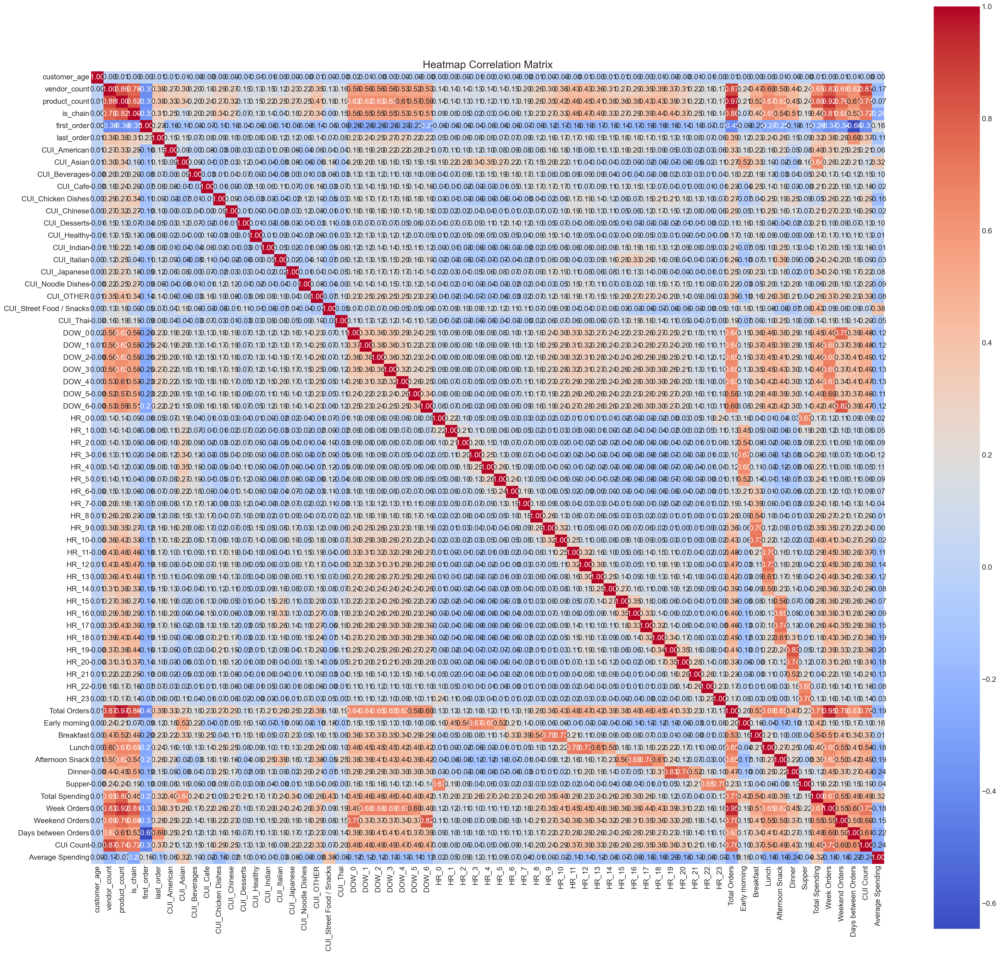

In [177]:

# Calculate the correlation matrix directly
correlation_matrix = df_standard[metric_features].corr()

# Create a heatmap of the correlation matrix
plt.figure(figsize=(30, 30))
sns.heatmap(
    correlation_matrix,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    cbar=True,
    square=True
)
plt.title("Heatmap Correlation Matrix")
plt.show()


Features that we will not use for clustering based in the Correlation Matrix:
- vendor_count
- product_count
- is_chain
- All days (DOW_0 to DOW_6)
- All hours (HR_0 to HR_23)

______

> # 5. Clustering <a class="anchor" id="clustering"></a>

In [178]:
df = df_standard.copy()

In [179]:
df_outliers = df_standard_outliers.copy()

In [180]:
categorical_features = [
'First Order Before Study', 'Delivery Promo', 'Discount Promo',
       'No Promo', 'Freebie Promo', 'Payment Digi',
       'Payment Cash', 'Payment Card', 'Weekends Customer'
]

> ## **5.1 Perspective 1:** Loyalty and Retention <a class="anchor" id="p1"></a>

In [181]:
p1_feat = ['first_order', 'last_order', 'Days between Orders', 
           'Total Orders', 'Week Orders', 'Weekend Orders']

> ### 5.1.1 Selecting K <a class="anchor" id="selecting_k_p1"></a>

After testing various combinations of these features, the highest score was achieved using the following set:

In [182]:
p1_feat = ['first_order', 'last_order', 'Days between Orders', 
           'Total Orders', 'Week Orders']


Exact R² Scores:
                          R²
Number of Clusters          
2                   0.395397
3                   0.561865
4                   0.724681
5                   0.775360
6                   0.804378
7                   0.827934
8                   0.851715
9                   0.868327


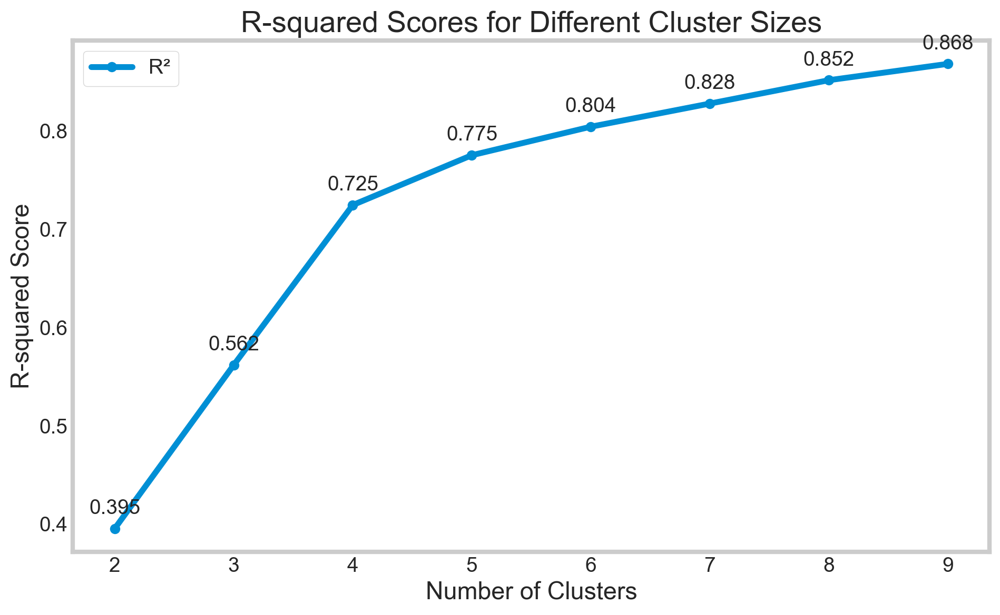

In [183]:
plot_r2_scores(df, p1_feat)


Davies-Bouldin Scores:
   Number of Clusters  Davies-Bouldin Score
0                   2              1.062093
1                   3              0.874140
2                   4              0.752370
3                   5              0.828644
4                   6              0.948268
5                   7              0.923929
6                   8              0.847530
7                   9              0.871146
8                  10              0.895954


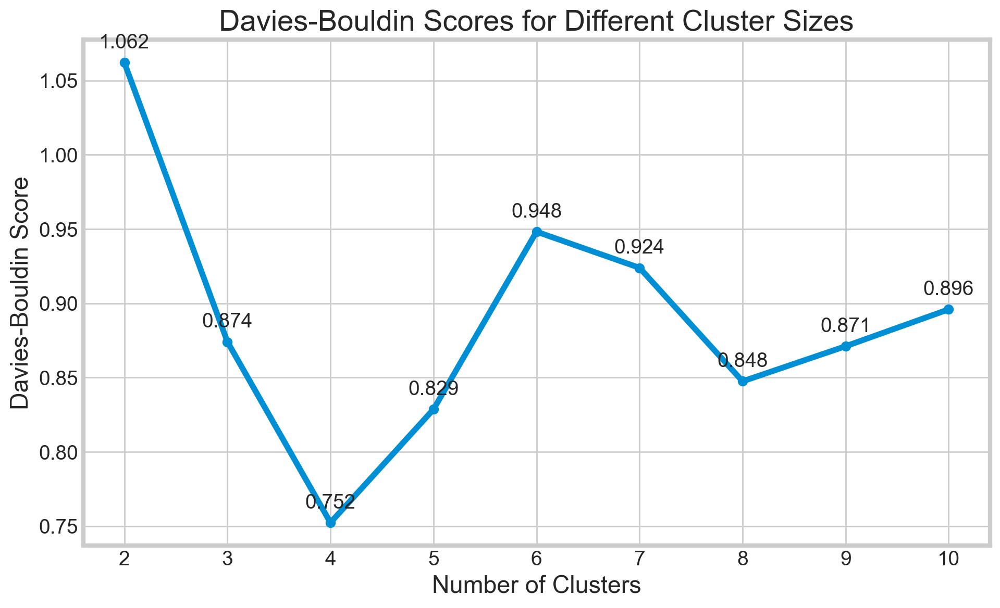

In [184]:
dbs_plot(df, p1_feat)


Silhouette Coefficients:
   Number of Clusters  Silhouette Coefficient
0                   2                0.378125
1                   3                0.387562
2                   4                0.427804
3                   5                0.400985
4                   6                0.361800
5                   7                0.350476
6                   8                0.356498
7                   9                0.350598
8                  10                0.343021


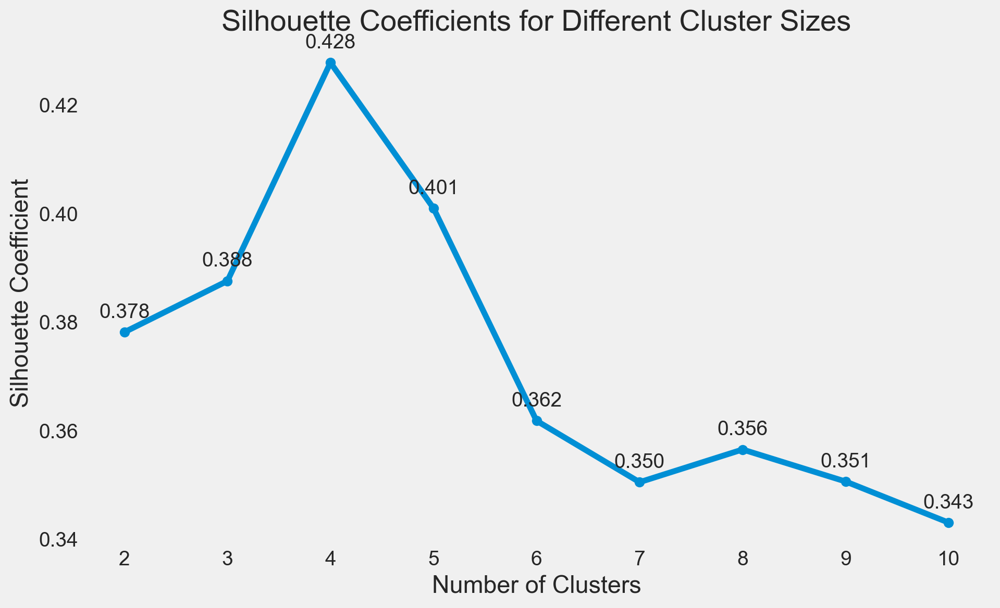

In [185]:
silhoutte_plot(df, p1_feat)

> ### 5.1.3 Applying K-Means <a class="anchor" id="kmeans_p1"></a>

In [186]:
kmeans_p1 = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=42)
cluster_labels_p1 = kmeans_p1.fit_predict(df[p1_feat])
centroids = kmeans_p1.cluster_centers_

In [187]:
df['p1_labels'] = cluster_labels_p1

> ### 5.1.4 Cluster Analysis <a class="anchor" id="analysis_p1"></a>

### Cluster Feature Profiling

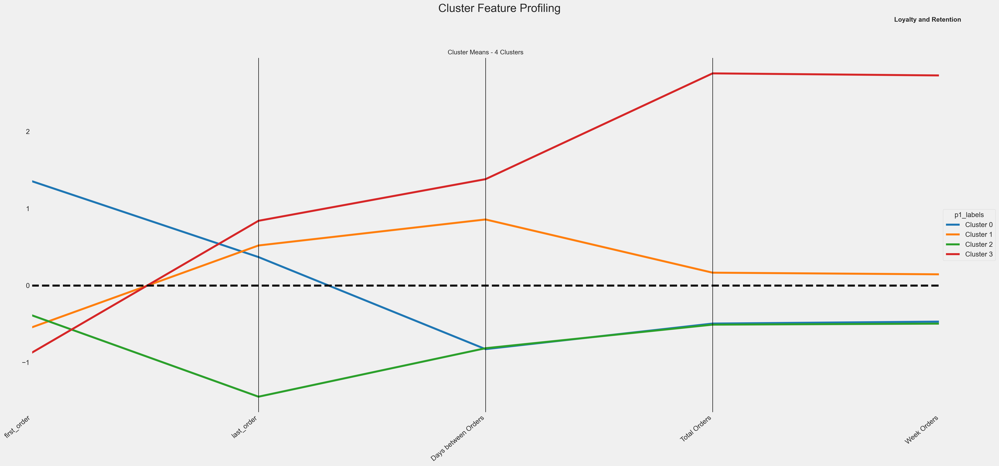

In [188]:
cluster_profiles(
    df = df[p1_feat + ['p1_labels']], 
    label_columns = ['p1_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Loyalty and Retention", ]
)

### Cluster Cardinality

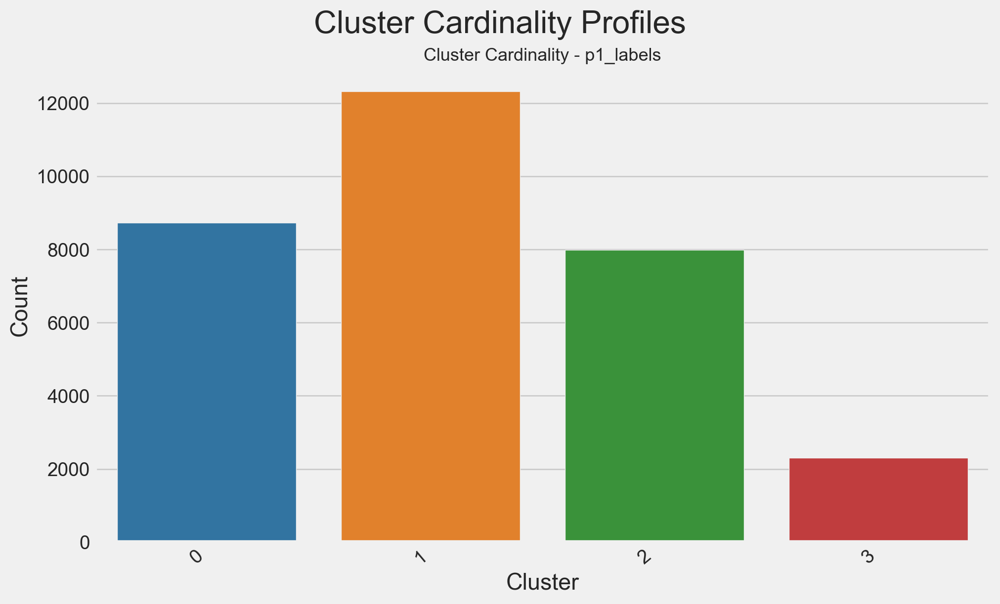

In [189]:
plot_cluster_cardinality(df, ['p1_labels'], figsize=(10, 6))

In [190]:
# Assuming df is your DataFrame and 'p1_labels' contains the cluster labels
df['p1_labels'] = cluster_labels_p1  # Replace with actual cluster labels
cluster_summary = count_cluster_members(df, 'p1_labels')
print(cluster_summary)

   Cluster  Member_Count
0        0          8732
1        1         12320
2        2          7988
3        3          2307


### Total Spending by Cluster

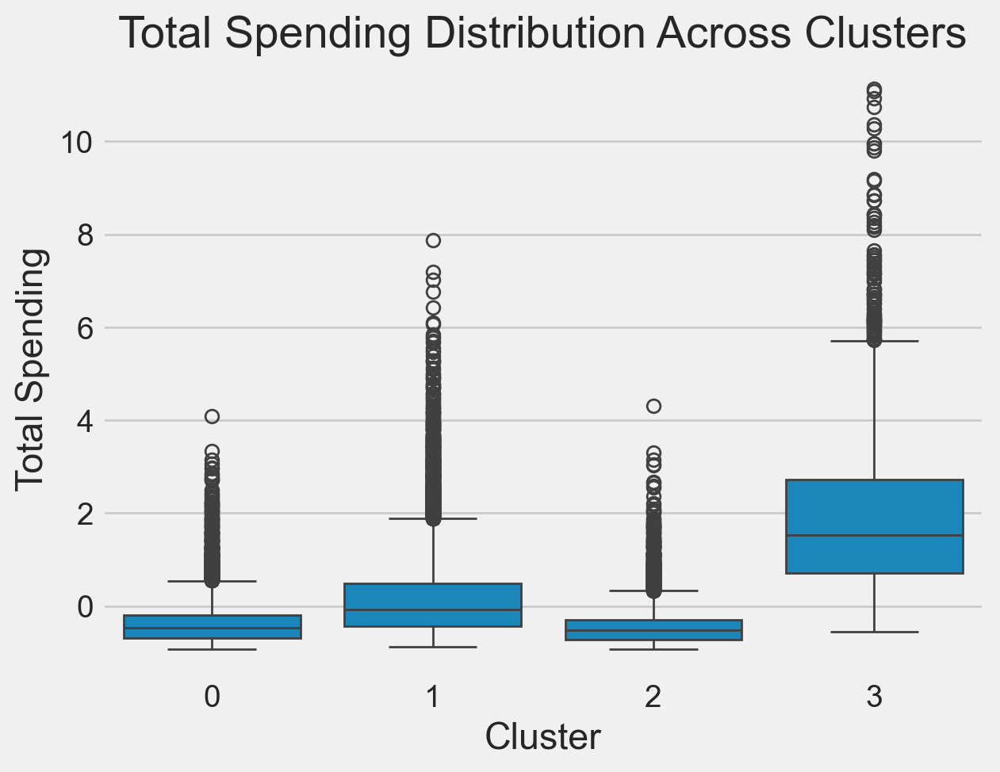

In [191]:
sns.boxplot(data=df, x='p1_labels', y='Total Spending')
plt.title('Total Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Total Spending')
plt.show()

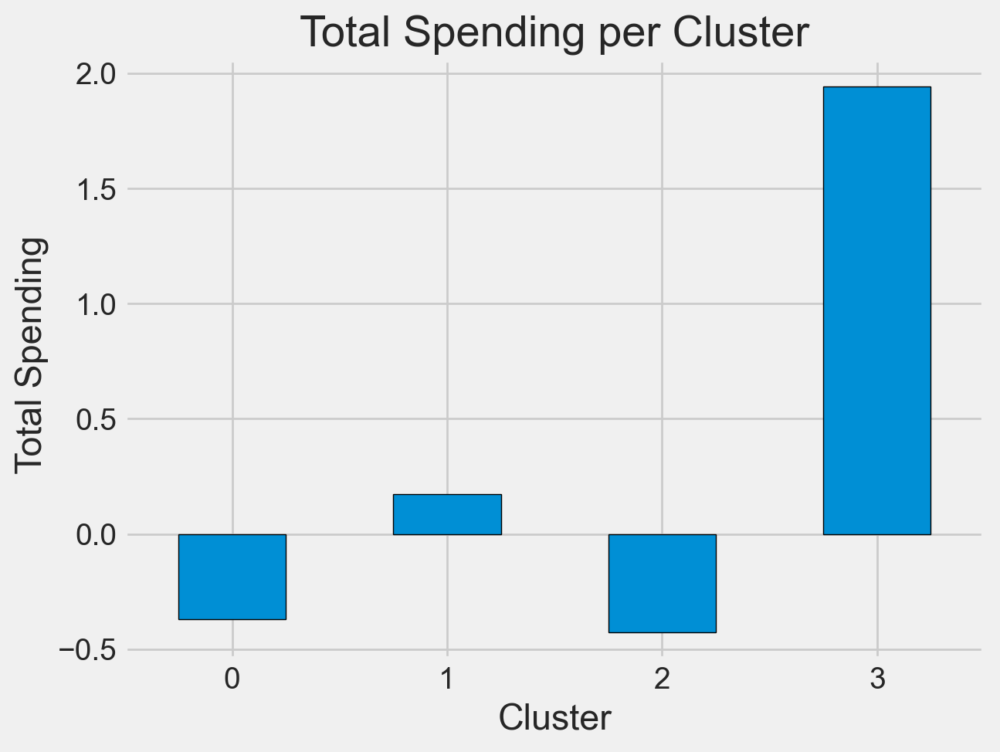

In [192]:
mean_spending = df.groupby('p1_labels')['Total Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Total Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel(' Total Spending')
plt.xticks(rotation=0)
plt.show()

### Average Spending by Cluster

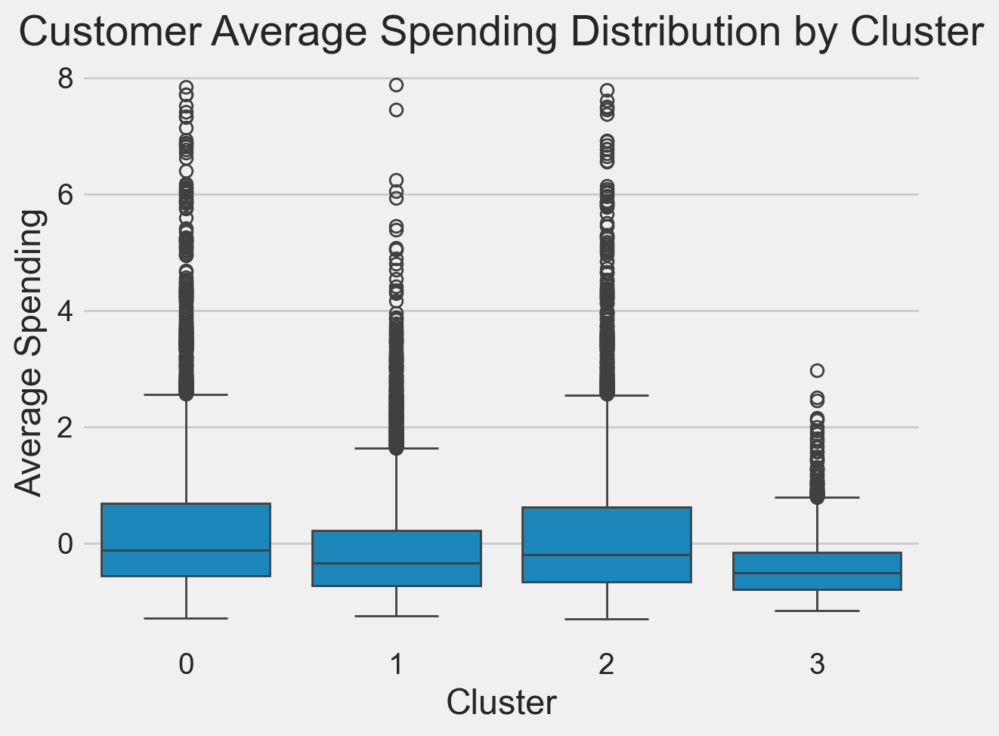

In [193]:
sns.boxplot(data=df, x='p1_labels', y='Average Spending')
plt.title('Customer Average Spending Distribution by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.show()

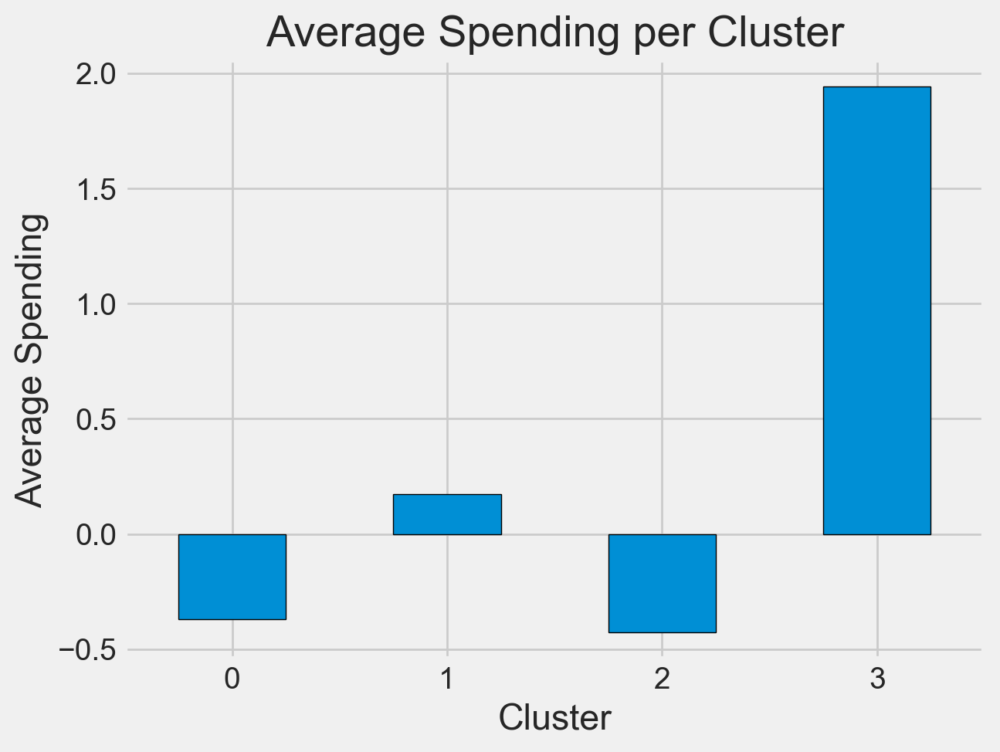

In [194]:
average_spending = df.groupby('p1_labels')['Average Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Average Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.xticks(rotation=0)
plt.show()

### Cuisine Type Analysis

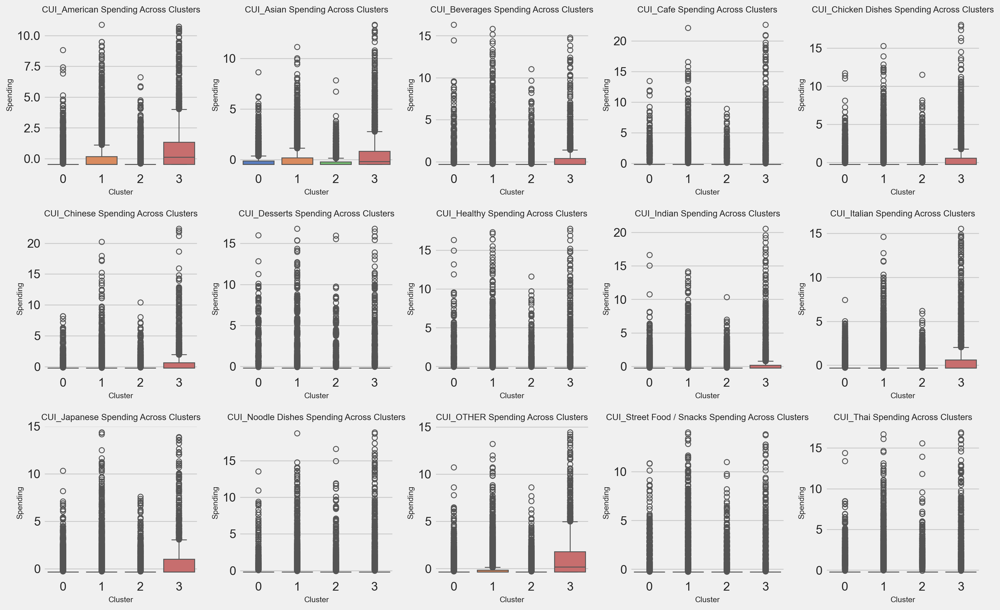

In [195]:
# Define cuisines
cuisine_columns = [
    'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Set figure size
plt.figure(figsize=(16, 10))

# Create a boxplot for each cuisine
for i, cuisine in enumerate(cuisine_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p1_labels', y=cuisine, palette='muted', hue='p1_labels', legend=False),
    plt.title(f'{cuisine} Spending Across Clusters', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

<Figure size 1200x800 with 0 Axes>

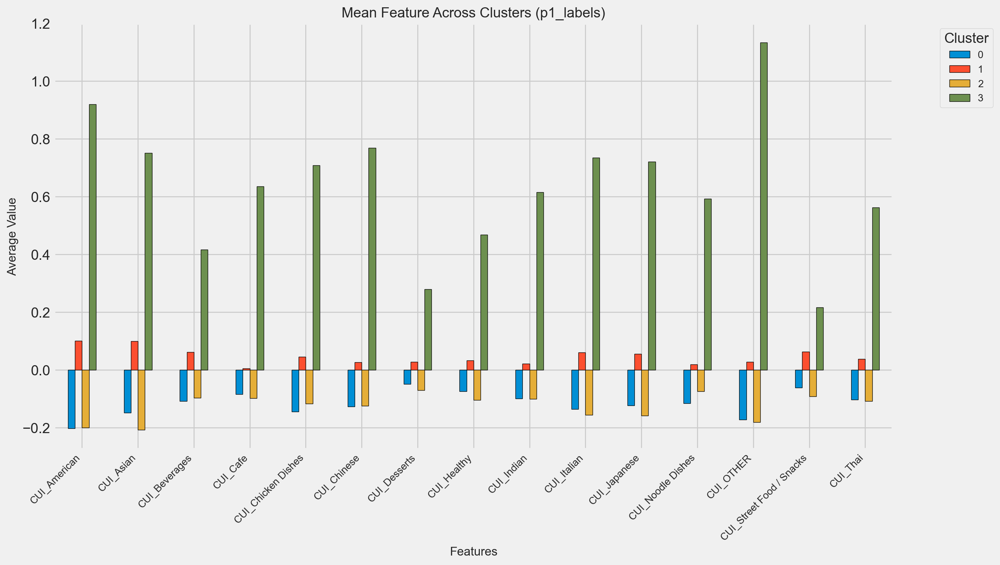

In [196]:
cuisine_columns = [
     'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p1_labels')[cuisine_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Mean Feature Across Clusters (p1_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

### Other Features

<Figure size 1200x800 with 0 Axes>

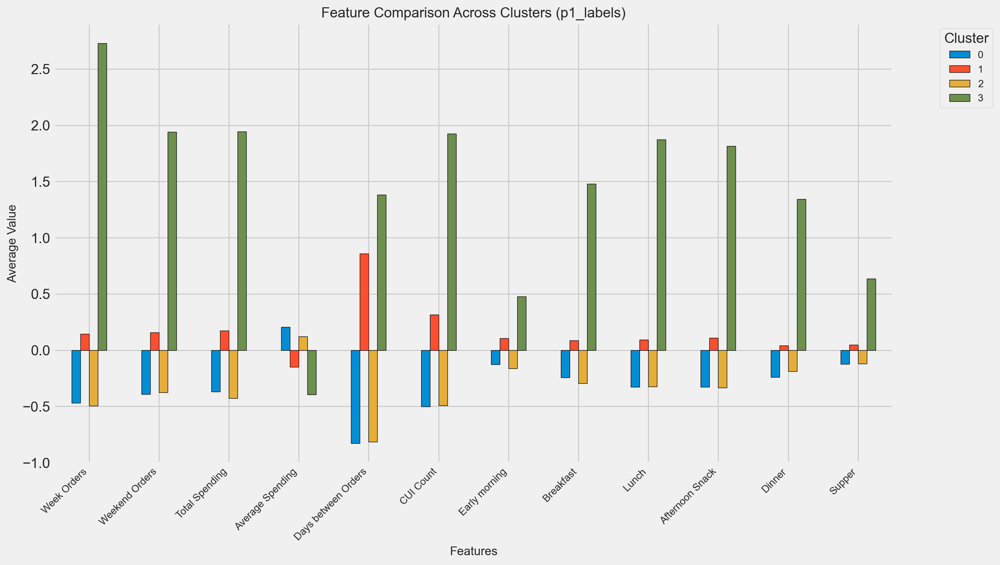

In [197]:
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
    'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
    'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p1_labels')[other_columns].mean()

cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (p1_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

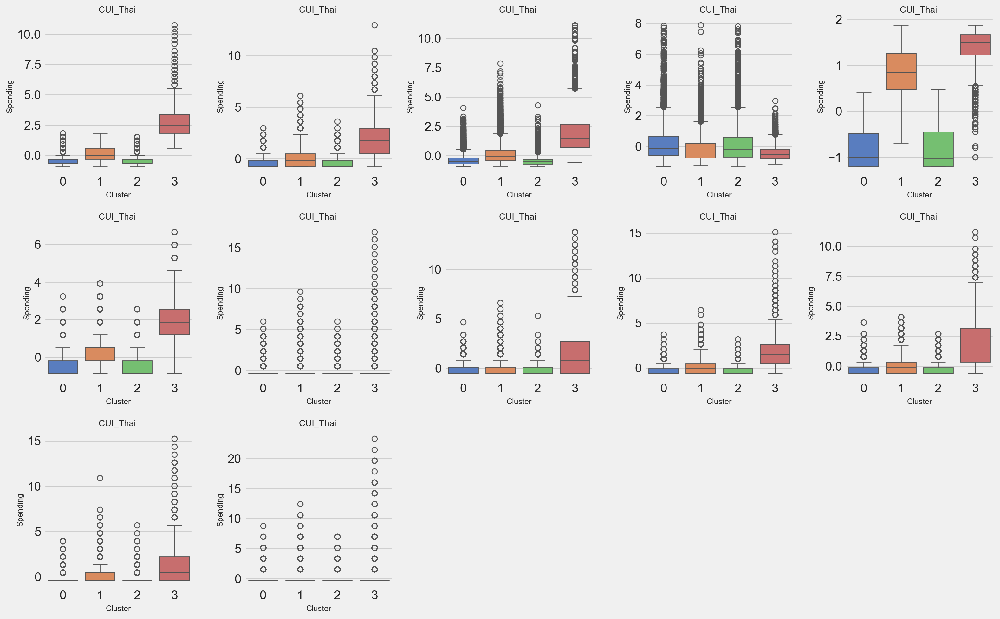

In [198]:
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
       'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
       'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',]

#Set figure size
plt.figure(figsize=(16, 10))

#Create a boxplot for each cuisine
for i, feature in enumerate(other_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p1_labels', y=feature, palette='muted', hue='p1_labels', legend=False),
    plt.title(f'{cuisine} ', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  
plt.show()

### Customer Region Distribution

In [199]:
# Counts for customer_region by cluster
region_counts = df.groupby(['p1_labels', 'customer_region']).size().unstack(0)
print(region_counts)

p1_labels           0     1     2    3
customer_region                       
2360             2025  3551  2422  940
2440              311   635   387  137
2490              105   185   116   38
4140              342   275   200   34
4660             2695  3811  2193  762
8370              192   148   142    8
8550                8     3     1    1
8670             3054  3712  2527  387


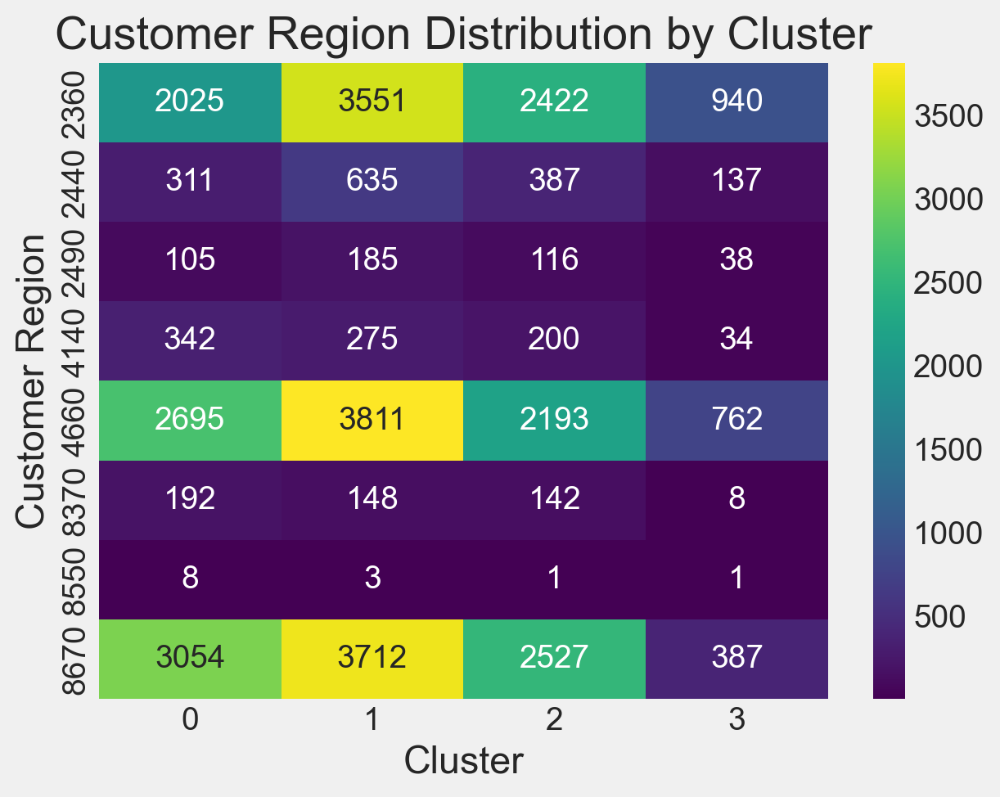

In [200]:
sns.heatmap(region_counts, annot=True, cmap='viridis', fmt='d')
plt.title('Customer Region Distribution by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Customer Region')
plt.show()

### Cluster Visualization

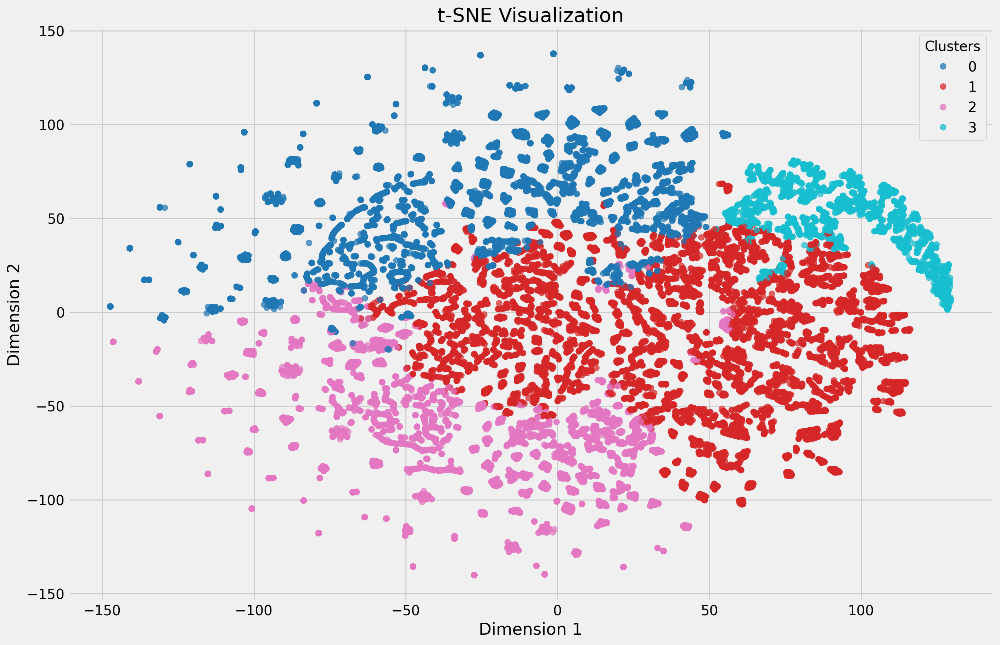

In [ ]:
plot_tsne(df, p1_feat, 'p1_labels', figsize=(15, 10), colormap='tab10')

______

> ## **5.2 Perspective 2:** Customer Behavior <a class="anchor" id="p2"></a>

In [202]:
p2_feat = [
    'Total Orders',
    'Total Spending',
    'Days between Orders',
    'Week Orders', 'Weekend Orders',
    'CUI Count',
    'first_order',
    'last_order',
    'Average Spending',
    'Early morning', 'Breakfast',
    'Lunch', 'Afternoon Snack', 
    'Dinner', 'Supper',
 ]

> ### 5.2.1 Selecting K <a class="anchor" id="selecting_k_p2"></a>

After testing various combinations of these features, the highest score was achieved using the following set:

In [203]:
p2_feat = [
    'Total Orders',
    'Total Spending',
    'Days between Orders',
    'Week Orders',
    'Weekend Orders',
    'CUI Count',
    'first_order',
    'last_order'
 ]


Exact R² Scores:
                          R²
Number of Clusters          
2                   0.366446
3                   0.519522
4                   0.619380
5                   0.673936
6                   0.698695
7                   0.716240
8                   0.732517
9                   0.747663


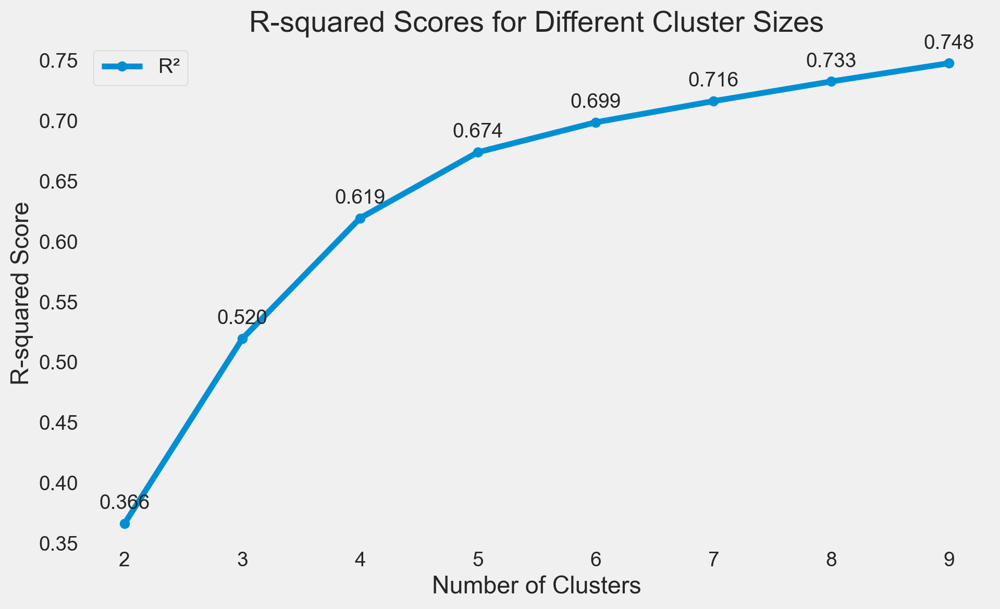

In [204]:
plot_r2_scores(df, p2_feat)


Davies-Bouldin Scores:
   Number of Clusters  Davies-Bouldin Score
0                   2              1.114272
1                   3              1.184033
2                   4              1.004285
3                   5              1.154218
4                   6              1.334121
5                   7              1.403007
6                   8              1.389781
7                   9              1.379697
8                  10              1.316439


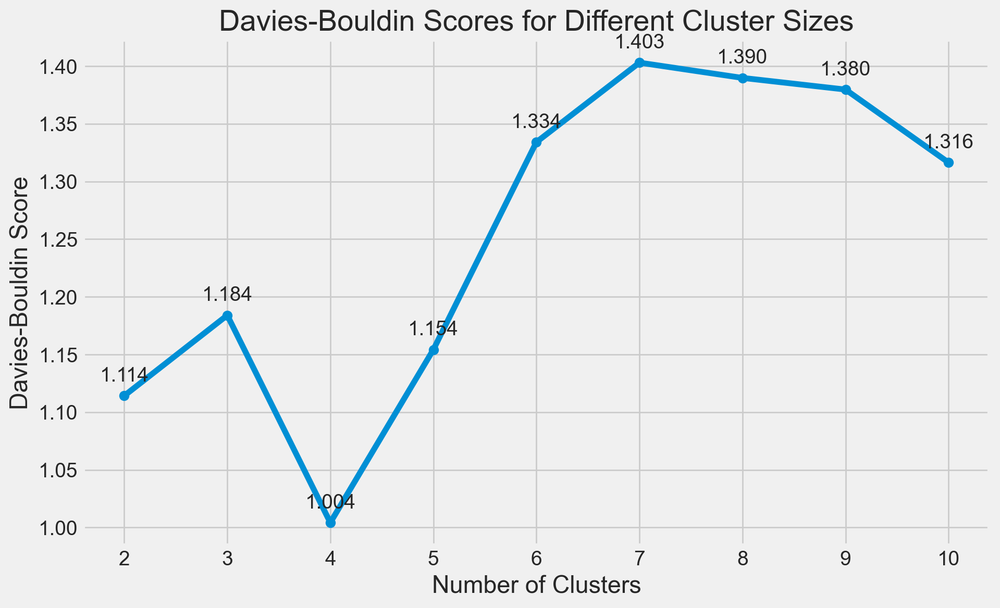

In [205]:
dbs_plot(df, p2_feat)


Silhouette Coefficients:
   Number of Clusters  Silhouette Coefficient
0                   2                0.402499
1                   3                0.304576
2                   4                0.319564
3                   5                0.308642
4                   6                0.283572
5                   7                0.252630
6                   8                0.255542
7                   9                0.239316
8                  10                0.231475


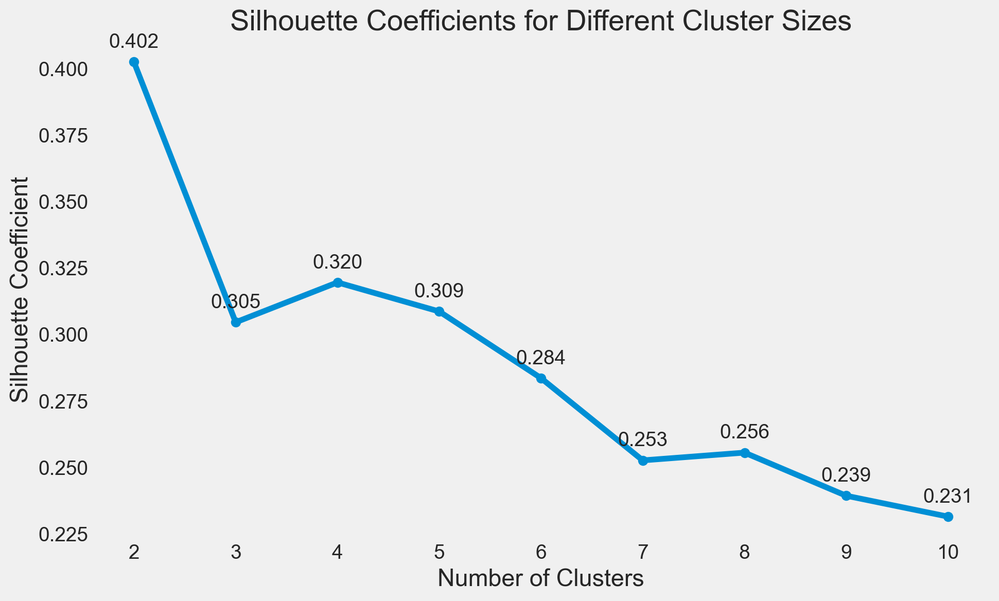

In [206]:
silhoutte_plot(df, p2_feat)

Although the silhouette score is higher for 2 clusters, we believe that this is a small number of clusters to provide significant distinction between customers, so we will use 4 instead.

> ### 5.2.3 Applying K-Means <a class="anchor" id="kmeans_p2"></a>

In [207]:
kmeans_p2 = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=42)
cluster_labels_p2 = kmeans_p2.fit_predict(df[p2_feat])
centroids = kmeans_p2.cluster_centers_

In [208]:
df['p2_labels'] = cluster_labels_p2

> ### 5.2.4 Cluster Analysis <a class="anchor" id="analysis_p2"></a>

### Cluster Feature Profiling

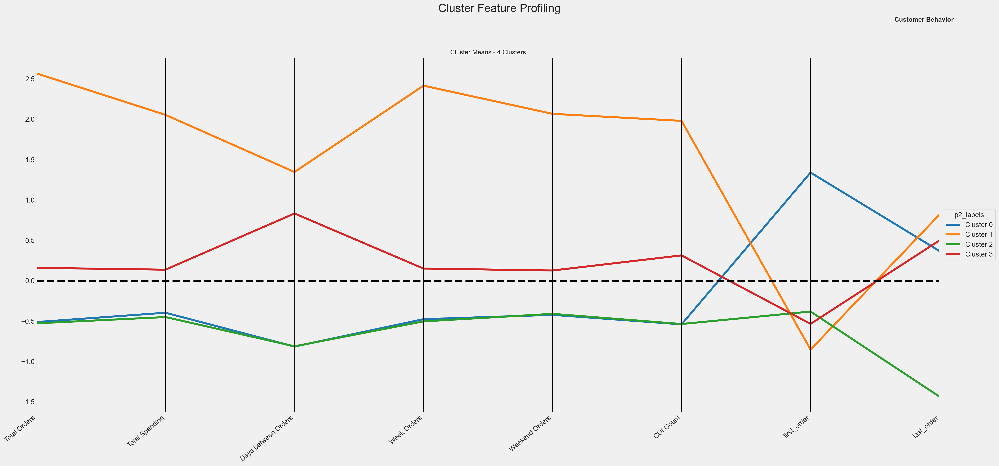

In [209]:
cluster_profiles(
    df = df[p2_feat + ['p2_labels']], 
    label_columns = ['p2_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Customer Behavior", ]
)

### Cluster Cardinality

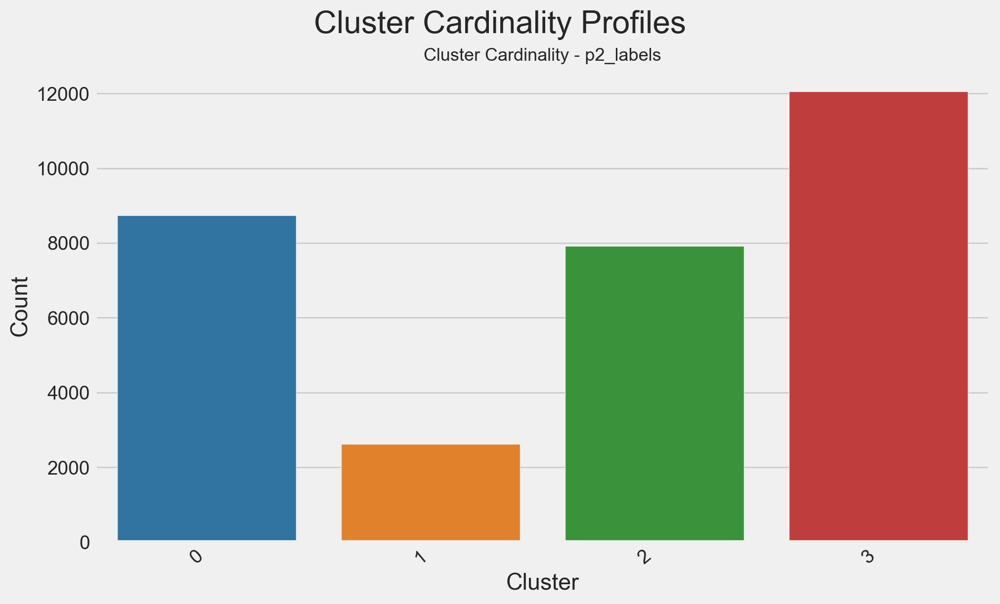

In [210]:
plot_cluster_cardinality(df, ['p2_labels'], figsize=(10, 6))

In [211]:
df['p2_labels'] = cluster_labels_p2  # Replace with actual cluster labels
cluster_summary = count_cluster_members(df, 'p2_labels')
print(cluster_summary)

   Cluster  Member_Count
0        0          8745
1        1          2626
2        2          7924
3        3         12052


### Total Spending

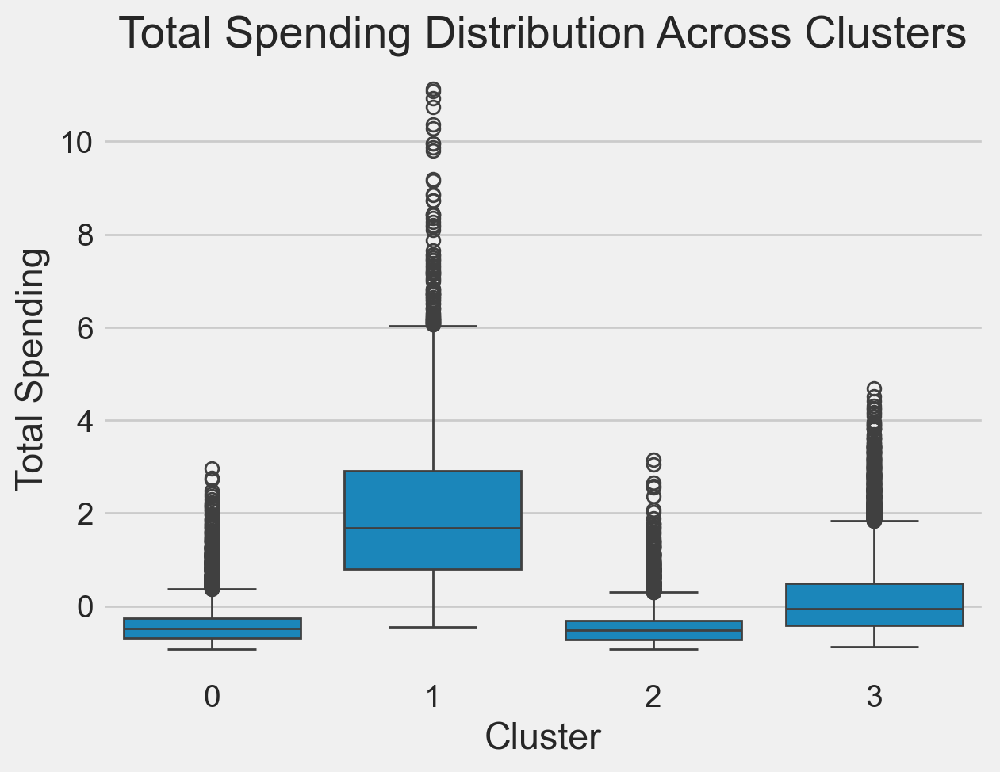

In [212]:
sns.boxplot(data=df, x='p2_labels', y='Total Spending')
plt.title('Total Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Total Spending')
plt.show()

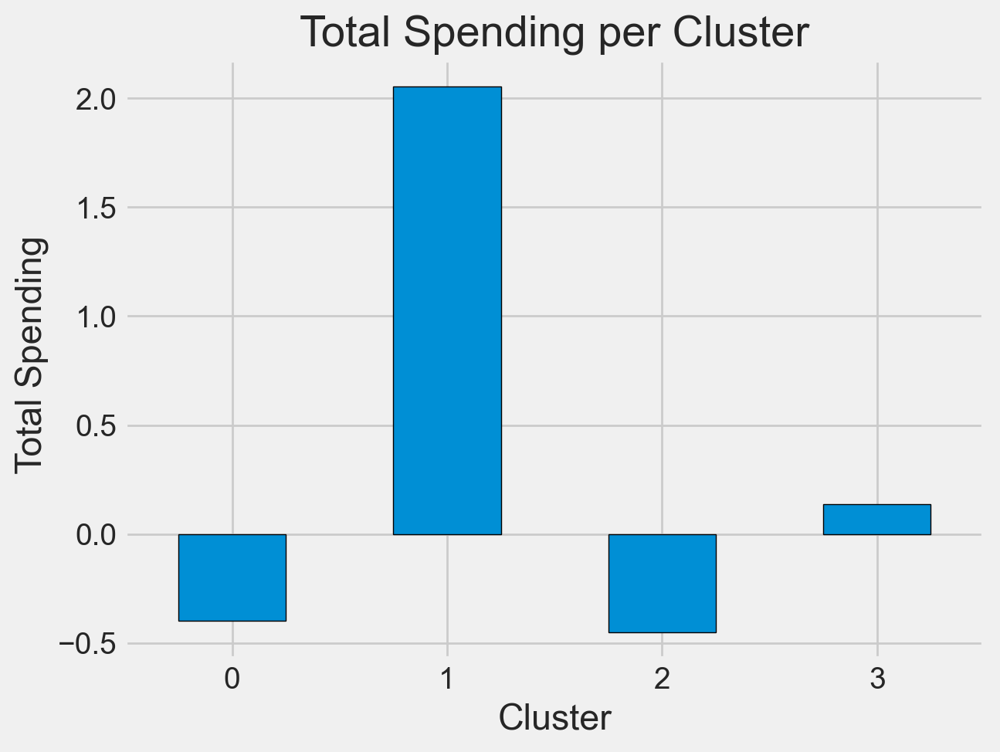

In [213]:
mean_spending = df.groupby('p2_labels')['Total Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Total Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel(' Total Spending')
plt.xticks(rotation=0)
plt.show()

### Average Spending

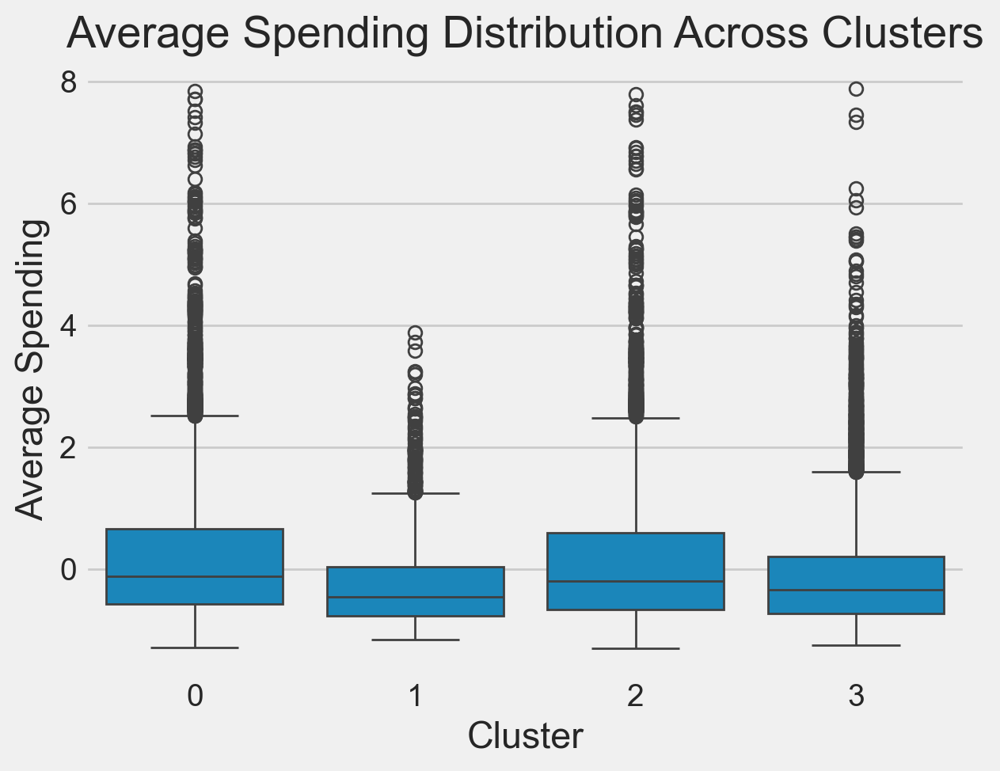

In [214]:
sns.boxplot(data=df, x='p2_labels', y='Average Spending')
plt.title('Average Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.show()

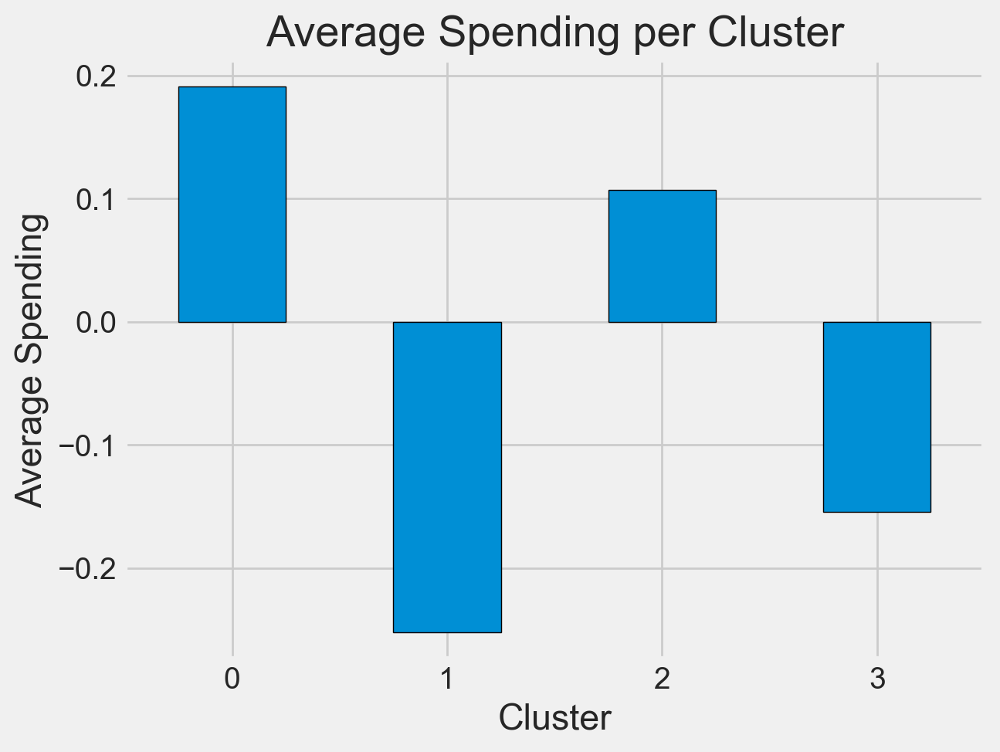

In [215]:
mean_spending = df.groupby('p2_labels')['Average Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Average Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.xticks(rotation=0)
plt.show()

### Cuisine Type Analysis

<Figure size 1200x800 with 0 Axes>

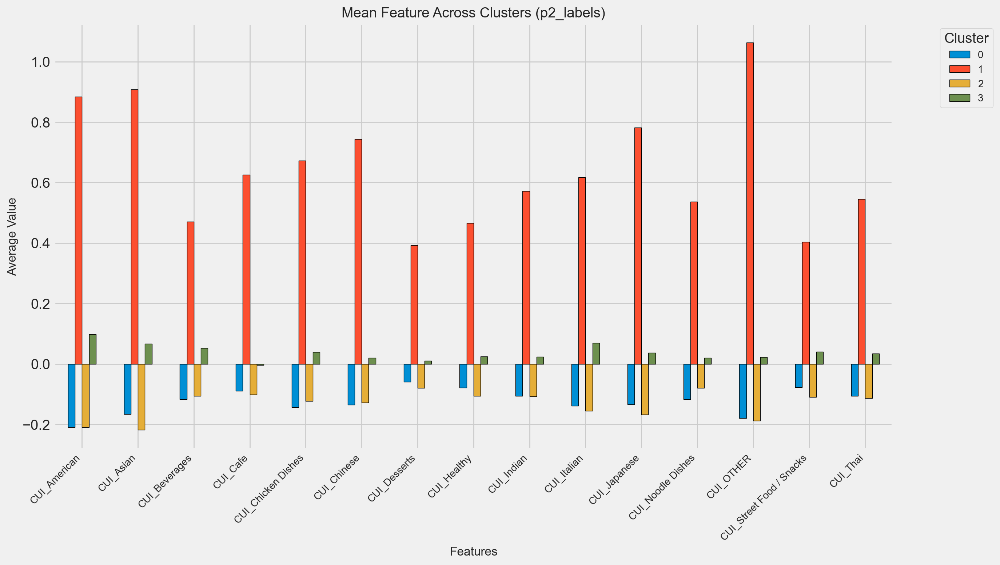

In [216]:
cuisine_columns = [
     'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p2_labels')[cuisine_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Mean Feature Across Clusters (p2_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

/var/folders/m0/h643h92s02b7_ptjdwmyydmr0000gn/T/ipykernel_61998/477989693.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='p2_labels', y=cuisine, palette='muted')
/var/folders/m0/h643h92s02b7_ptjdwmyydmr0000gn/T/ipykernel_61998/477989693.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='p2_labels', y=cuisine, palette='muted')
/var/folders/m0/h643h92s02b7_ptjdwmyydmr0000gn/T/ipykernel_61998/477989693.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='p2_labels', y=cuisine, palette='muted')
/var/folde

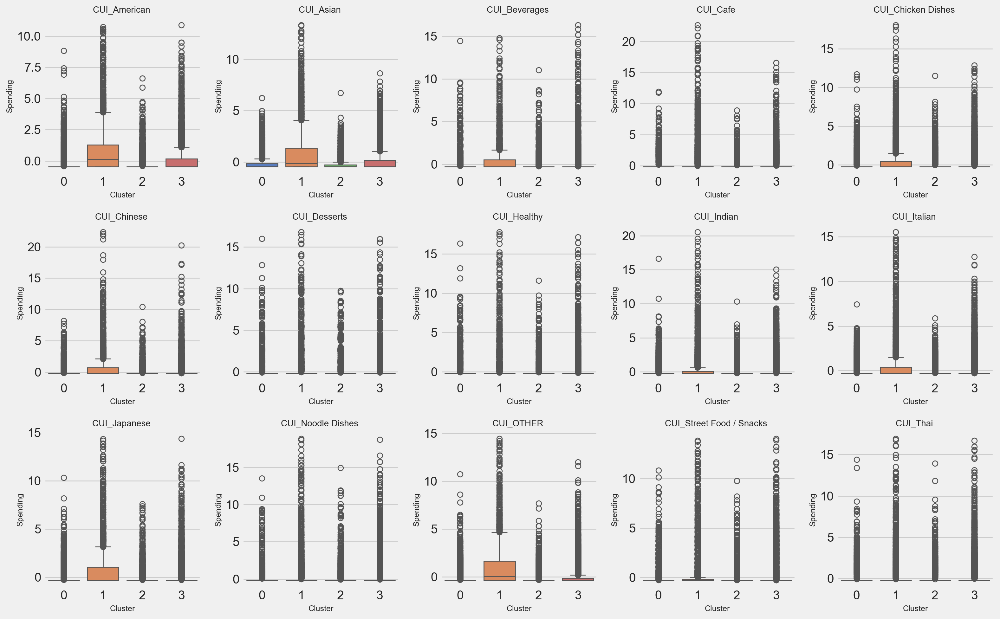

In [217]:
#Set figure size
plt.figure(figsize=(16, 10))

#Create a boxplot for each cuisine
for i, cuisine in enumerate(cuisine_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p2_labels', y=cuisine, palette='muted')
    plt.title(f'{cuisine} ', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  
plt.show()


### Other Features

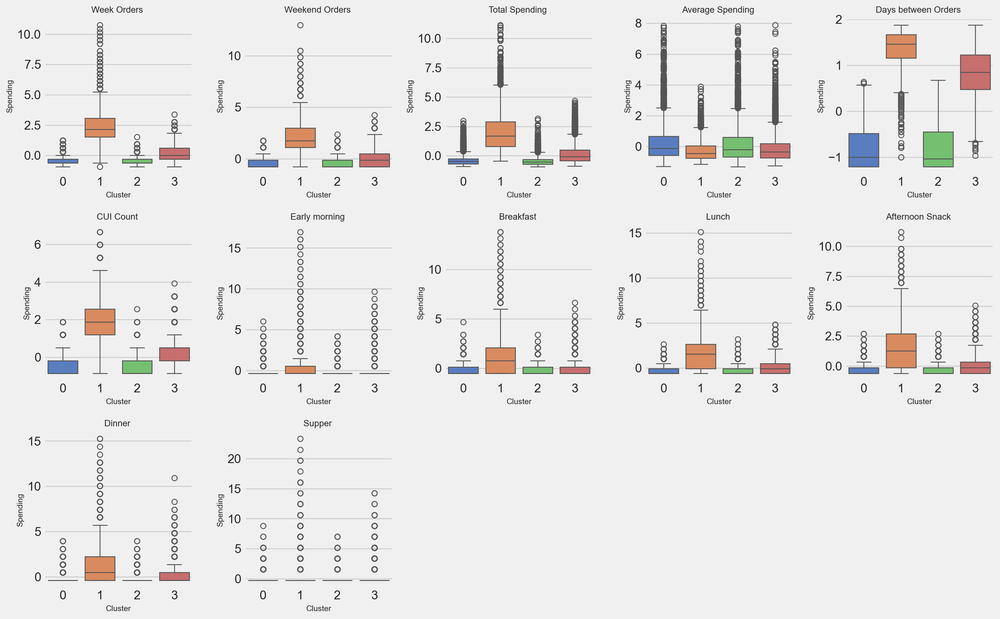

In [218]:
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
       'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
       'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',]

#Set figure size
plt.figure(figsize=(16, 10))

#Create a boxplot for each cuisine
for i, feature in enumerate(other_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p2_labels', y=feature, palette='muted', hue='p2_labels', legend=False),
    plt.title(f'{feature} ', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  
plt.show()

<Figure size 1200x800 with 0 Axes>

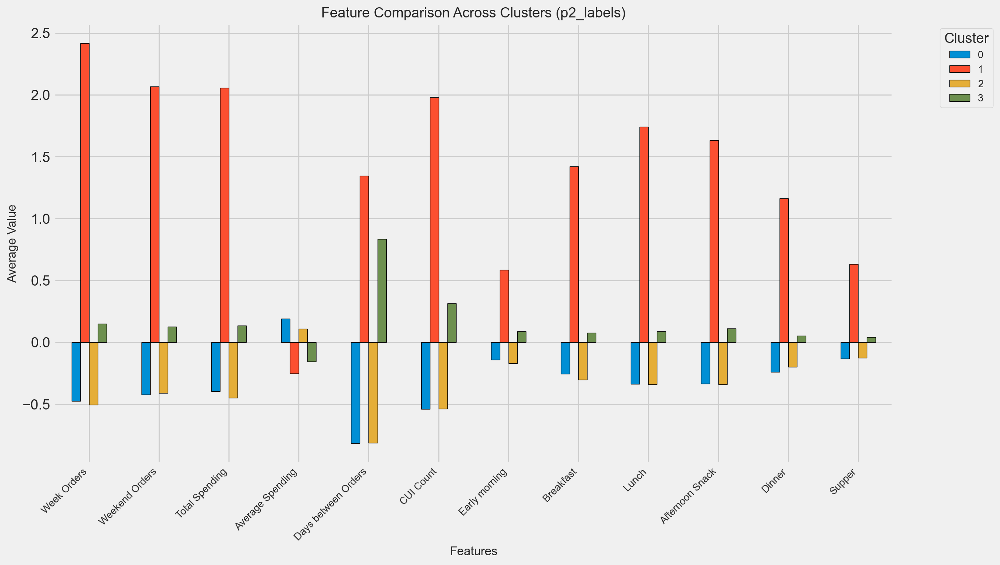

In [219]:
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
    'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
    'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p2_labels')[other_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (p2_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

### Customer Region Distribution

In [220]:
# Counts for customer_region by cluster
region_counts = df.groupby(['p2_labels', 'customer_region']).size().unstack(0)
print(region_counts)

p2_labels           0    1     2     3
customer_region                       
2360             2042  984  2394  3518
2440              309  149   379   633
2490              109   45   114   176
4140              351   29   210   261
4660             2722  819  2192  3728
8370              193   14   140   143
8550                8    1     1     3
8670             3011  585  2494  3590


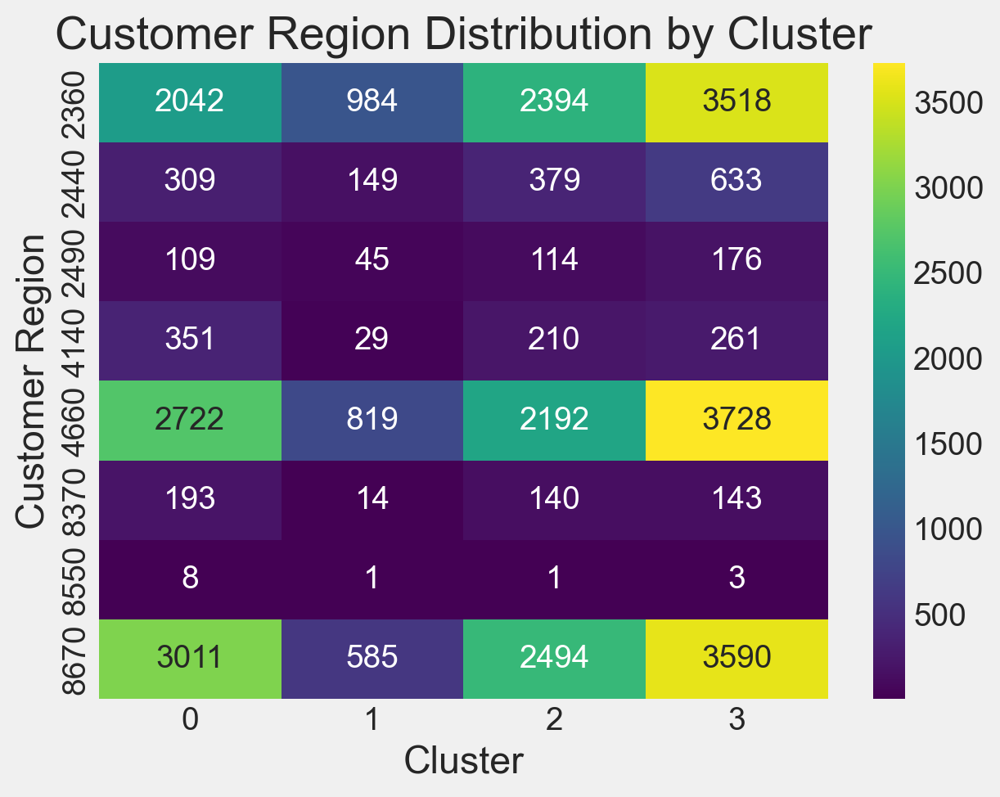

In [221]:
sns.heatmap(region_counts, annot=True, cmap='viridis', fmt='d')
plt.title('Customer Region Distribution by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Customer Region')
plt.show()

### Cluster Visualization

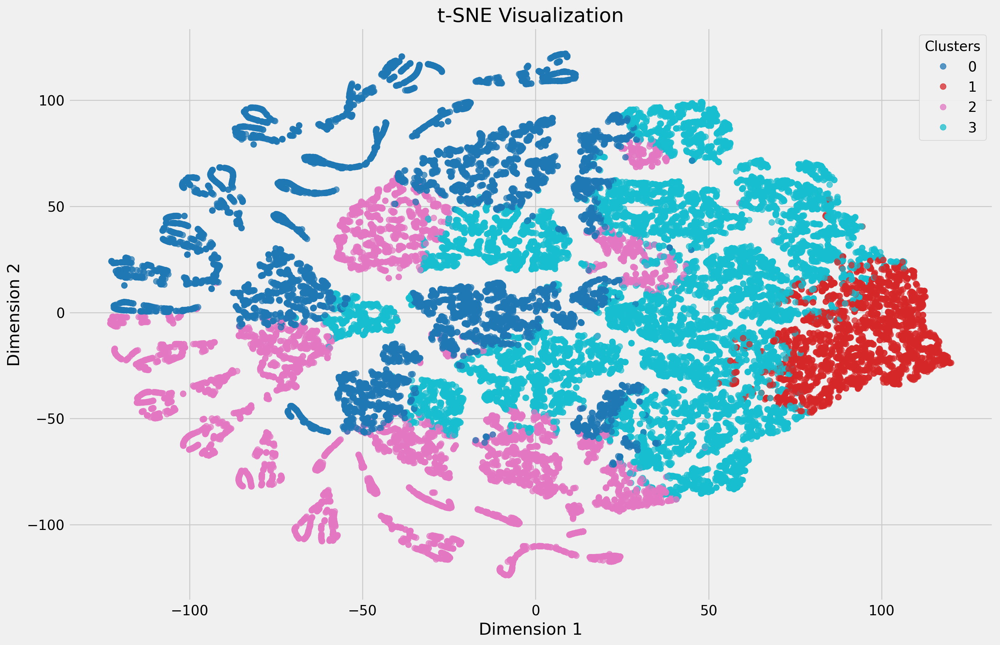

In [ ]:
plot_tsne(df, p2_feat, 'p2_labels', figsize=(15, 10), colormap='tab10')

______

> ## **5.3 Perspective 3:** Customer Preference <a class="anchor" id="p3"></a>

Remove some cuisines with low correlation.

In [223]:
p3_feat = [
       'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chinese', 'CUI_Desserts',
       'CUI_Indian', 'CUI_Italian',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
      ]

After testing various combinations of these features, the highest score was achieved using the following set:

In [224]:
p3_feat = ['CUI_Asian', 
           'CUI_Cafe',
           'CUI_Desserts', 
           'CUI_Italian', 
           'CUI_OTHER', 
           'CUI_Street Food / Snacks', 
           'CUI_Thai',
      ]


Exact R² Scores:
                          R²
Number of Clusters          
2                   0.119512
3                   0.234796
4                   0.321592
5                   0.406131
6                   0.485800
7                   0.556032
8                   0.623349
9                   0.648471


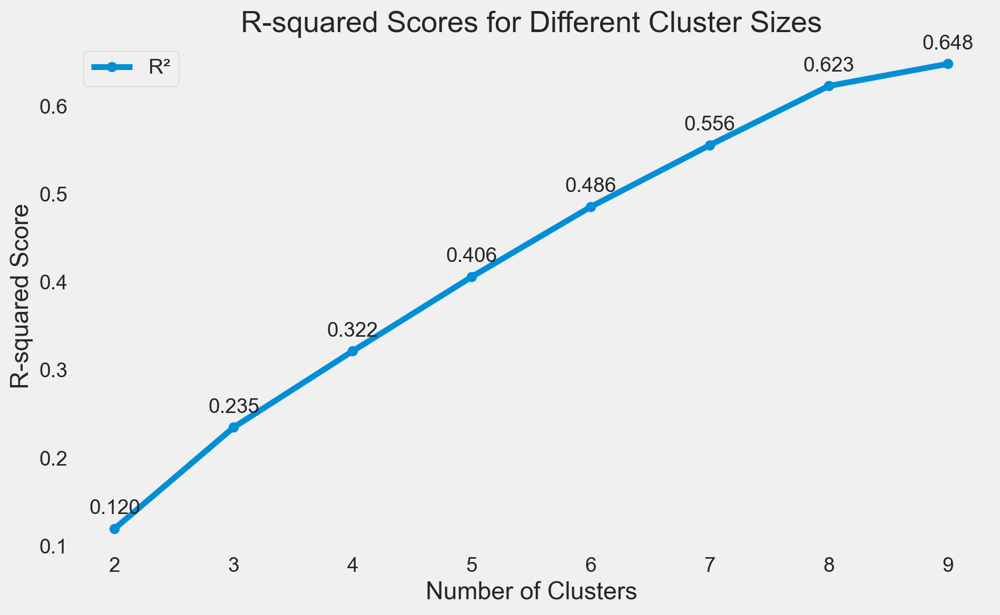

In [225]:
plot_r2_scores(df, p3_feat)


Davies-Bouldin Scores:
   Number of Clusters  Davies-Bouldin Score
0                   2              1.615089
1                   3              1.775505
2                   4              1.549159
3                   5              1.341923
4                   6              1.152116
5                   7              0.957121


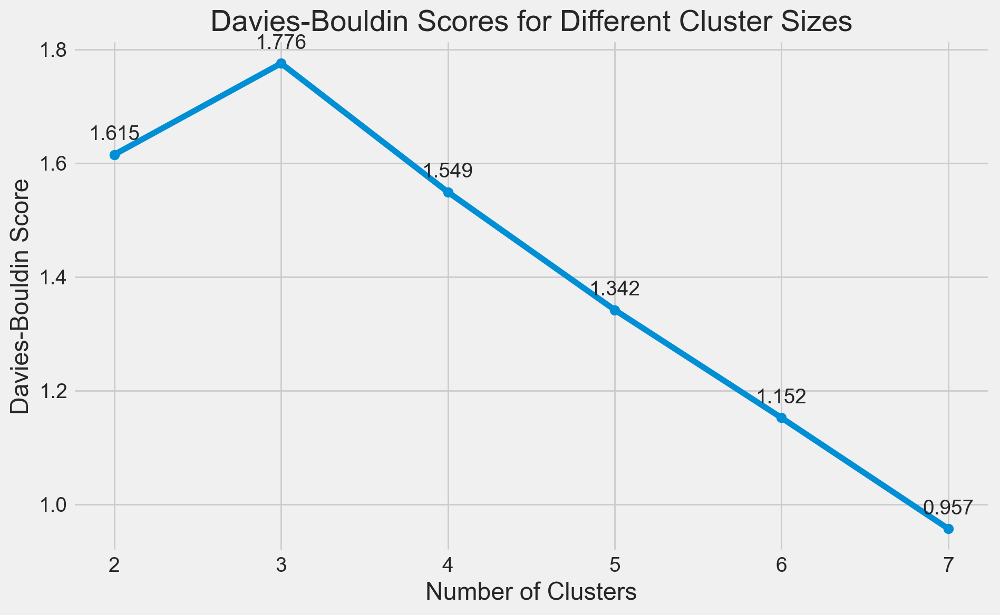

In [226]:
dbs_plot(df, p3_feat, max_clusters=7)


Silhouette Coefficients:
   Number of Clusters  Silhouette Coefficient
0                   2                0.581428
1                   3                0.615452
2                   4                0.580298
3                   5                0.583998
4                   6                0.572629
5                   7                0.566816


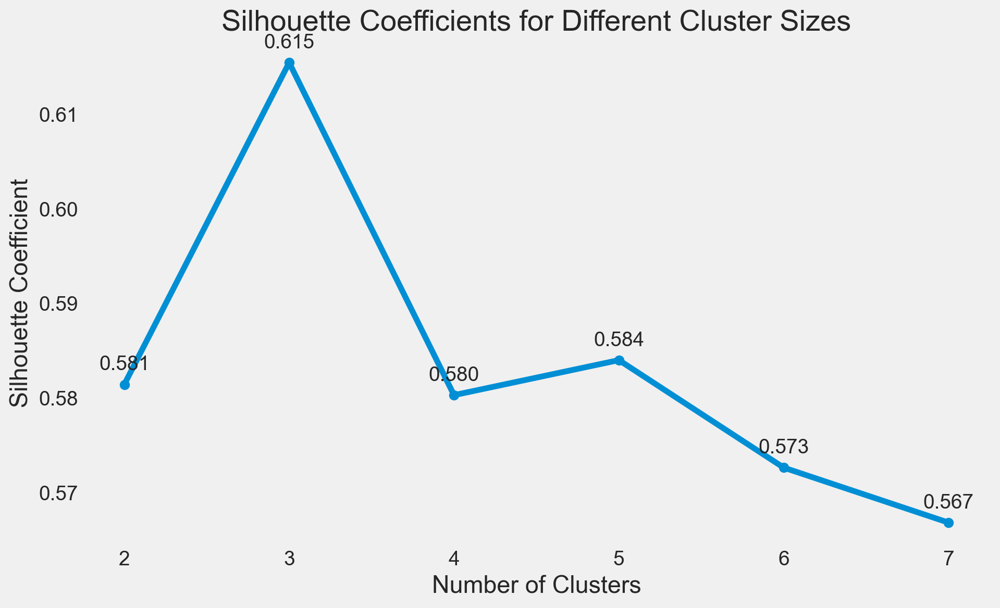

In [227]:
silhoutte_plot(df, p3_feat, max_clusters=7)

> ### 5.3.3 Applying K-Means <a class="anchor" id="kmeans_p3"></a>

In [228]:
kmeans_p3 = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=42)
cluster_labels_p3 = kmeans_p3.fit_predict(df[p3_feat])
centroids = kmeans_p3.cluster_centers_

In [229]:
df['p3_labels'] = cluster_labels_p3

> ### 5.3.4 Cluster Analysis <a class="anchor" id="analysis_p3"></a>

### Cluster Feature Profiling

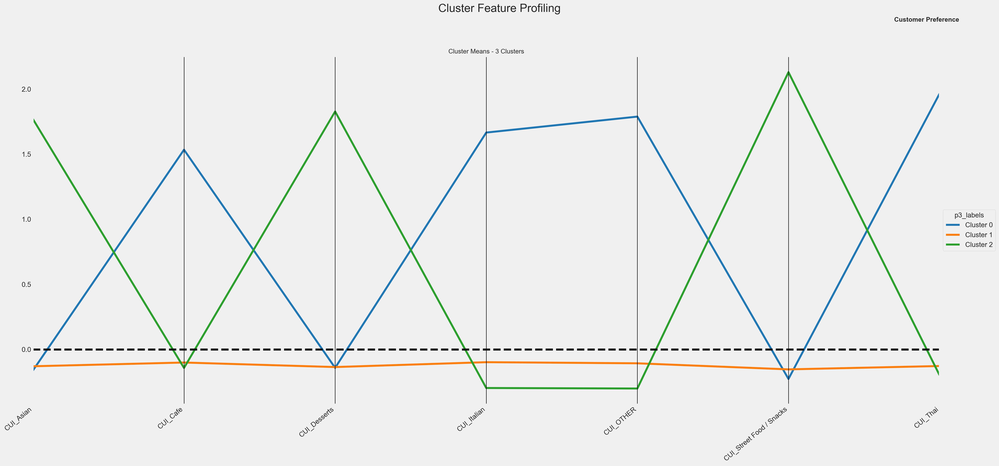

In [230]:
cluster_profiles(
    df = df[p3_feat + ['p3_labels']], 
    label_columns = ['p3_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Customer Preference", ]
)

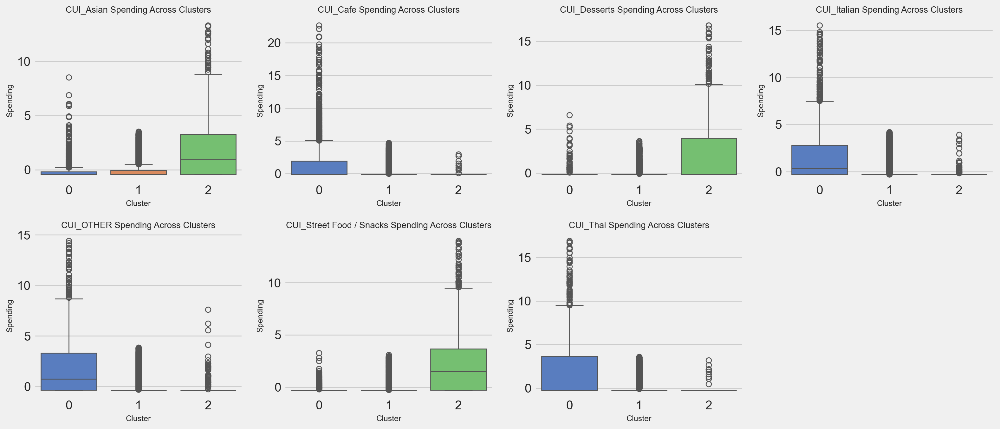

In [231]:
# Define cuisines
cuisine_columns = [
    'CUI_Asian',
           'CUI_Cafe', 
           'CUI_Desserts', 
           'CUI_Italian',
           'CUI_OTHER',
           'CUI_Street Food / Snacks', 
           'CUI_Thai'
]

# Set figure size
plt.figure(figsize=(16, 10))

# Create a boxplot for each cuisine
for i, cuisine in enumerate(cuisine_columns, 1):
    plt.subplot(3, 4, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p3_labels', y=cuisine, palette='muted', hue='p3_labels', legend=False),
    plt.title(f'{cuisine} Spending Across Clusters', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

### Cluster Cardinality

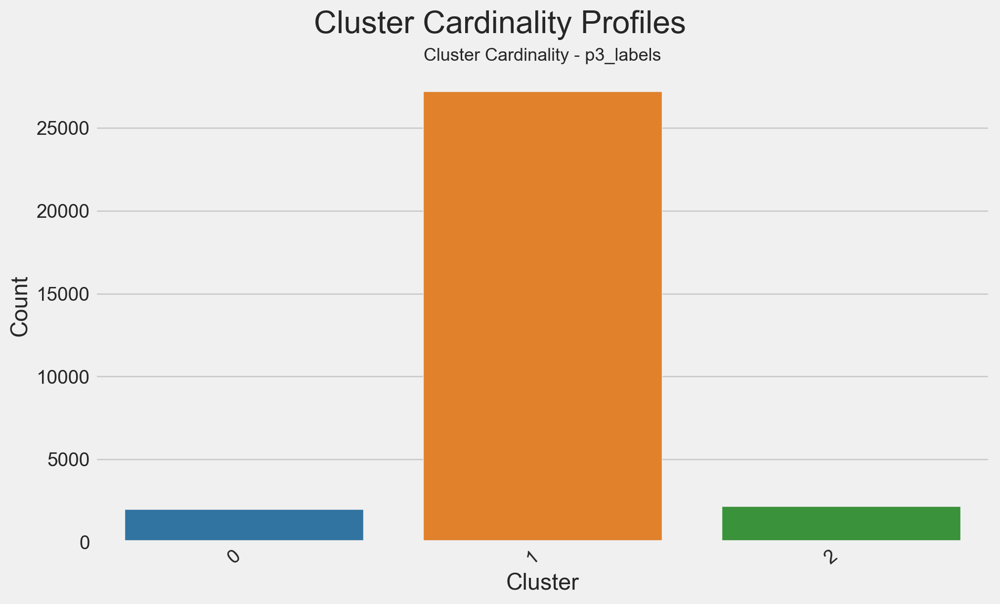

In [232]:
plot_cluster_cardinality(df, ['p3_labels'], figsize=(10, 6))

In [233]:
df['p3_labels'] = cluster_labels_p3  # Replace with actual cluster labels
cluster_summary = count_cluster_members(df, 'p3_labels')
print(cluster_summary)

   Cluster  Member_Count
0        0          1980
1        1         27203
2        2          2164


### Total Spending

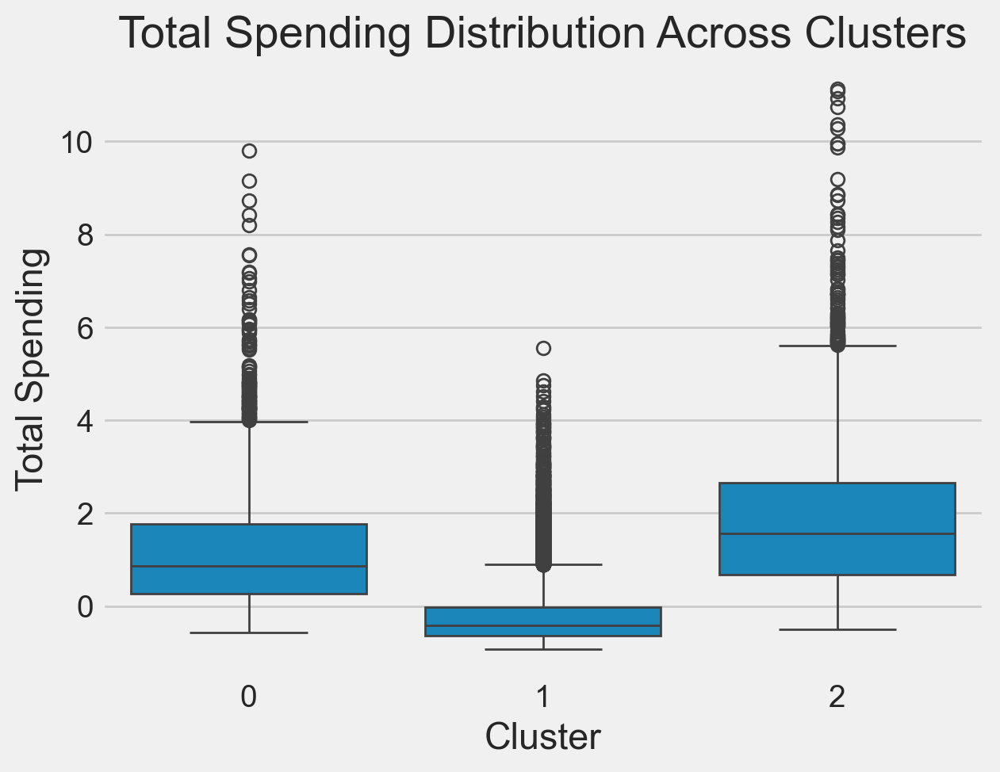

In [234]:
sns.boxplot(data=df, x='p3_labels', y='Total Spending')
plt.title('Total Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Total Spending')
plt.show()

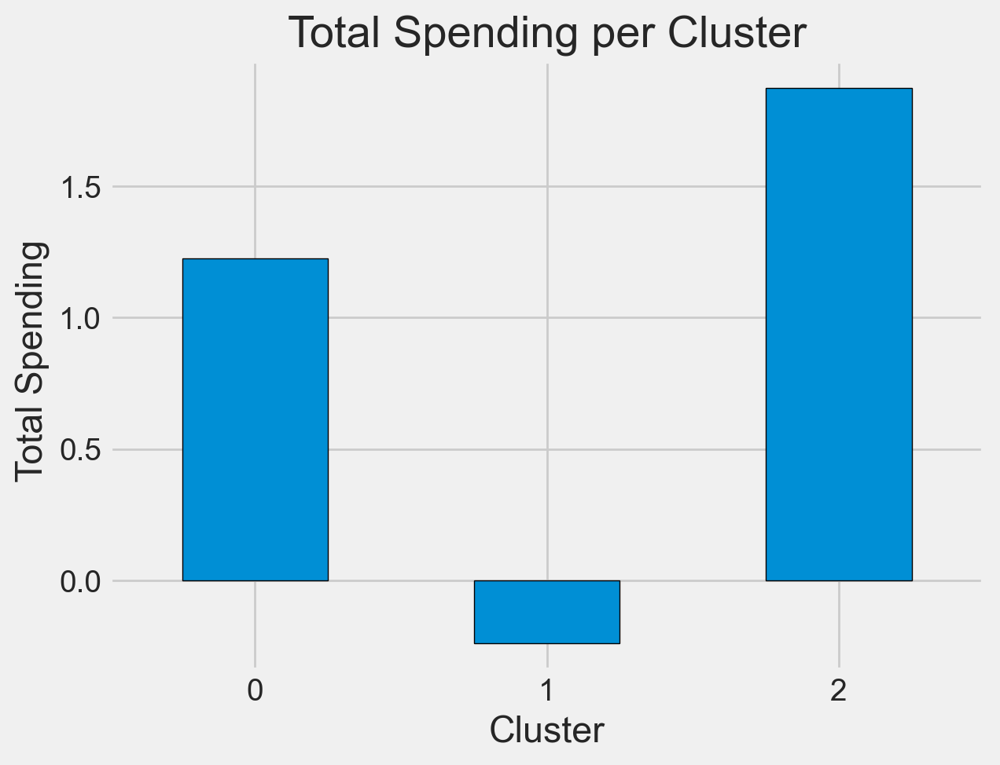

In [235]:
mean_spending = df.groupby('p3_labels')['Total Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Total Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel(' Total Spending')
plt.xticks(rotation=0)
plt.show()

### Average Spending

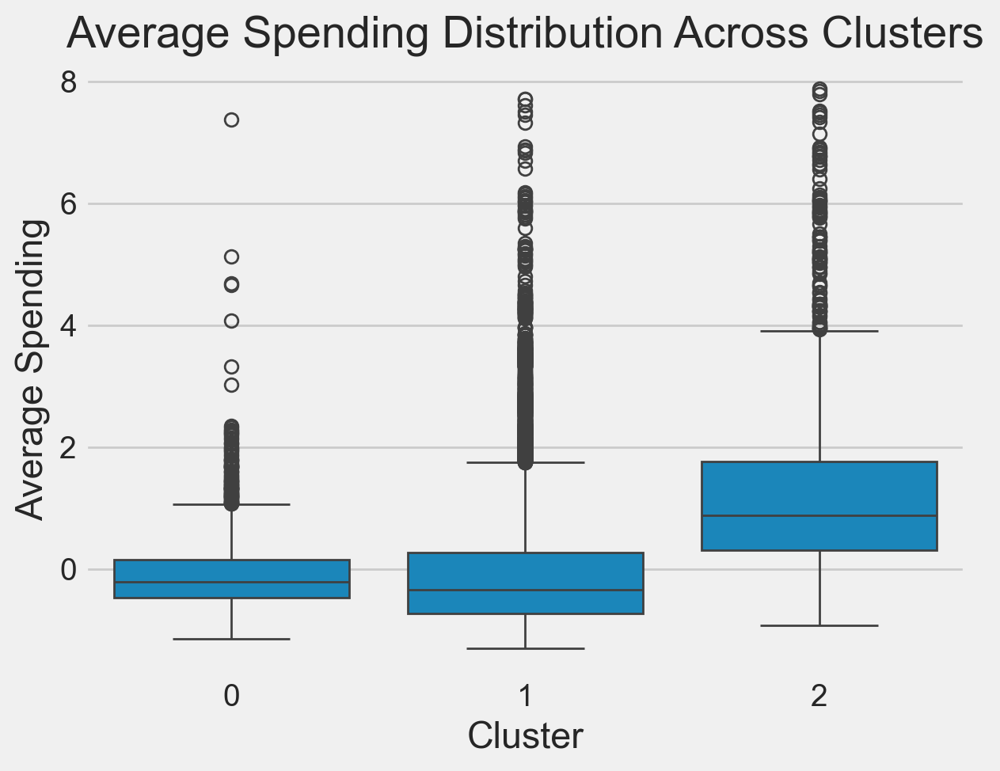

In [236]:
sns.boxplot(data=df, x='p3_labels', y='Average Spending')
plt.title('Average Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.show()

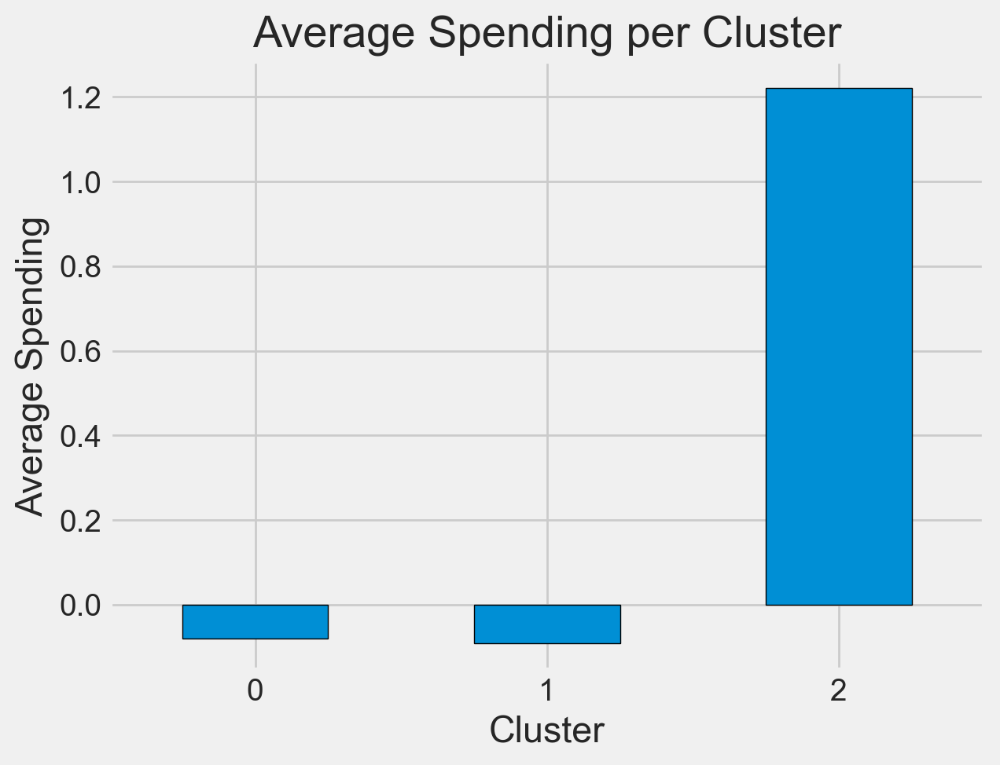

In [237]:
mean_spending = df.groupby('p3_labels')['Average Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Average Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.xticks(rotation=0)
plt.show()

### Cuisine Analysis

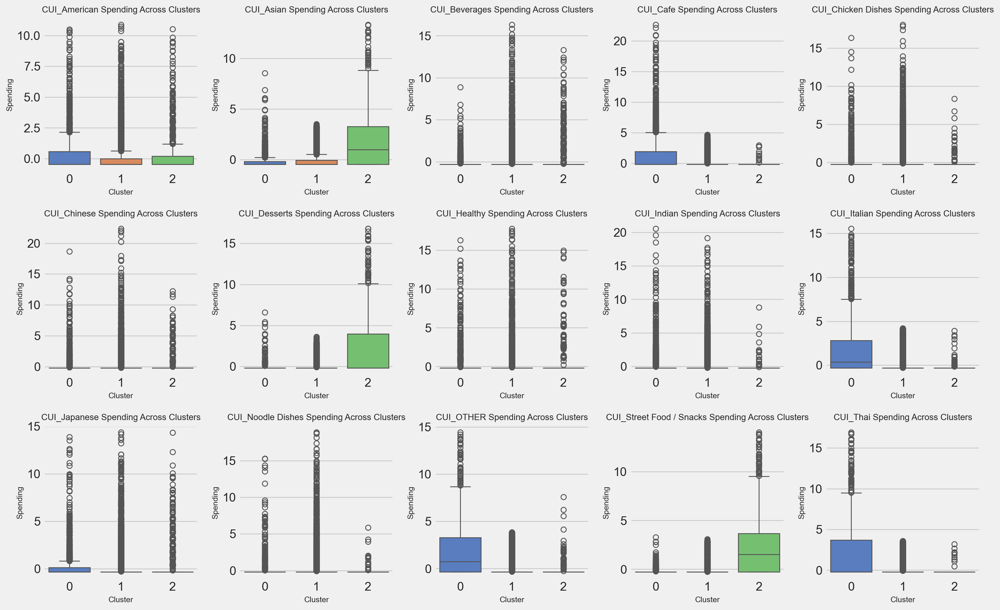

In [238]:
# Define cuisines
cuisine_columns = [
    'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Set figure size
plt.figure(figsize=(16, 10))

# Create a boxplot for each cuisine
for i, cuisine in enumerate(cuisine_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p3_labels', y=cuisine, palette='muted', hue='p3_labels', legend=False),
    plt.title(f'{cuisine} Spending Across Clusters', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

<Figure size 1200x800 with 0 Axes>

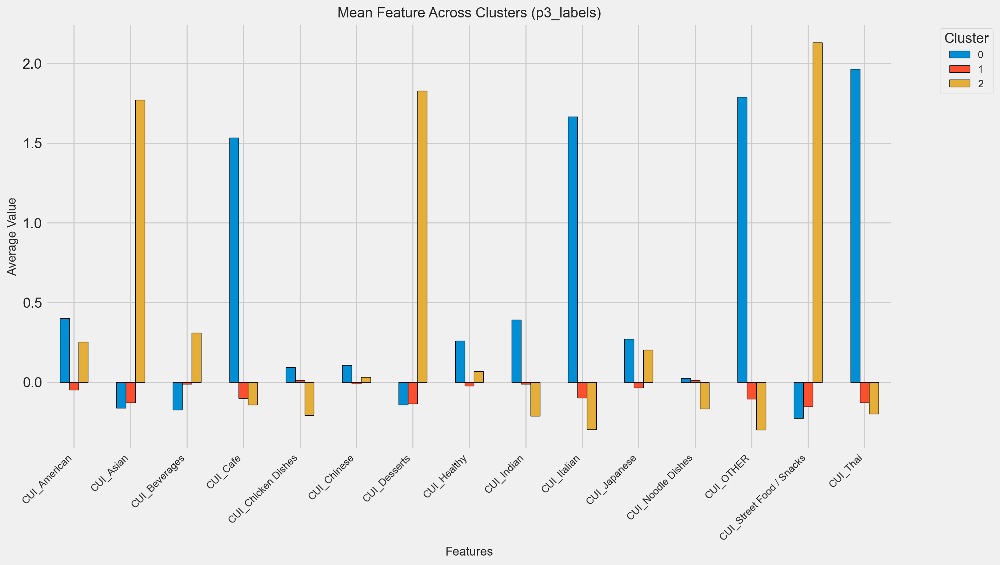

In [239]:
cuisine_columns = [
     'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p3_labels')[cuisine_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Mean Feature Across Clusters (p3_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

### Other Features

<Figure size 1200x800 with 0 Axes>

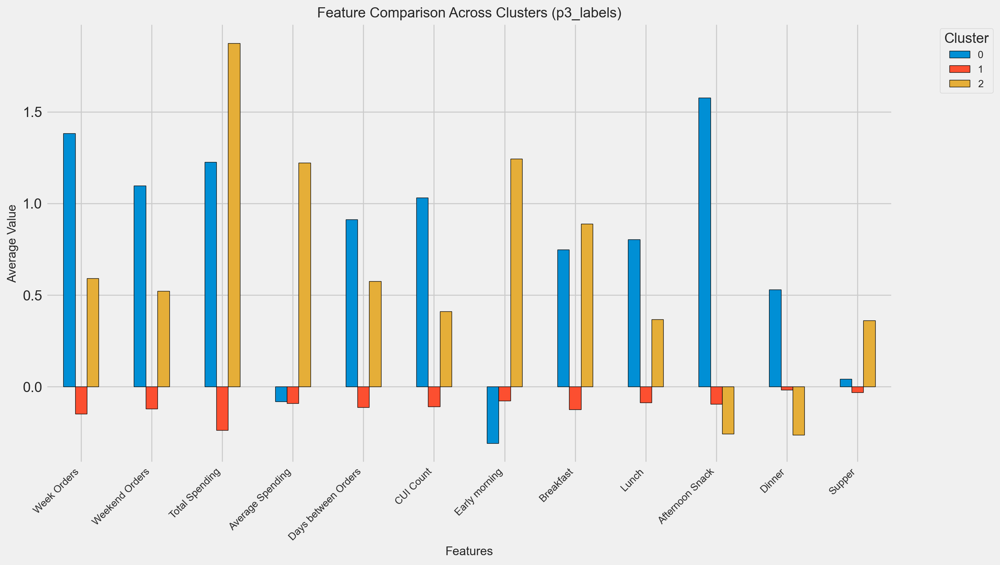

In [240]:
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
    'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
    'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('p3_labels')[other_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (p3_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

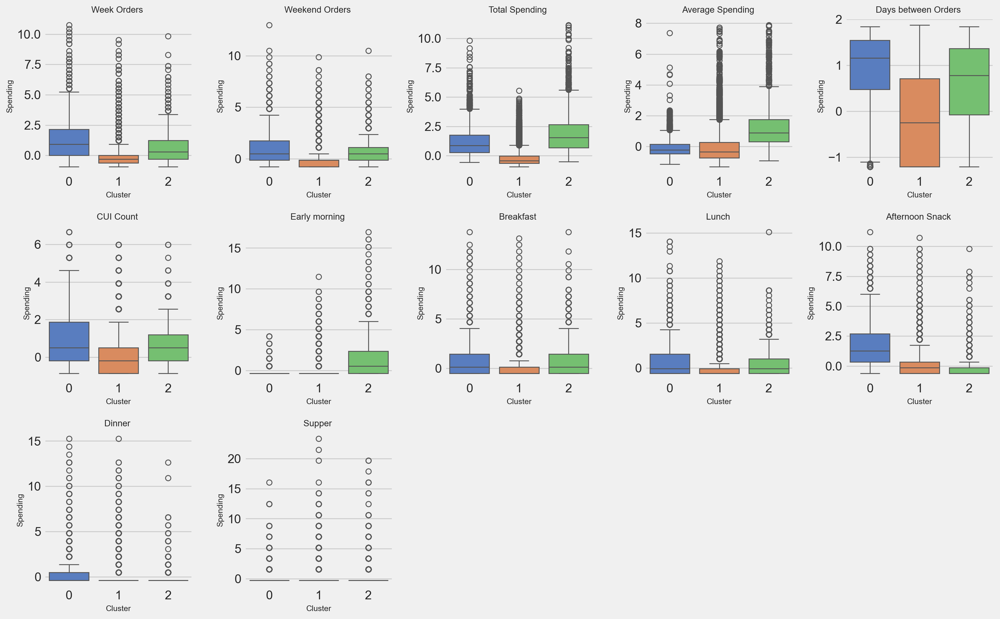

In [241]:
#Set figure size
plt.figure(figsize=(16, 10))

for i, cuisine in enumerate(other_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='p3_labels', y=cuisine, palette='muted', hue='p3_labels', legend=False),
    plt.title(f'{cuisine} ', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  
plt.show()

### Customer Region Distribution

In [242]:
# Counts for customer_region by cluster
region_counts = df.groupby(['p3_labels', 'customer_region']).size().unstack(0)
print(region_counts)

p3_labels             0       1       2
customer_region                        
2360              314.0  8536.0    88.0
2440               36.0  1424.0    10.0
2490               16.0   428.0     NaN
4140              110.0   735.0     6.0
4660             1498.0  7915.0    48.0
8370                NaN   399.0    91.0
8550                NaN    12.0     1.0
8670                6.0  7754.0  1920.0


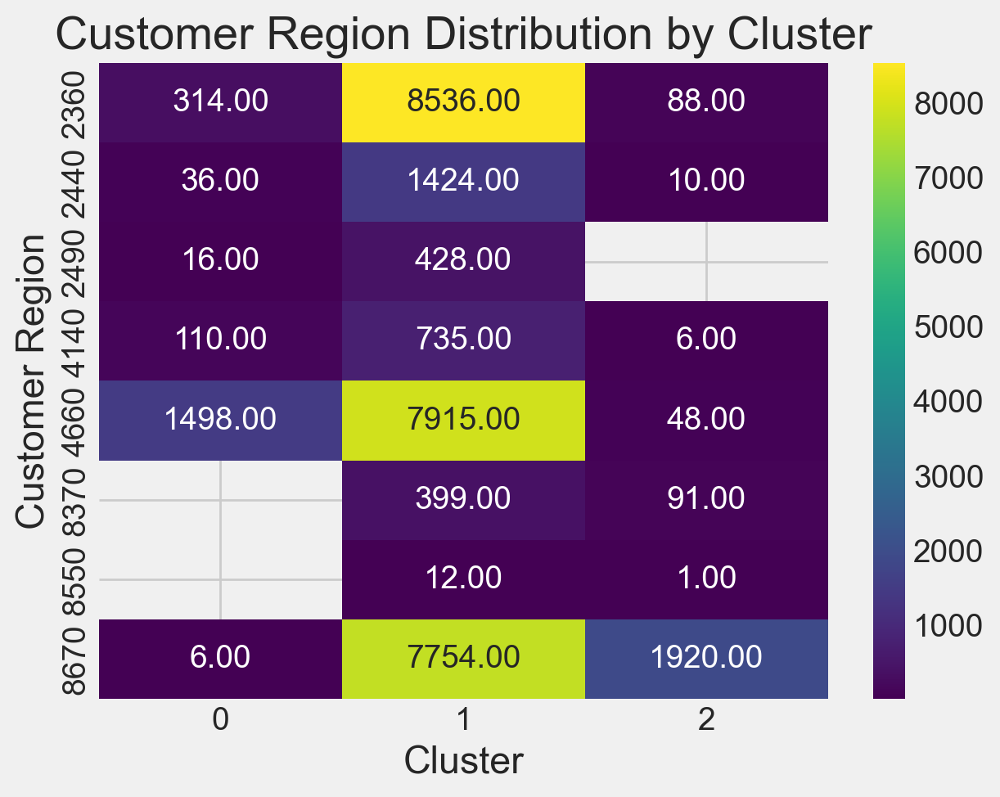

In [243]:
sns.heatmap(region_counts, annot=True, cmap='viridis', fmt='.2f')
plt.title('Customer Region Distribution by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Customer Region')
plt.show()

### Cluster Visualization

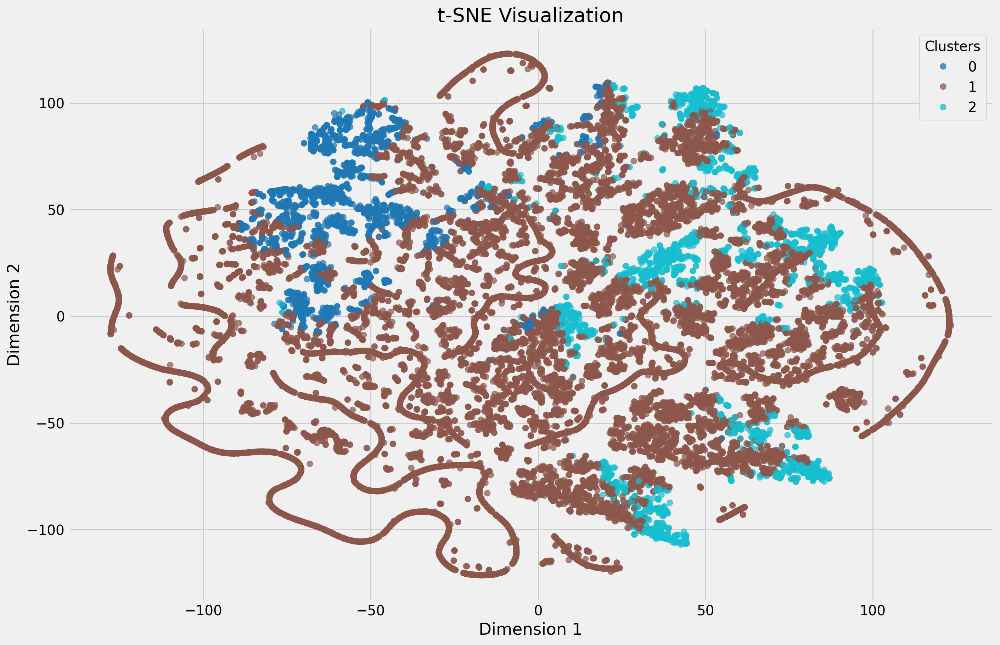

In [ ]:
plot_tsne(df, p3_feat, 'p3_labels', figsize=(15, 10), colormap='tab10')

_____

> ## 5.4 Merging Perspectives <a class="anchor" id="merging"></a>

In [245]:
features = p1_feat + p2_feat + p3_feat

features = list(set(features))

In [246]:
features

['CUI_Italian',
 'CUI_Thai',
 'CUI Count',
 'CUI_Cafe',
 'last_order',
 'CUI_Asian',
 'Days between Orders',
 'CUI_Desserts',
 'first_order',
 'CUI_OTHER',
 'Week Orders',
 'Total Orders',
 'Weekend Orders',
 'Total Spending',
 'CUI_Street Food / Snacks']

In [247]:
df_centroids = df.groupby(['p1_labels', 'p2_labels', 'p3_labels'])\
    [features].mean()
df_centroids

CUI_Italian  CUI_Thai  CUI Count  CUI_Cafe  \
p1_labels p2_labels p3_labels                                               
0         0         0             0.404556  2.238391  -0.312735  1.362338   
                    1            -0.143530 -0.147020  -0.548277 -0.111241   
                    2            -0.312708 -0.208591  -0.412966 -0.150614   
          1         0             0.171703 -0.208591   1.869874  2.786281   
                    1             0.190778  0.124502   2.898170  0.703401   
                    2            -0.312708  2.144551   1.184343  0.507379   
          2         1            -0.312708 -0.208591  -0.186718 -0.150614   
          3         0             0.792151  2.723435   0.755886  1.325762   
                    1            -0.024433 -0.084708   0.633230 -0.068584   
                    2            -0.312708 -0.208591   0.404720 -0.150614   
1         0         0            -0.107273  4.868058  -0.700866 -0.150614   
                    1            -0.107298 -0.119496  -0.555659 -0.117250   
                    2            -0.312708 -0.208591  -0.700866 -0.150614   
          1         0             1.256901  1.885578   1.666754  1.913203   
                    1            -0.068863 -0.006519   2.098384  0.025524   
                    2            -0.308576 -0.201246   1.081679 -0.145187   
          2         0             0.642059  3.238923  -0.872249 -0.150614   
                    1            -0.031171 -0.186872  -0.577133 -0.110755   
          3         0             1.601945  1.851834   0.414387  1.170849   
                    1            -0.029295 -0.103341   0.277452 -0.092017   
                    2            -0.311952 -0.208591   0.317201 -0.150614   
2         0         1             0.328640 -0.160971  -0.685286 -0.150614   
                    2            -0.312708 -0.208591  -0.872249 -0.150614   
          1         1             0.305732 -0.208591   1.184343 -0.150614   
          2         0             0.172073  3.060633  -0.406606  0.770861   
                    1            -0.161030 -0.157189  -0.539407 -0.112017   
                    2            -0.312708 -0.208591  -0.442044 -0.149257   
          3         0             0.949684  2.165409   0.619788  1.075014   
                    1            -0.101127 -0.063021   0.739510 -0.105209   
                    2            -0.312708 -0.208591   0.428502 -0.150614   
3         1         0             2.267034  1.877559   2.207865  2.119561   
                    1             0.021817 -0.016652   2.230163 -0.028836   
                    2            -0.221188 -0.168973   1.407413 -0.105543   
          3         0             2.793296  1.127200   0.124886  0.845598   
                    1             0.093683 -0.097801   0.833009 -0.128003   
                    2            -0.312708 -0.091323   0.191505 -0.150614   

                               last_order  CUI_Asian  Days between Orders  \
p1_labels p2_labels p3_labels                                               
0         0         0            0.515918  -0.426524            -0.628720   
                    1            0.353930  -0.175626            -0.857370   
                    2            0.483376   0.224167            -0.764015   
          1         0            0.967480   0.310456            -0.470474   
                    1            0.814821   0.298500            -0.658658   
                    2            1.098330   5.151710            -0.795520   
          2         1           -0.602725   0.252745            -0.932381   
          3         0            0.640354  -0.349173            -0.196751   
                    1            0.573646   0.110966            -0.107690   
                    2            0.562955   1.549758            -0.221238   
1         0         0            0.427722  -0.448749             0.179618   
                    1            0.561764  -0.180117             0.203818   
                    2     

> ### 5.4.1 Applying Hierarchical Clustering <a class="anchor" id="hc_cluster"></a>

In [248]:
linkage = 'ward'
hclust = AgglomerativeClustering(
    linkage=linkage, 
    metric='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)

hclust_labels = hclust.fit_predict(df_centroids)

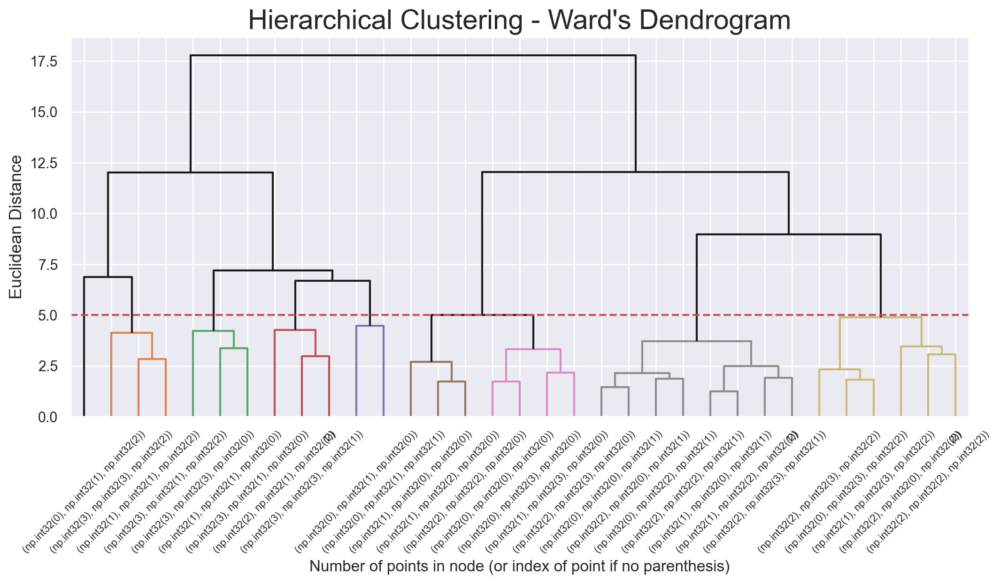

In [249]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned

y_threshold = 5
# y_threshold = 3.3

dendrogram(linkage_matrix, 
           truncate_mode='level', 
           labels=df_centroids.index, p=5, 
           color_threshold=y_threshold, 
           above_threshold_color='k')

plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [250]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    metric='euclidean', 
    n_clusters=5
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

CUI_Italian  CUI_Thai  CUI Count  CUI_Cafe  \
p1_labels p2_labels p3_labels                                               
0         0         0             0.404556  2.238391  -0.312735  1.362338   
                    1            -0.143530 -0.147020  -0.548277 -0.111241   
                    2            -0.312708 -0.208591  -0.412966 -0.150614   
          1         0             0.171703 -0.208591   1.869874  2.786281   
                    1             0.190778  0.124502   2.898170  0.703401   
                    2            -0.312708  2.144551   1.184343  0.507379   
          2         1            -0.312708 -0.208591  -0.186718 -0.150614   
          3         0             0.792151  2.723435   0.755886  1.325762   
                    1            -0.024433 -0.084708   0.633230 -0.068584   
                    2            -0.312708 -0.208591   0.404720 -0.150614   
1         0         0            -0.107273  4.868058  -0.700866 -0.150614   
                    1            -0.107298 -0.119496  -0.555659 -0.117250   
                    2            -0.312708 -0.208591  -0.700866 -0.150614   
          1         0             1.256901  1.885578   1.666754  1.913203   
                    1            -0.068863 -0.006519   2.098384  0.025524   
                    2            -0.308576 -0.201246   1.081679 -0.145187   
          2         0             0.642059  3.238923  -0.872249 -0.150614   
                    1            -0.031171 -0.186872  -0.577133 -0.110755   
          3         0             1.601945  1.851834   0.414387  1.170849   
                    1            -0.029295 -0.103341   0.277452 -0.092017   
                    2            -0.311952 -0.208591   0.317201 -0.150614   
2         0         1             0.328640 -0.160971  -0.685286 -0.150614   
                    2            -0.312708 -0.208591  -0.872249 -0.150614   
          1         1             0.305732 -0.208591   1.184343 -0.150614   
          2         0             0.172073  3.060633  -0.406606  0.770861   
                    1            -0.161030 -0.157189  -0.539407 -0.112017   
                    2            -0.312708 -0.208591  -0.442044 -0.149257   
          3         0             0.949684  2.165409   0.619788  1.075014   
                    1            -0.101127 -0.063021   0.739510 -0.105209   
                    2            -0.312708 -0.208591   0.428502 -0.150614   
3         1         0             2.267034  1.877559   2.207865  2.119561   
                    1             0.021817 -0.016652   2.230163 -0.028836   
                    2            -0.221188 -0.168973   1.407413 -0.105543   
          3         0             2.793296  1.127200   0.124886  0.845598   
                    1             0.093683 -0.097801   0.833009 -0.128003   
                    2            -0.312708 -0.091323   0.191505 -0.150614   

                               last_order  CUI_Asian  Days between Orders  \
p1_labels p2_labels p3_labels                                               
0         0         0            0.515918  -0.426524            -0.628720   
                    1            0.353930  -0.175626            -0.857370   
                    2            0.483376   0.224167            -0.764015   
          1         0            0.967480   0.310456            -0.470474   
                    1            0.814821   0.298500            -0.658658   
                    2            1.098330   5.151710            -0.795520   
          2         1           -0.602725   0.252745            -0.932381   
          3         0            0.640354  -0.349173            -0.196751   
                    1            0.573646   0.110966            -0.107690   
                    2            0.562955   1.549758            -0.221238   
1         0         0            0.427722  -0.448749             0.179618   
                    1            0.561764  -0.180117             0.203818   
                    2     

In [251]:
# # Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()
cluster_mapper

{(0, 0, 0): 2,
 (0, 0, 1): 4,
 (0, 0, 2): 3,
 (0, 1, 0): 0,
 (0, 1, 1): 0,
 (0, 1, 2): 1,
 (0, 2, 1): 4,
 (0, 3, 0): 2,
 (0, 3, 1): 4,
 (0, 3, 2): 3,
 (1, 0, 0): 2,
 (1, 0, 1): 4,
 (1, 0, 2): 3,
 (1, 1, 0): 0,
 (1, 1, 1): 0,
 (1, 1, 2): 1,
 (1, 2, 0): 2,
 (1, 2, 1): 4,
 (1, 3, 0): 2,
 (1, 3, 1): 4,
 (1, 3, 2): 3,
 (2, 0, 1): 4,
 (2, 0, 2): 3,
 (2, 1, 1): 0,
 (2, 2, 0): 2,
 (2, 2, 1): 4,
 (2, 2, 2): 3,
 (2, 3, 0): 2,
 (2, 3, 1): 4,
 (2, 3, 2): 3,
 (3, 1, 0): 0,
 (3, 1, 1): 0,
 (3, 1, 2): 1,
 (3, 3, 0): 0,
 (3, 3, 1): 0,
 (3, 3, 2): 1}

In [252]:
df_ = df.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['p1_labels'], row['p2_labels'], row['p3_labels'])
    ], axis=1
)

df_ 

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,Total Orders,Missing HR 0,Week Orders,Weekend Orders,Total Spending,Average Spending,Days between Orders,CUI Count,Early morning,Breakfast,Lunch,Afternoon Snack,Dinner,Supper,Delivery Promo,Discount Promo,No Promo,Freebie Promo,Payment Digi,Payment Cash,Payment Card,p1_labels,p2_labels,p3_labels,merged_labels
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,-1.337426,-0.406440,-0.073418,-0.492775,-1.186899,-2.739948,-0.442968,-0.448749,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,4.040088,-0.312708,-0.33109,-0.183075,-0.342460,-0.267237,-0.208591,0.498544,-0.570543,-0.589072,-0.605336,-0.651600,-0.632106,0.293893,-0.164470,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,-0.336038,-0.387789,-0.414382,-0.384202,-0.377482,-0.368921,-0.395533,-0.421219,-0.426740,1.985754,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,-0.508173,0,-0.920891,0.491097,-0.196523,0.557127,-1.171889,-0.872249,-0.374475,-0.517085,-0.599365,0.322372,-0.386220,-0.246779,1,0,0,0,1,0,0,2,2,1,4
5d272b9dcb,8670,-1.478633,-0.406440,-0.591095,-0.207005,-1.186899,-2.739948,0.756549,-0.154908,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,-0.233082,-0.312708,-0.33109,-0.183075,-0.342460,-0.267237,-0.208591,0.498544,-0.570543,-0.589072,-0.605336,-0.651600,-0.632106,0.293893,-0.164470,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,-0.336038,0.848206,0.724959,-0.384202,-0.377482,-0.368921,-0.395533,-0.421219,-0.426740,-0.390783,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,-0.508173,0,-0.920891,0.491097,-0.442608,-0.080367,-1.171889,-0.186718,-0.374475,0.133437,-0.057635,-0.624536,-0.386220,-0.246779,0,1,0,0,1,0,0,2,2,1,4
f6d1b2ba63,4660,1.486710,-0.785729,-0.591095,-0.207005,-1.186899,-2.739948,0.417840,-0.448749,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,-0.233082,-0.312708,-0.33109,-0.183075,-0.342460,-0.267237,-0.208591,0.498544,-0.570543,-0.589072,-0.605336,-0.651600,-0.632106,0.293893,-0.164470,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,1.184207,-0.387789,0.724959,-0.384202,-0.377482,-0.368921,-0.395533,-0.421219,-0.426740,-0.390783,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,-0.508173,0,-0.920891,0.491097,-0.697346,-0.740275,-1.171889,-0.872249,-0.374475,0.133437,-0.057635,-0.624536,-0.386220,-0.246779,0,1,0,0,0,1,0,2,2,1,4
180c632ed8,4660,-0.207772,-0.406440,-0.418536,-0.492775,-1.186899,-2.696331,-0.442968,0.181239,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,2.409536,-0.312708,-0.33109,-0.183075,-0.342460,-0.267237,-0.208591,-0.571124,0.478789,-0.589072,-0.605336,-0.651600,-0.632106,0.293893,-0.164470,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,-0.336038,-0.387789,0.724959,-0.384202,-0.377482,1.403697,-0.395533,-0.421219,-0.426740,-0.390783,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,-0.508173,0,-0.613725,-0.133271,-0.128322,0.733806,-1.137674,-0.186718,-0.374475,-0.517085,0.484096,-0.624536,-0.386220,-0.246779,1,0,0,0,1,0,0,2,2,1,4
4eb37a6705,4660,-1.055012,-0.406440,-0.073418,-0.778545,-1.186899,-2.696331,0.920290,1.430640,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,-0.233082,-0.312708,-0.33109,-0.183075,-0.342460,-0.267237,-0.208591,-0.571124,0.478789,-0.589072,-0.605336,-0.651600,-0.632106,0.293893,-0.164470,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,1.871733,1.184207,-0.387789,-0.414382

In [253]:
# Merged cluster centroids
df_.groupby('merged_labels').mean(numeric_only=True)[features]

,CUI_Italian,CUI_Thai,CUI Count,CUI_Cafe,last_order,CUI_Asian,Days between Orders,CUI_Desserts,first_order,CUI_OTHER,Week Orders,Total Orders,Weekend Orders,Total Spending,CUI_Street Food / Snacks
merged_labels,,,,,,,,,,,,,,,
0,0.850192,0.698534,2.041257,0.770820,0.820749,0.070827,1.351571,-0.075895,-0.859363,1.344550,2.467930,2.571354,1.970215,1.470518,-0.173065
1,-0.255066,-0.172412,1.240077,-0.120016,0.812161,3.701756,1.293120,1.957934,-0.796569,-0.215461,2.024408,2.123010,1.653539,3.652012,2.329299
2,1.273959,2.066652,0.243285,1.142468,0.363734,-0.338666,0.549997,-0.182127,-0.321369,1.115014,0.269239,0.273692,0.196382,0.431084,-0.245176
3,-0.312242,-0.208591,0.080590,-0.150442,0.251702,1.002724,0.290294,1.775570,-0.112737,-0.333424,0.022420,0.043233,0.071896,1.167794,2.050269
4,-0.103707,-0.132717,-0.222122,-0.104089,-0.121333,-0.139890,-0.189201,-0.138685,0.114165,-0.139508,-0.275486,-0.288258,-0.223261,-0.303216,-0.152854


In [254]:
df = df_.copy()

In [255]:
df.to_csv('df_clustered.csv', )

In [256]:
#df = pd.read_csv('df_clustered.csv')

_______

> ## 5.5 Predicting Outliers <a class="anchor" id="pred_outliers"></a>

In [257]:
X = df[features]
y = df['merged_labels']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

dt = DecisionTreeClassifier(random_state=42, max_depth=3)

dt.fit(X_train, y_train)
print(f"Accuracy on training set: {dt.score(X_train, y_train)}")

Accuracy on training set: 0.9320891653706583


In [258]:
df_outliers['merged_labels'] = dt.predict(df_outliers[features])
df_outliers.head()

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,Total Orders,Missing HR 0,Week Orders,Weekend Orders,Total Spending,Average Spending,Days between Orders,CUI Count,Early morning,Breakfast,Lunch,Afternoon Snack,Dinner,Supper,Delivery Promo,Discount Promo,No Promo,Freebie Promo,Payment Digi,Payment Cash,Payment Card,merged_labels
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
249ba584d3,4660,0.921882,0.352137,15.456896,1.507616,-1.186899,0.313228,-0.442968,40.786065,-0.291884,1.931119,-0.243252,-0.228502,-0.189971,-0.190037,-0.233082,-0.104888,-0.331090,-0.183075,-0.342460,-0.267237,-0.208591,7.986222,8.873450,8.742764,7.529045,9.299539,3.343141,4.879134,-0.16447,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,2.789435,-0.257734,-0.336038,-0.387789,3.003640,15.958864,17.758542,10.266787,10.011102,11.808062,2.944487,-0.390783,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,11.440880,0,11.365757,7.983516,22.172025,0.869904,1.223187,0.498812,-0.374475,0.133437,17.277751,8.844541,-0.386220,-0.246779,0,0,1,0,0,0,1,0
36269ce6f1,4660,-1.055012,0.352137,4.585677,1.221846,-1.186899,0.313228,-0.442968,-0.448749,-0.291884,-0.150614,-0.243252,-0.228502,-0.189971,-0.190037,-0.233082,13.837119,-0.331090,-0.183075,5.642289,-0.267237,-0.208591,10.125558,2.577454,3.558411,3.461854,3.328856,-0.632106,3.962086,-0.16447,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,-0.336038,0.848206,-0.414382,-0.384202,-0.377482,-0.368921,2.577792,5.693422,13.058169,9.115365,2.442582,-0.267902,-0.207792,-0.168345,-0.168083,5.925932,0,3.686602,8.607884,3.907525,-0.511076,1.223187,-0.186718,-0.374475,0.133437,-0.599365,12.158718,1.351148,-0.246779,0,0,1,0,0,0,1,0
1420df2a55,8670,-0.631392,1.869292,3.205204,0.936076,-1.186899,0.487695,0.124978,0.673734,1.397281,-0.150614,-0.243252,-0.228502,31.937825,-0.190037,-0.233082,-0.312708,-0.331090,-0.183075,-0.342460,6.881098,-0.208591,1.568212,2.577454,0.447799,2.445057,1.338628,-0.632106,2.127989,-0.16447,-0.170674,-0.186814,-0.238998,2.154315,-0.228931,2.992727,-0.217457,-0.257734,-0.336038,-0.387789,-0.414382,0.872957,-0.377482,3.176315,7.037778,2.024637,0.697002,0.797486,-0.329799,-0.267902,-0.207792,-0.168345,-0.168083,2.249301,0,1.843605,2.364202,6.211868,1.296805,1.360049,1.869874,0.538400,0.133437,1.025827,3.636549,-0.386220,-0.246779,0,0,1,0,0,1,0,1
61327c3c6c,4660,1.627916,4.903603,10.107566,6.937249,-1.186899,0.487695,0.774327,4.377790,-0.291884,45.035379,-0.243252,-0.228502,-0.189971,-0.190037,1.453695,4.117772,5.532960,-0.183075,4.744759,-0.267237,-0.208591,10.125558,5.725452,6.669023,1.428259,6.314198,3.343141,4.879134,-0.16447,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,6.199461,17.823895,4.001199,2.704453,4.556191,0.724959,0.872957,4.568706,-0.368921,1.091129,2.024637,7.439457,3.174023,9.373535,1.681928,-0.207792,-0.168345,-0.168083,8.683406,0,7.065430,9.232252,10.867126,0.108681,1.360049,3.240935,-0.374475,9.891267,2.109289,5.530364,6.563252,-0.246779,0,0,1,0,0,0,1,0
0f4619dcf4,4660,2.192743,4.145025,5.448472,1.507616,-1.186899,0.531312,0.143691,0.624530,-0.291884,32.189618,-0.243252,3.437310,-0.189971,-0.190037,-0.233082,6.865613,4.864222,-0.183075,1.537731,-0.267237,2.082767,1.568212,2.577454,2.521540,2.445057,0.343514,0.361706,5.796182,-0.16447,-0.170674,-0.186814,-0.238998,-0.238206,-0.228931,-0.214007,-0.217457,-0.257734,1.184207,5.792185,0.724959,2.130116,-0.377482,1.403697,1.091129,3.247565,1.820745,3.174023,1.056392,-0.267902,-0.207792,-0.168345,-0.168083,3.628038,0,2.457937,4.861675,7.544341,0.8489

In [259]:
# count the number of rows in each unique merged_label
df_outliers['merged_labels'].value_counts()

merged_labels
0    176
1     48
3     33
4     27
Name: count, dtype: int64

In [260]:
final_df = pd.concat([df, df_outliers], ignore_index=True)

## No outliers vs with outliers

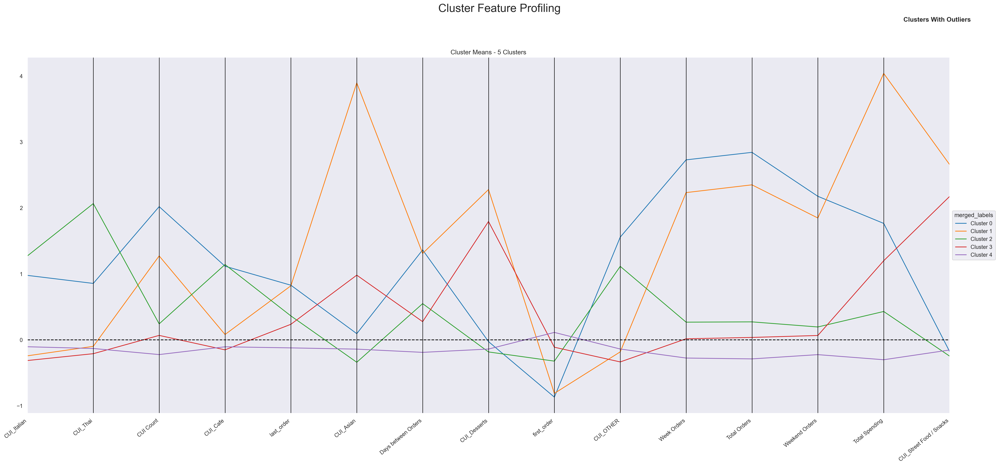

In [261]:
cluster_profiles(
    df = final_df[features + ['merged_labels']], 
    label_columns = ['merged_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Clusters With Outliers", ]
)

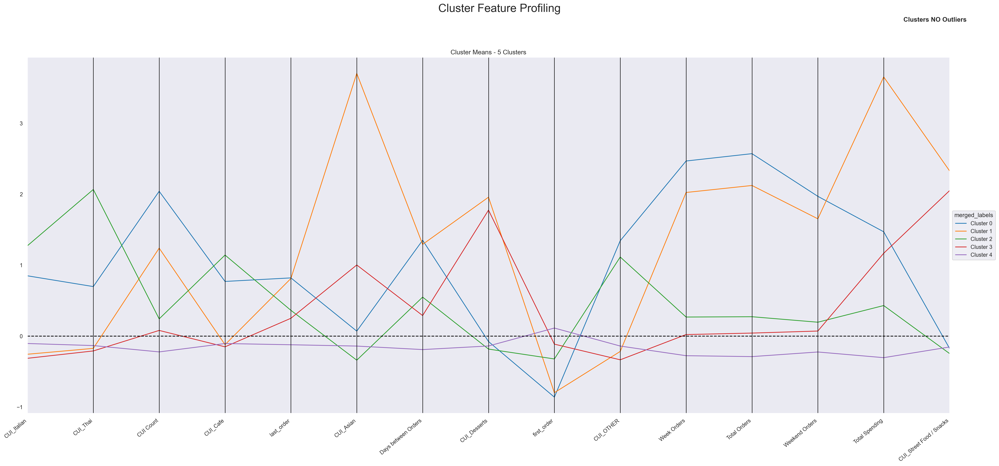

In [262]:
cluster_profiles(df=df[features + ['merged_labels']],label_columns = ['merged_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Clusters NO Outliers", ])

___

> ## 5.6 Final Solution <a class="anchor" id="final_solution"></a>

In [263]:
df = final_df.copy()

> ### 5.6.1 Cluster Analysis <a class="anchor" id="analysis_final"></a>

### Cluster Feature Profiling

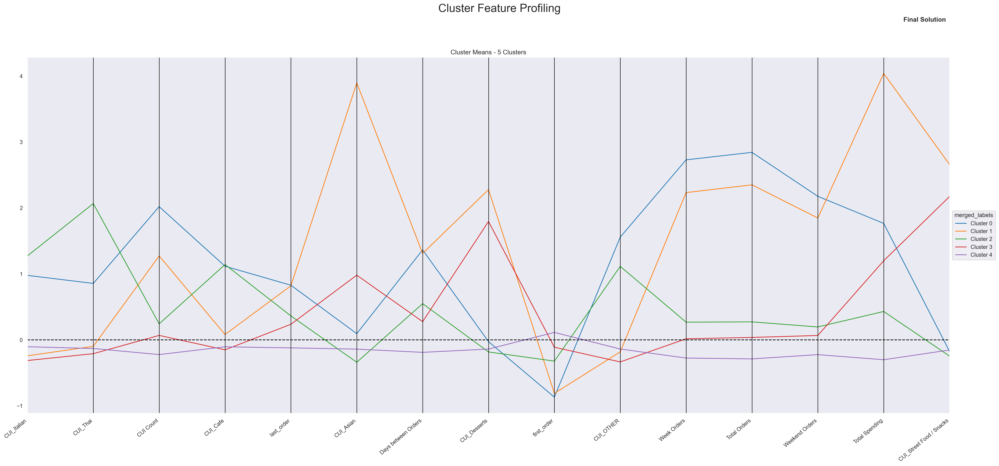

In [264]:
cluster_profiles(
    df = df[features + ['merged_labels']], 
    label_columns = ['merged_labels',], 
    figsize = (28, 13), 
    compare_titles = ["Final Solution", ]
)

### Cluster Cardinality

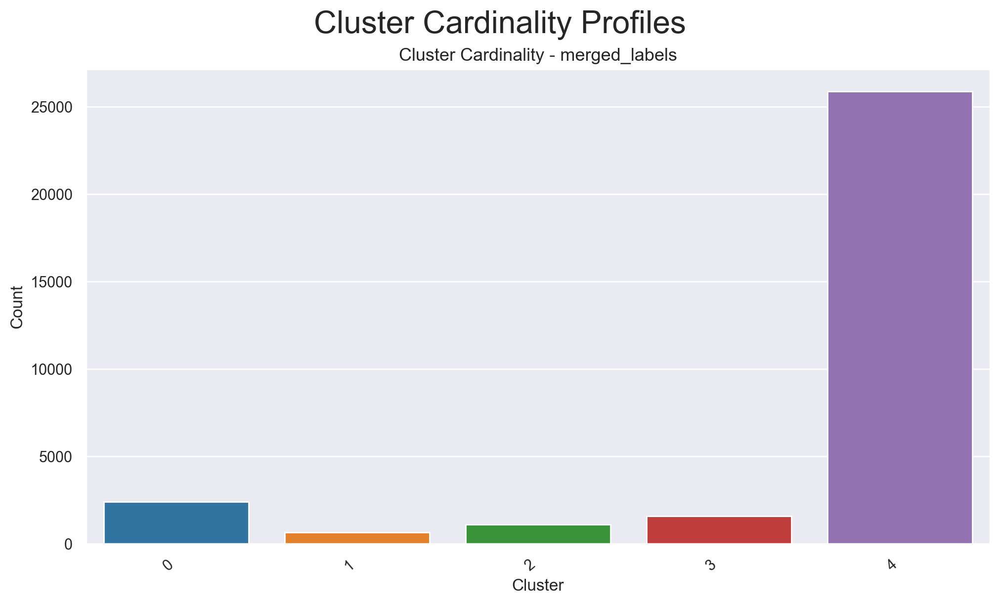

In [265]:
plot_cluster_cardinality(df,['merged_labels'], figsize=(10, 6))

In [266]:
def count_cluster_members(df, label_column):
    
    if label_column not in df.columns:
        raise ValueError(f"The column '{label_column}' does not exist in the DataFrame.")
    
    cluster_counts = df[label_column].value_counts().reset_index()
    cluster_counts.columns = ['Cluster', 'Member_Count']
    return cluster_counts.sort_values(by='Cluster').reset_index(drop=True)

In [267]:
# Replace with actual cluster labels
cluster_summary = count_cluster_members(df, 'merged_labels')
print(cluster_summary)

   Cluster  Member_Count
0        0          2420
1        1           663
2        2          1108
3        3          1582
4        4         25858


### Total Spending

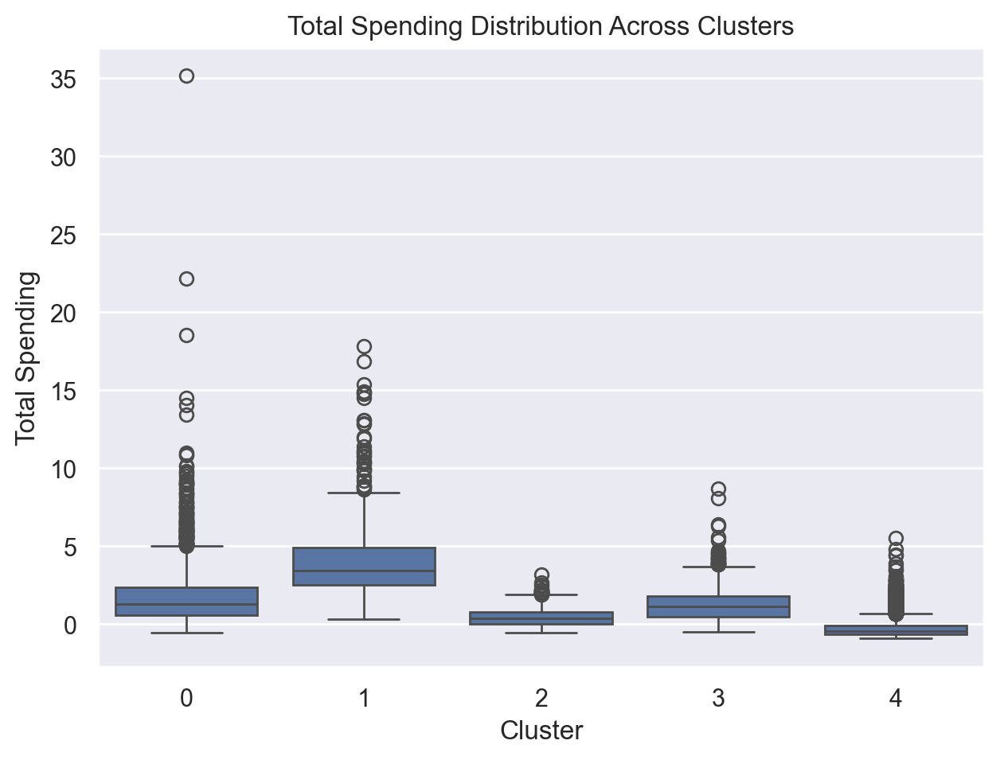

In [268]:
sns.boxplot(data=df, x='merged_labels', y='Total Spending')
plt.title('Total Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Total Spending')
plt.show()

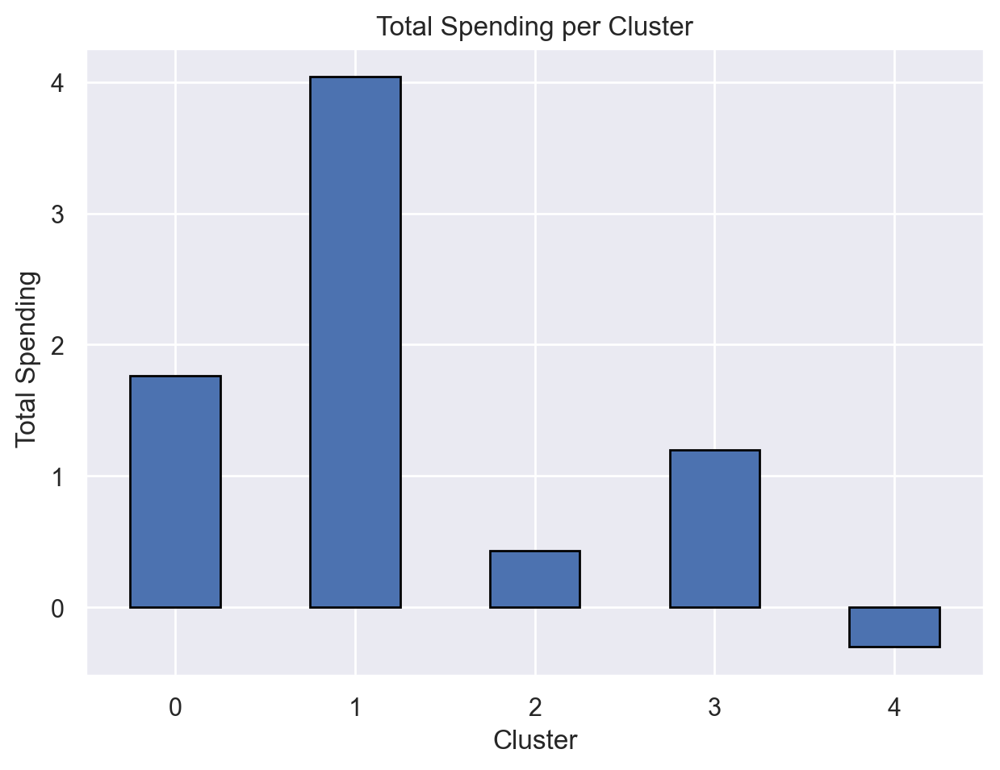

In [269]:
mean_spending = df.groupby('merged_labels')['Total Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Total Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel(' Total Spending')
plt.xticks(rotation=0)
plt.show()

### Average Spending

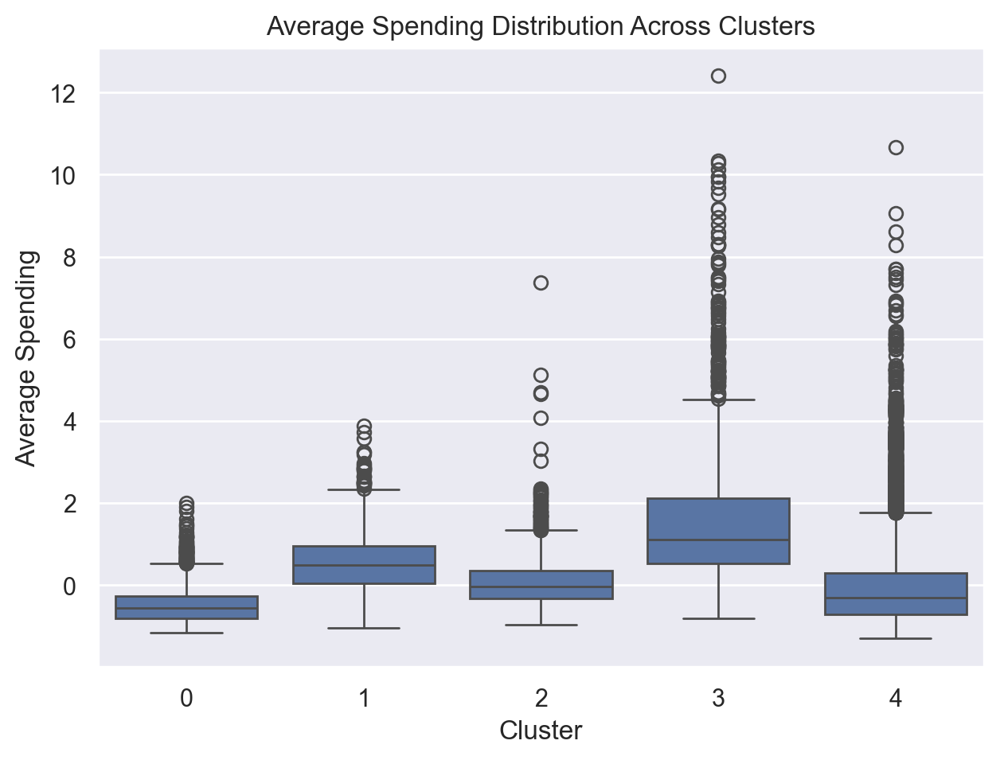

In [270]:
sns.boxplot(data=df, x='merged_labels', y='Average Spending')
plt.title('Average Spending Distribution Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.show()

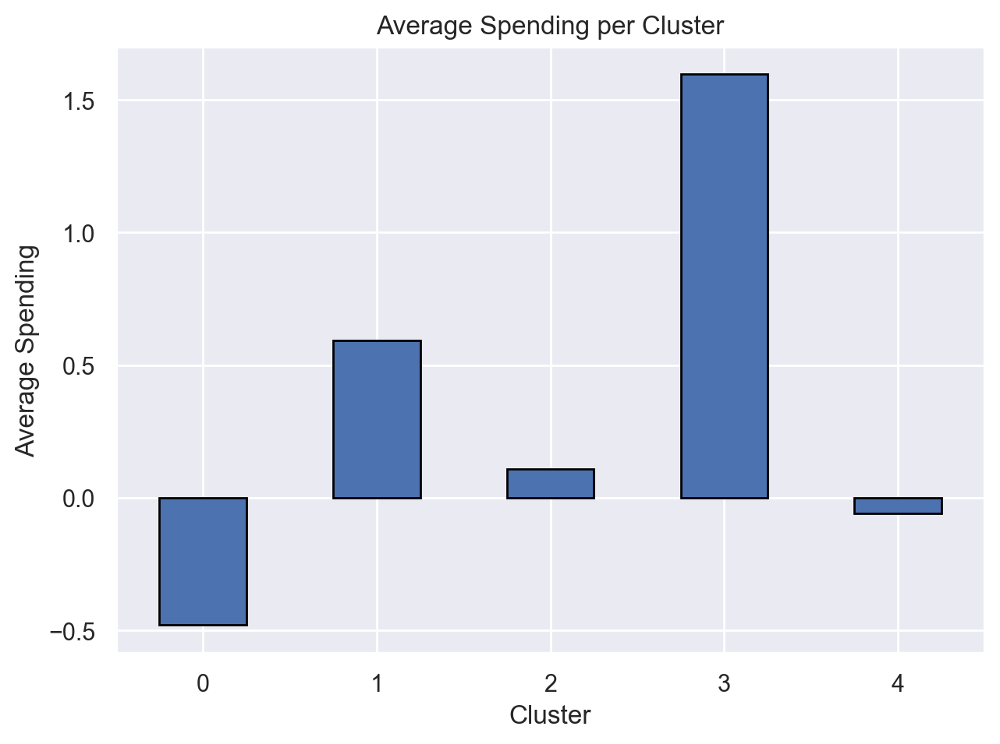

In [271]:
mean_spending = df.groupby('merged_labels')['Average Spending'].mean()

# Plot
mean_spending.plot(kind='bar', edgecolor='black')
plt.title('Average Spending per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Average Spending')
plt.xticks(rotation=0)
plt.show()

### Cuisine Types Analysis

<Figure size 1200x800 with 0 Axes>

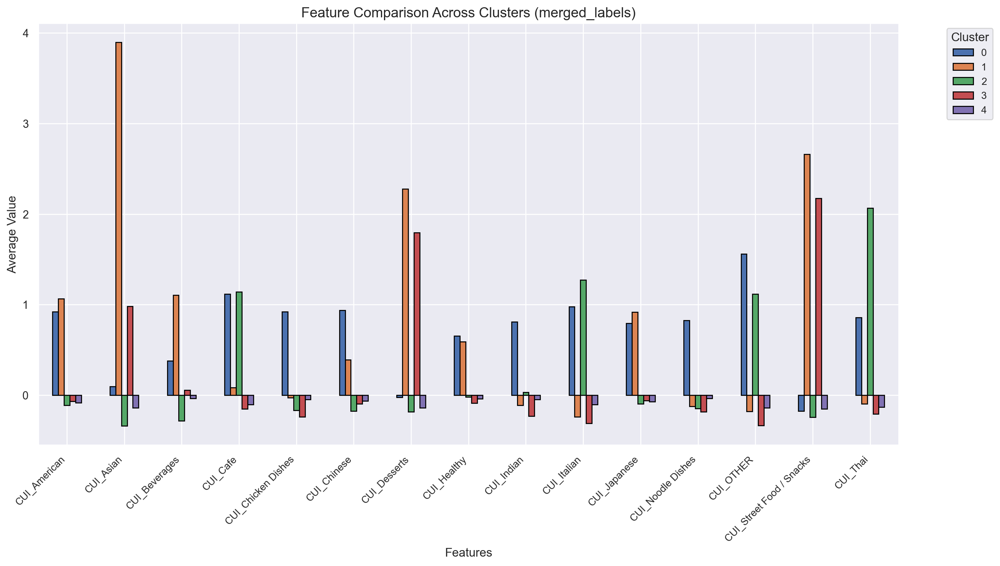

In [272]:
cuisine_columns = [
     'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('merged_labels')[cuisine_columns].mean()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (merged_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

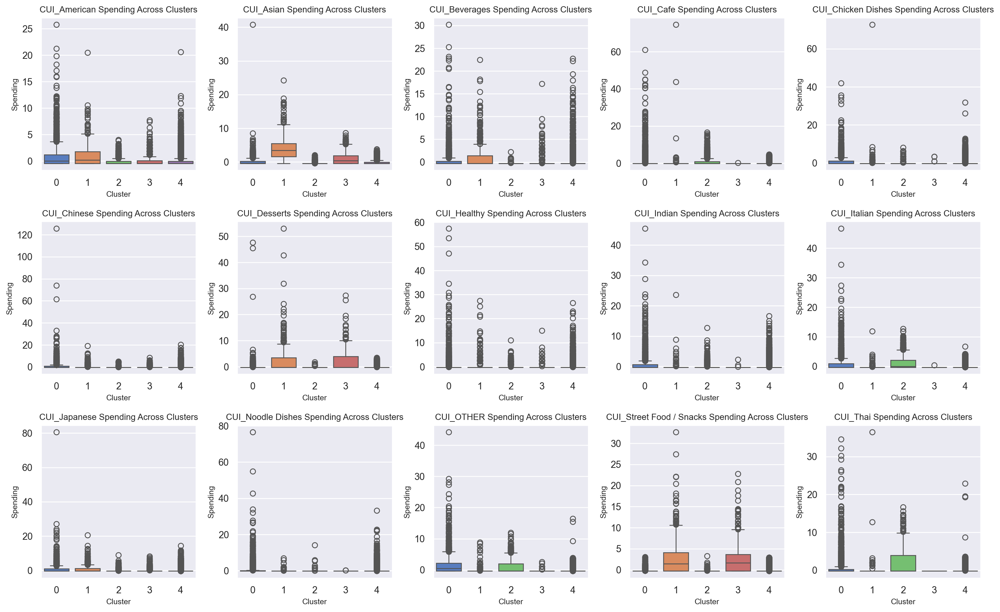

In [273]:
# Set figure size
plt.figure(figsize=(16, 10))

# Create a boxplot for each cuisine
for i, cuisine in enumerate(cuisine_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='merged_labels', y=cuisine, palette='muted', hue='merged_labels', legend=False),
    plt.title(f'{cuisine} Spending Across Clusters', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

### Other Features

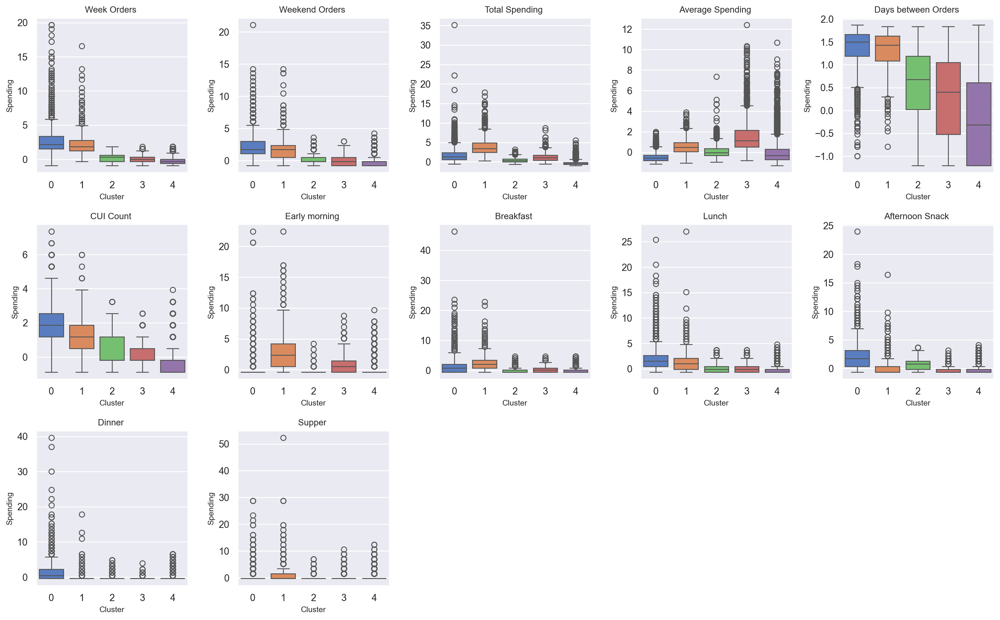

In [274]:
#Define cuisines
other_columns = [
    'Week Orders', 'Weekend Orders', 'Total Spending',
       'Average Spending', 'Days between Orders', 'CUI Count', 'Early morning',
       'Breakfast', 'Lunch', 'Afternoon Snack', 'Dinner', 'Supper',]

#Set figure size
plt.figure(figsize=(16, 10))

#Create a boxplot for each cuisine
for i, cuisine in enumerate(other_columns, 1):
    plt.subplot(3, 5, i)  # Arrange subplots in a grid
    sns.boxplot(data=df, x='merged_labels', y=cuisine, palette='muted', hue='merged_labels', legend=False),
    plt.title(f'{cuisine} ', fontsize=10)  # Adjust font size
    plt.xlabel('Cluster', fontsize=9)
    plt.ylabel('Spending', fontsize=9)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

In [275]:
# Counts for customer_region by cluster
region_counts = df.groupby(['merged_labels', 'customer_region']).size().unstack(0)
print(region_counts)

merged_labels         0      1      2       3       4
customer_region                                      
2360             1091.0   37.0   99.0    57.0  7713.0
2440              160.0    8.0    8.0     3.0  1299.0
2490               51.0    NaN    4.0     NaN   390.0
4140               40.0    2.0   84.0     4.0   726.0
4660              963.0   45.0  910.0     9.0  7651.0
8370                3.0   11.0    NaN    84.0   396.0
8550                1.0    NaN    NaN     1.0    11.0
8670              111.0  560.0    3.0  1424.0  7672.0


### Customer Region Distribution

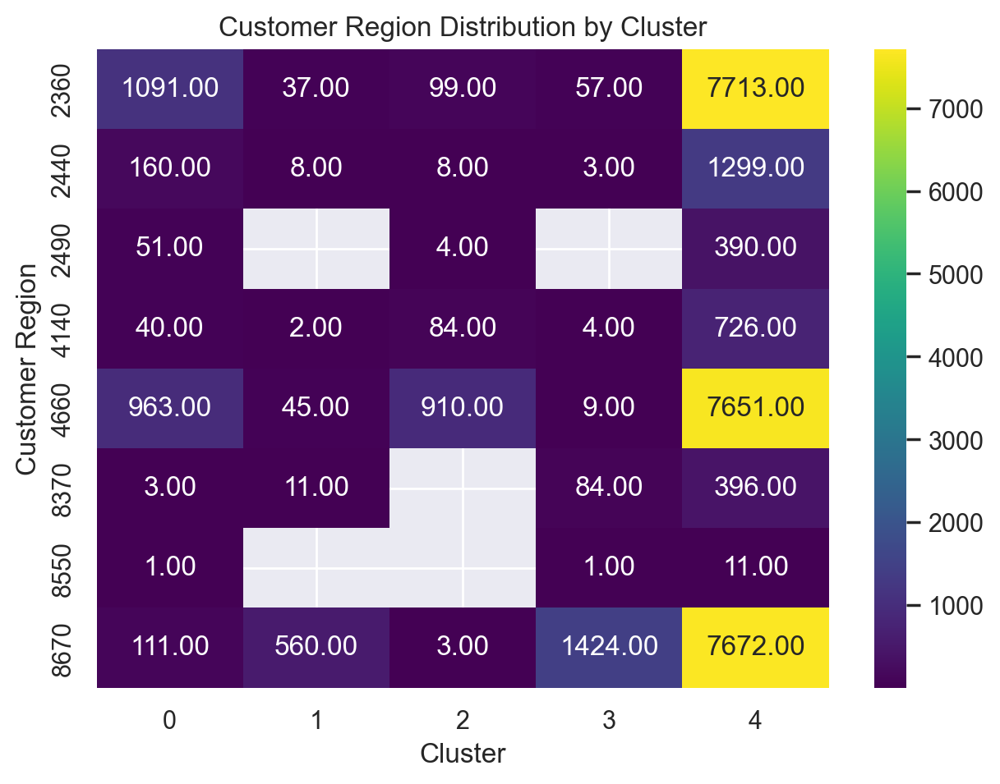

In [276]:
sns.heatmap(region_counts, annot=True, cmap='viridis', fmt='.2f')
plt.title('Customer Region Distribution by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Customer Region')
plt.show()

### Promotion Analysis

<Figure size 1200x800 with 0 Axes>

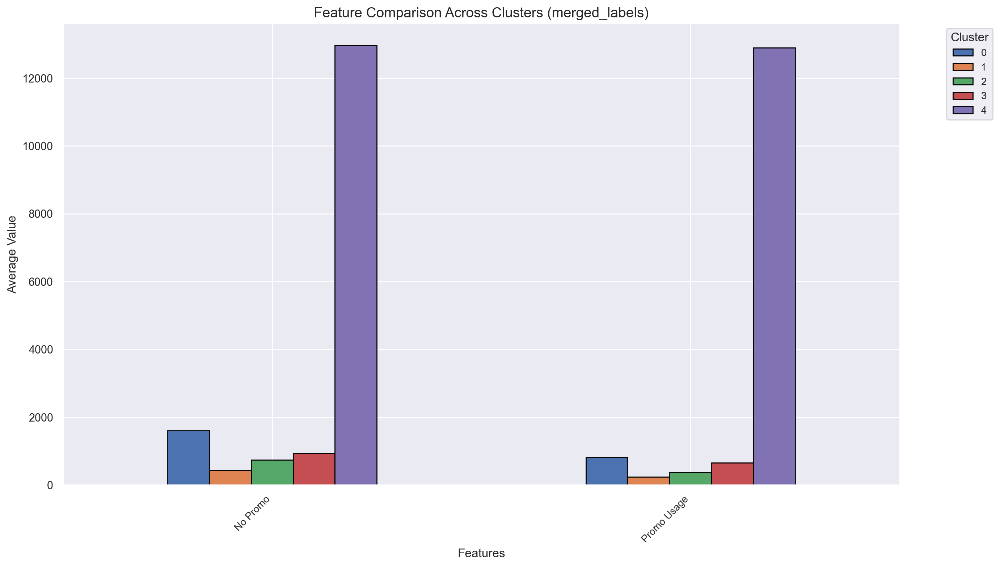

In [277]:
# Combine the promo columns into a single column
df['Promo Usage'] = df['Delivery Promo'] + df['Discount Promo'] + df['Freebie Promo']

# Select only the required columns for the plot
promo_columns_updated = ['No Promo', 'Promo Usage']

# Recalculate the summary for clusters
cluster_summary_updated = df.groupby('merged_labels')[promo_columns_updated].sum()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed_updated = cluster_summary_updated.T

# Plot the updated data
plt.figure(figsize=(12, 8))
cluster_summary_transposed_updated.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (merged_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

<Figure size 1200x800 with 0 Axes>

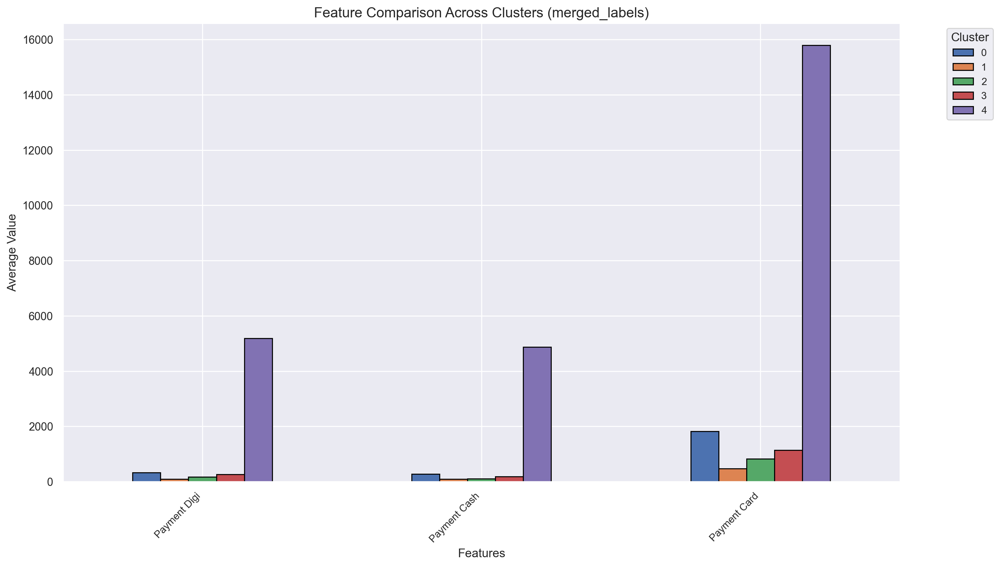

In [278]:
promo_columns = [
    'Payment Digi', 'Payment Cash', 'Payment Card',
]

# Calculate the mean values of these features for each cluster
cluster_summary = df.groupby('merged_labels')[promo_columns].sum()

# Transpose for better plotting (variables as index, clusters as columns)
cluster_summary_transposed = cluster_summary.T

# Plot
plt.figure(figsize=(12, 8))
cluster_summary_transposed.plot(kind='bar', figsize=(14, 8), edgecolor='black')

plt.title('Feature Comparison Across Clusters (merged_labels)', fontsize=14)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Average Value', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

### Cluster Visualization

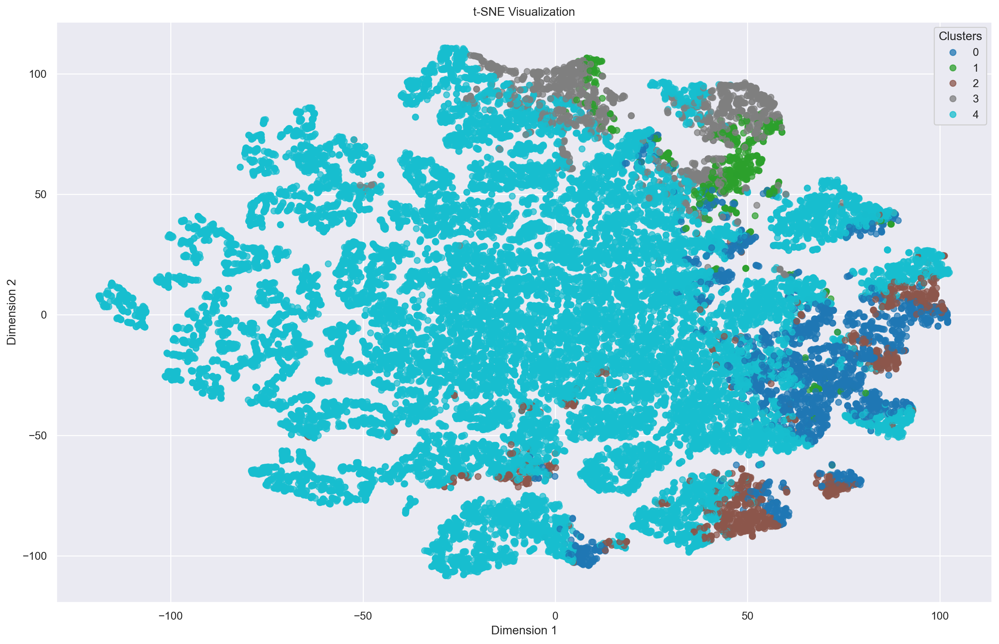

In [ ]:
plot_tsne(df, features, 'merged_labels', figsize=(15, 10), colormap='tab10')